### This notebook trains proteinVI unshared, totalvi shared, and rna unshared on protein_unshared, protein shared, rna shared and rna_unshared

This notebook also train the models in a criss cross manner too.

In [1]:
import numpy as np
import pandas as pd
from scipy.io import mmread
import matplotlib.pyplot as plt
plt.rcParams["figure.figsize"] = (6, 4)
import anndata as ad
import scanpy as sc
import torch
import random

In [2]:
def set_random_seed():
    # Example usage:
    seed = 42
    # Set seed for random module
    random.seed(seed)

    # Set seed for numpy
    np.random.seed(seed)

    # Set seed for torch
    torch.manual_seed(seed)
    if torch.cuda.is_available():
        torch.cuda.manual_seed(seed)
        torch.cuda.manual_seed_all(seed)
        
set_random_seed()

In [3]:
# read in protein data
protein = pd.read_csv("data/citeseq_pbmc/pro.csv") # 10k cells (protein)
# convert to AnnData
protein_adata = ad.AnnData(
    protein.to_numpy(), dtype=np.float32
)
protein_adata.var_names = protein.columns

# read in celltyle labels
metadata = pd.read_csv('data/citeseq_pbmc/meta.csv')
labels_l1 = metadata['celltype.l1'].to_numpy()
labels_l2 = metadata['celltype.l2'].to_numpy()

protein_adata.obs['celltype.l1'] = labels_l1
protein_adata.obs['celltype.l2'] = labels_l2

print("Final stats of protein adata: \n",protein_adata)

Final stats of protein adata: 
 AnnData object with n_obs × n_vars = 10000 × 224
    obs: 'celltype.l1', 'celltype.l2'


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\anndata\_core\anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


In [4]:
# read in RNA data
rna = mmread("./data/citeseq_pbmc/rna.txt") # rna count as sparse matrix, 10k cells (RNA)
rna_names = pd.read_csv('./data/citeseq_pbmc/citeseq_rna_names.csv')['names'].to_numpy()
# convert to AnnData
rna_adata = ad.AnnData(
    rna.tocsr(), dtype=np.float32
)
rna_adata.var_names = rna_names

# read in celltyle labels
metadata = pd.read_csv('./data/citeseq_pbmc/meta.csv')
labels_l1 = metadata['celltype.l1'].to_numpy()
labels_l2 = metadata['celltype.l2'].to_numpy()

rna_adata.obs['celltype.l1'] = labels_l1
rna_adata.obs['celltype.l2'] = labels_l2

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\anndata\_core\anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


In [5]:
rna_protein_correspondence = []
correspondence = pd.read_csv('data/protein_gene_conversion.csv')
for i in range(correspondence.shape[0]):
    curr_protein_name, curr_rna_names = correspondence.iloc[i]
    if curr_protein_name not in protein_adata.var_names:
        continue
    if curr_rna_names.find('Ignore') != -1: # some correspondence ignored eg. protein isoform to one gene
        continue
    curr_rna_names = curr_rna_names.split('/') # eg. one protein to multiple genes
    for r in curr_rna_names:
        if r in rna_adata.var_names:
            rna_protein_correspondence.append([r, curr_protein_name])

rna_protein_correspondence = np.array(rna_protein_correspondence)
print("Number of correspondence matches: ", rna_protein_correspondence.shape)
shared_gene_names_repeated = rna_protein_correspondence.T[0]
shared_protein_names_repeated = rna_protein_correspondence.T[1]
print("Unique shared gene names: {}, Unique shared protein names: {}".format(len(np.unique(shared_gene_names_repeated)), len(np.unique(shared_protein_names_repeated))))

Number of correspondence matches:  (180, 2)
Unique shared gene names: 170, Unique shared protein names: 170


In [6]:
shared_gene_features = list(set(shared_gene_names_repeated))
print("Final shared RNA: ",len(shared_gene_features))
shared_protein_features = list(set(shared_protein_names_repeated))
print("Final share protein: ", len(shared_protein_features))

rna_adata_copy = rna_adata.copy()
sc.pp.normalize_total(rna_adata_copy)
sc.pp.log1p(rna_adata_copy)
sc.pp.highly_variable_genes(rna_adata_copy, n_top_genes=2000)

highly_var_genes = list(set(rna_adata.var_names[rna_adata_copy.var.highly_variable==True]))
highly_var_genes_filtered = [gene for gene in highly_var_genes if gene not in shared_gene_features]

unshared_protein_features = [protein for protein in protein_adata.var_names if protein not in shared_protein_features]
print("Unshared protein features: ", len(unshared_protein_features))
print("variable genes that are not shared: ", len(highly_var_genes_filtered))

Final shared RNA:  170
Final share protein:  170
Unshared protein features:  54
variable genes that are not shared:  1911


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\preprocessing\_highly_variable_genes.py:220: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  disp_grouped = df.groupby('mean_bin')['dispersions']


In [7]:
def get_indices(feature_names, all_feature_names):
    """Returns the indices of features in 'feature_names' within the 'all_feature_names' list.

    Args:
        feature_names: A list of feature names to find indices for.
        all_feature_names: The complete list of all feature names.

    Returns:
        A list of indices corresponding to the positions of the 'feature_names' 
        within the 'all_feature_names' list. If a feature is not found, its index
        will be -1.
    """
    indices = []
    for feature in feature_names:
        try:
            index = all_feature_names.index(feature)
        except ValueError:
            index = -1  # Feature not found
        indices.append(index)
    return indices

In [8]:
unshared_gene_indices = get_indices(highly_var_genes_filtered, rna_adata.var_names.to_list())
shared_gene_indices = get_indices(shared_gene_names_repeated, rna_adata.var_names.to_list())
unshared_protein_indices = get_indices(unshared_protein_features, protein_adata.var_names.to_list())
shared_protein_indices = get_indices(shared_protein_names_repeated, protein_adata.var_names.to_list())

print("Length of unshared_gene_indices:", len(unshared_gene_indices))
print("Length of shared_gene_indices:", len(shared_gene_indices))
print("Length of unshared_protein_indices:", len(unshared_protein_indices))
print("Length of shared_protein_indices:", len(shared_protein_indices))

# Convert index lists to sets for unique element calculation
unshared_gene_unique = set(unshared_gene_indices)
shared_gene_unique = set(shared_gene_indices)
unshared_protein_unique = set(unshared_protein_indices)
shared_protein_unique = set(shared_protein_indices)

# Print lengths of unique elements
print("Unique elements in unshared_gene_indices:", len(unshared_gene_unique))
print("Unique elements in shared_gene_indices:", len(shared_gene_unique))
print("Unique elements in unshared_protein_indices:", len(unshared_protein_unique))
print("Unique elements in shared_protein_indices:", len(shared_protein_unique))

Length of unshared_gene_indices: 1911
Length of shared_gene_indices: 180
Length of unshared_protein_indices: 54
Length of shared_protein_indices: 180
Unique elements in unshared_gene_indices: 1911
Unique elements in shared_gene_indices: 170
Unique elements in unshared_protein_indices: 54
Unique elements in shared_protein_indices: 170


In [9]:
rna_unshared_adata = rna_adata[:,unshared_gene_indices]
rna_shared_adata = rna_adata[:,shared_gene_indices]
protein_unshared_adata = protein_adata[:,unshared_protein_indices]
protein_shared_adata = protein_adata[:,shared_protein_indices]

In [10]:
from torch.utils.data import Dataset, DataLoader
from tqdm import tqdm

class ProteinDataset(Dataset):
    def __init__(self,unshared_protein_adata, shared_protein_adata):
        self.unshared_data = np.asarray(unshared_protein_adata.X)
        self.shared_data = np.asarray(shared_protein_adata.X)
        self.labels_l1 = protein_adata.obs['celltype.l1']
        self.labels_l2 = protein_adata.obs['celltype.l2']
        self.batch = np.array([1.0]*self.unshared_data.shape[0]).reshape((-1,1)).astype(np.float32)
        
    def __len__(self):
        return self.unshared_data.shape[0]

    def __getitem__(self, idx):
        return {"y_unshared":self.unshared_data[idx], "y_shared":self.shared_data[idx], "l1":self.labels_l1[idx], "l2":self.labels_l2[idx], "batch": self.batch[idx]}

protein_dataset = ProteinDataset(protein_unshared_adata, protein_shared_adata)
protein_dataloader = DataLoader(protein_dataset, batch_size=256, shuffle=True)

In [11]:
class RNADataset(Dataset):
    def __init__(self,unshared_rna_adata, shared_rna_adata):
        self.unshared_data = np.asarray(unshared_rna_adata.X.todense())
        self.shared_data = np.asarray(shared_rna_adata.X.todense())
        self.labels_l1 = rna_adata.obs['celltype.l1']
        self.labels_l2 = rna_adata.obs['celltype.l2']
        self.local_mean, self.local_var = self.compute_library_size(np.concatenate([self.unshared_data, self.shared_data],axis=1))
        self.local_mean = np.array([self.local_mean]*self.unshared_data.shape[0])
        self.local_var = np.array([self.local_var]*self.unshared_data.shape[0])
        self.batch = np.array([0.0]*self.unshared_data.shape[0]).reshape((-1,1)).astype(np.float32)
        
    def __len__(self):
        return self.unshared_data.shape[0]

    def __getitem__(self, idx):
        return {"x_unshared":self.unshared_data[idx], "x_shared":self.shared_data[idx], "l1":self.labels_l1[idx], "l2":self.labels_l2[idx], "mean": self.local_mean[idx], "var": self.local_var[idx], "batch": self.batch[idx]}
    
    def compute_library_size(self, data):
        # print(data.shape)
        sum_counts = data.sum(axis=1)
        masked_log_sum = np.ma.log(sum_counts)
        if np.ma.is_masked(masked_log_sum):
            print(
                "Warning: This dataset has some empty cells, this might fail scVI inference. Data should be filtered with `my_dataset.filter_cells_by_count()"
            )
        log_counts = masked_log_sum.filled(0)
        local_mean = (np.mean(log_counts).reshape(-1, 1)).astype(np.float32)
        local_var = (np.var(log_counts).reshape(-1, 1)).astype(np.float32)

        local_mean = torch.Tensor(local_mean).reshape(-1)
        local_var = torch.Tensor(local_var).reshape(-1)
        return local_mean, local_var

rna_dataset = RNADataset(rna_unshared_adata, rna_shared_adata)
rna_dataloader = DataLoader(rna_dataset, batch_size=256, shuffle=True)

In [12]:
def l2_normalize_batch_pytorch(batch):
    norm = torch.norm(batch, dim=1, keepdim=True)
    normalized_batch = batch / norm
    return normalized_batch
    
def cross_entropy(preds, targets, reduction='none'):
    log_softmax = nn.LogSoftmax(dim=-1)
    loss = (-targets * log_softmax(preds)).sum(1)
    if reduction == "none":
        return loss
    elif reduction == "mean":
        return loss.mean()

def CLIP_loss(rna_total,rna_unshared):
    
    text_embeddings = l2_normalize_batch_pytorch(rna_total)
    image_embeddings = l2_normalize_batch_pytorch(rna_unshared)
    temperature = 1.0
    logits = (text_embeddings @ image_embeddings.T) 
    images_similarity = image_embeddings @ image_embeddings.T
    texts_similarity = text_embeddings @ text_embeddings.T
    targets = F.softmax(
        (images_similarity + texts_similarity) / 2, dim=-1
    )
    texts_loss = cross_entropy(logits, targets, reduction='none')
    images_loss = cross_entropy(logits.T, targets.T, reduction='none')
    loss =  (images_loss + texts_loss) / 2.0 
    return loss.mean()

In [13]:
Unshared_protein_loss = []
Unshared_rna_loss = []
Shared_loss = []
loss_emb_p = []
loss_emb_r = []

final_unshared_protein_loss = 0.0
final_unshared_rna_loss = 0.0
final_shared_loss = 0.0
final_loss_emb_p = 0.0
final_loss_emb_r = 0.0

In [14]:
def get_paras_for_podel(para_out_prodel, gene_size):
    para = {}
    para["qz_m"] = para_out_prodel["qz_m"][gene_size:]
    para["qz_v"] = para_out_prodel["qz_v"][gene_size:]
    para["z_protein"] = para_out_prodel["z_protein"]
    para["untran_z"] = para_out_prodel["untran_z"][gene_size:]
    return para

def get_paras_for_rodel(para_out_prodel, gene_size):
    para = {}
    para["qz_m"] = para_out_prodel["qz_m"][:gene_size]
    para["qz_v"] = para_out_prodel["qz_v"][:gene_size]
    para["z_gene"] = para_out_prodel["z_gene"]
    para["ql_m"] = para_out_prodel["ql_m"][:gene_size]
    para["ql_v"] = para_out_prodel["ql_v"][:gene_size]
    para["l"] = para_out_prodel["l"][:gene_size]
    return para

def get_paras_for_prodel(para_out_rodel, para_out_podel, gene_size):
    para = {}
    para["qz_m"] = torch.cat([para_out_rodel["qz_m"], para_out_podel["qz_m"]], dim=0)
    para["qz_v"] = torch.cat([para_out_rodel["qz_v"], para_out_podel["qz_v"]], dim=0)    
    para["ql_m"] = torch.cat([para_out_rodel["ql_m"], torch.zeros_like(para_out_rodel["ql_m"])], dim=0)
    para["ql_v"] = torch.cat([para_out_rodel["ql_v"], torch.zeros_like(para_out_rodel["ql_v"])], dim=0)
    para["z_gene"] = para_out_rodel["z_gene"]
    para["z_protein"] = para_out_podel["z_protein"]
    para["l"] = torch.cat([para_out_rodel["l"], torch.zeros_like(para_out_rodel["l"])], dim=0)
    para["untran_z"] = torch.cat([torch.zeros_like(para_out_podel["untran_z"]), para_out_podel["untran_z"]], dim=0)
    para["untran_l"] = torch.cat([para_out_rodel["l"], torch.zeros_like(para_out_rodel["l"])], dim=0)
    return para

In [15]:
import torch.nn as nn

class Discriminator(nn.Module):
    def __init__(self, input_dim):
        super(Discriminator, self).__init__()
        self.network = nn.Sequential(
            nn.Linear(input_dim, 64),
            nn.ReLU(),
            nn.Linear(64, 32),
            nn.ReLU(),
            nn.Linear(32, 16),
            nn.ReLU(),
            nn.Linear(16, 1),
            nn.Sigmoid()
        )

    def forward(self, x):
        return self.network(x)

In [16]:
from scvi.models.proteinvi_unshared_cross import PROTENVI_UNSHARED_CROSS
from scvi.models.rna_unshared_cross import RNA_UNSHARED_CROSS
from scvi.models.totalvi_shared_cross import TOTALVI_SHARED_CROSS
import torch.nn.functional as F
import torch.nn as nn
import metrics.match_utils as mu
from torch.optim.lr_scheduler import StepLR

podel = PROTENVI_UNSHARED_CROSS(234, latent_distribution="normal", log_variational=True)
prodel = TOTALVI_SHARED_CROSS(180, latent_distribution="normal", log_variational=True, reconstruction_loss_gene = "zinb")
rodel = RNA_UNSHARED_CROSS(2091, latent_distribution="normal", log_variational=True, reconstruction_loss="zinb")
discriminator = Discriminator(20)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("The device used for training is: ", device)
podel.to(device)
prodel.to(device)
rodel.to(device)
prodel_params = filter(lambda p: p.requires_grad, prodel.parameters())
podel_params = filter(lambda p: p.requires_grad, podel.parameters())
rodel_params = filter(lambda p: p.requires_grad, rodel.parameters())

optimizer_p = torch.optim.Adam(podel_params, lr=0.001, eps=0.01)
optimizer_r = torch.optim.Adam(rodel_params, lr=0.001, eps=0.01)
optimizer_pr = torch.optim.Adam(prodel_params, lr=0.001, eps=0.01)
optimizer_d = torch.optim.Adam(discriminator.parameters(), lr=0.001, eps=0.01)

scheduler_p = StepLR(optimizer_p, step_size=300, gamma=0.5)
scheduler_pr = StepLR(optimizer_pr, step_size=300, gamma=0.5)
scheduler_r = StepLR(optimizer_r, step_size=300, gamma=0.5)
scheduler_d = StepLR(optimizer_d, step_size=300, gamma=0.5)

criterion = nn.BCEWithLogitsLoss()

The device used for training is:  cpu


In [17]:
# import warnings

# # Ignore FutureWarnings
# warnings.simplefilter(action='ignore', category=FutureWarning)

# # train rodel and podel separately for 400 iterations:
# kl_weight = 0.0
# p_recon = []
# r_recon = []
# p_kl_z = []
# r_kl_z = []
# for epoch in range(400):
#     p_recon_per_iter = []
#     r_recon_per_iter = []
#     p_kl_z_per_iter = []
#     r_kl_z_per_iter = []
#     for batchr, batchp in zip(rna_dataloader, protein_dataloader):
#         optimizer_p.zero_grad()
#         optimizer_r.zero_grad()
        
#         y_unshared = torch.cat([batchp["y_unshared"],batchp["y_shared"]], dim=1).to(device)
#         x_unshared = torch.cat([batchr["x_unshared"],batchr["x_shared"]], dim=1).to(device)
#         local_mean = batchr["mean"].to(device)
#         local_var = batchr["var"].to(device)
        
#         pro_recon_loss, pro_kl_div_z, pro_kl_div_back_pro, z_pro, _ = podel(y_unshared,cross_inf = False)
#         rna_recon_loss, rna_kl_div_l, rna_kl_div_z, z_rna, _ = rodel(x_unshared, local_mean, local_var, cross_inf = False)
#         unshared_protein_loss = torch.mean(pro_recon_loss) + kl_weight*torch.mean(pro_kl_div_z) + kl_weight*torch.mean(pro_kl_div_back_pro)
#         unshared_rna_loss = torch.mean(rna_recon_loss) + kl_weight*torch.mean(rna_kl_div_l) + kl_weight*torch.mean(rna_kl_div_z)
        
#         unshared_rna_loss.backward()
#         optimizer_r.step()
#         unshared_protein_loss.backward()
#         optimizer_p.step()
        
#         p_recon_per_iter.append(torch.mean(pro_recon_loss).item())
#         r_recon_per_iter.append(torch.mean(rna_recon_loss).item())
#         p_kl_z_per_iter.append(torch.mean(pro_kl_div_z).item())
#         r_kl_z_per_iter.append(torch.mean(rna_kl_div_z).item())
        
#     if epoch%10 == 0:
#         p_recon.append(np.mean(p_recon_per_iter))
#         r_recon.append(np.mean(r_recon_per_iter))
#         p_kl_z.append(np.mean(p_kl_z_per_iter))
#         r_kl_z.append(np.mean(r_kl_z_per_iter))
#         print(f"Epoch: {epoch}  Losses: {p_recon[-1]}-------------{r_recon[-1]}------------{p_kl_z[-1]}------------{r_kl_z[-1]}")
    
#     kl_weight = min(1.0,(epoch+1)/400)  
    
#     if epoch%100 == 0:
#          with torch.no_grad():
#             unshared_pro_data = torch.Tensor(protein_dataset.unshared_data)
#             shared_pro_data = torch.Tensor(protein_dataset.shared_data)
#             unshared_rna_data = torch.Tensor(rna_dataset.unshared_data)
#             shared_rna_data = torch.Tensor(rna_dataset.shared_data)
#             labelsl1 = rna_dataset.labels_l1
#             labelsl2 = rna_dataset.labels_l2
#             shared_tensor_mean = torch.Tensor(rna_dataset.local_mean).to(device)
#             shared_tensor_var = torch.Tensor(rna_dataset.local_var).to(device)
#             _, _, _, z_pro_un, _ = podel(torch.cat([unshared_pro_data, shared_pro_data], dim=1) , cross_inf=False)
#             _, _, _, z_gene_un, _ = rodel(torch.cat([unshared_rna_data, shared_rna_data], dim=1),shared_tensor_mean,shared_tensor_var, cross_inf=False)         
            
#             print("Plots of RNA")
#             adata_plot = ad.AnnData(X= z_gene_un.numpy())
#             adata_plot.obs['celltype.l1'] = labelsl1
#             adata_plot.obs['celltype.l2'] = labelsl2
#             sc.pp.neighbors(adata_plot)
#             sc.tl.umap(adata_plot)
#             sc.pl.umap(adata_plot, color='celltype.l1', legend_loc='on data', s=2)            
#             sc.pl.umap(adata_plot, color='celltype.l2', legend_loc='on data', s=2)
            
#             print("Plots of Protein")
#             adata_plot = ad.AnnData(X= z_pro_un.numpy())
#             adata_plot.obs['celltype.l1'] = labelsl1
#             adata_plot.obs['celltype.l2'] = labelsl2
#             sc.pp.neighbors(adata_plot)
#             sc.tl.umap(adata_plot)
#             sc.pl.umap(adata_plot, color='celltype.l1', legend_loc='on data', s=2)            
#             sc.pl.umap(adata_plot, color='celltype.l2', legend_loc='on data', s=2)

In [18]:
# # Save models' state dictionaries
# torch.save(rodel.state_dict(), 'rodel.pth')
# torch.save(podel.state_dict(), 'podel.pth')

In [19]:
rodel.load_state_dict(torch.load('rodel.pth'))
podel.load_state_dict(torch.load('podel.pth'))

<All keys matched successfully>

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\torch\optim\lr_scheduler.py:136: UserWarning: Detected call of `lr_scheduler.step()` before `optimizer.step()`. In PyTorch 1.1.0 and later, you should call them in the opposite order: `optimizer.step()` before `lr_scheduler.step()`.  Failure to do this will result in PyTorch skipping the first value of the learning rate schedule. See more details at https://pytorch.org/docs/stable/optim.html#how-to-adjust-learning-rate
  warnings.warn("Detected call of `lr_scheduler.step()` before `optimizer.step()`. "


Epoch: 0
Last discriminator loss 1: List is empty
Last discriminator loss 2: List is empty
Last RNA reconstruction loss: List is empty
Last RNA KL divergence L: List is empty
Last RNA KL divergence Z: List is empty
Last protein reconstruction loss: List is empty
Last protein KL divergence back pro: List is empty
Last protein KL divergence Z: List is empty
Last total loss: List is empty
Plots using shared model


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


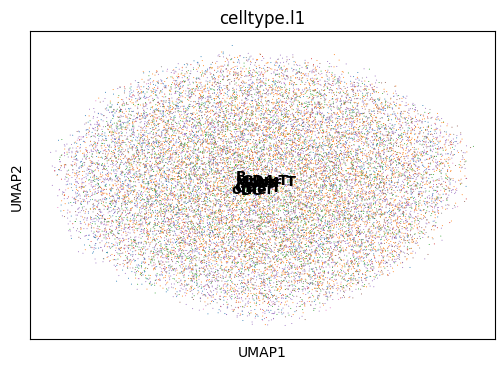

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


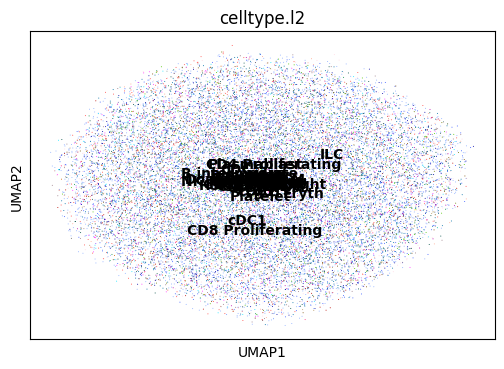

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


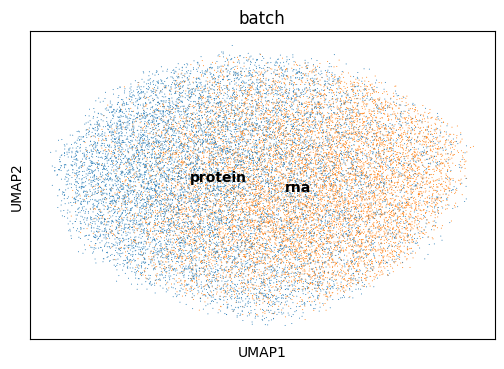

Plots for only rna


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


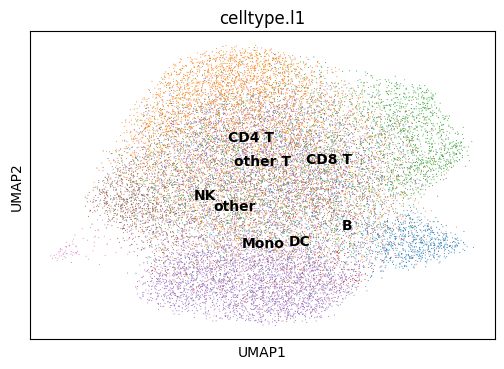

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


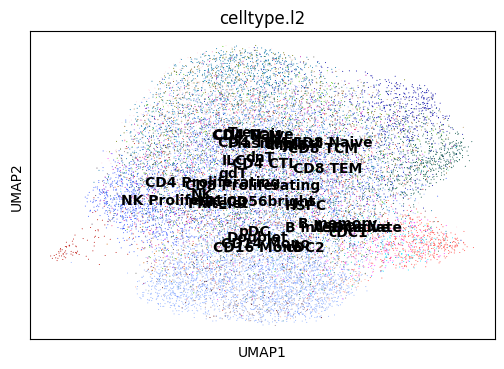

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


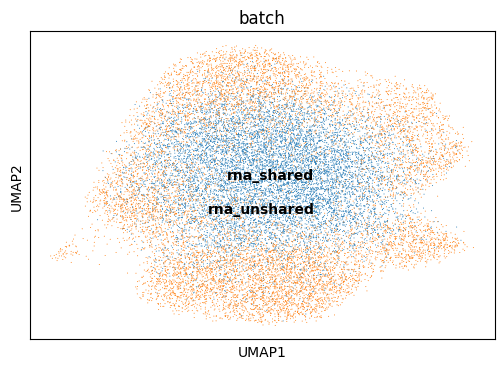

Plots for only proteins


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


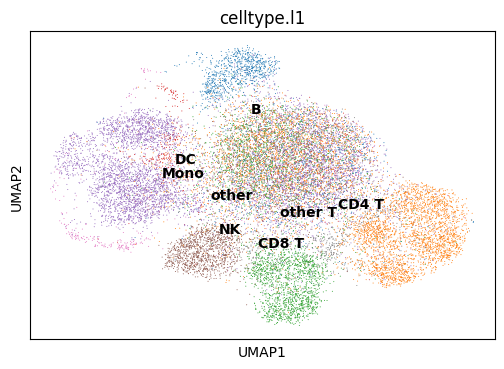

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


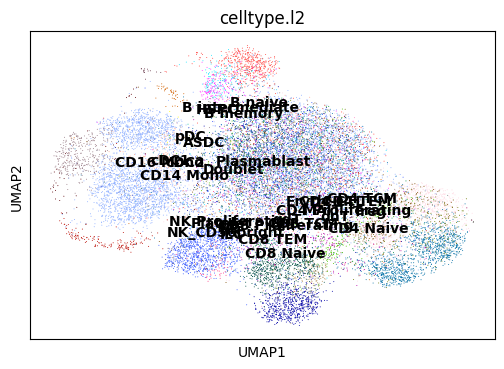

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


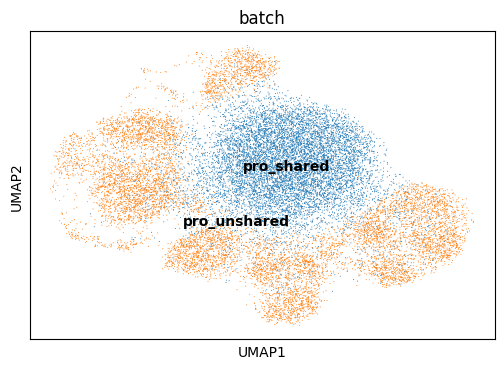

euclidean metric will be used for calculating the distance!
Start the matching process...
Computing the distance matrix...
Getting matchings by Minimum Distance...
Linear assignment completed!
For All matchings: lv1 matching acc: 0.206,
lv2 matching acc: 0.112.
For All matchings: FOSCTTM score: 0.49486857, 
Knn Alignment score: [0.0001 0.0001 0.0003 0.0003 0.0004 0.0005 0.0007 0.0008 0.001  0.001
 0.0011 0.0013 0.0013 0.0014 0.0014 0.0017 0.0018 0.002  0.002  0.0021
 0.0023 0.0023 0.0023 0.0023 0.0024]
For All matchings: Silhouette F1 score for lv1: 0.49309882620440526, 
Silhouette F1 score for lv2: 0.4812865225447909



Matches are being filtered...
Matchings before filtering:  10000
Threshold distance for filtering the matchings:  3.4731268882751465
Matchings are reduced to 5000 after filtering...
For only filtered matchings: lv1 matching acc: 0.213,
lv2 matching acc: 0.119.



Matches are being propagated....
Done!
For all matchings after propagation: lv1 matching acc: 0.208,
lv2 ma

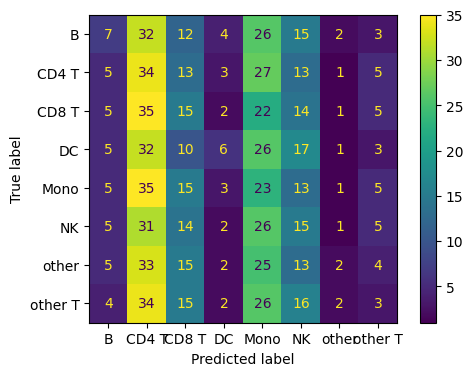

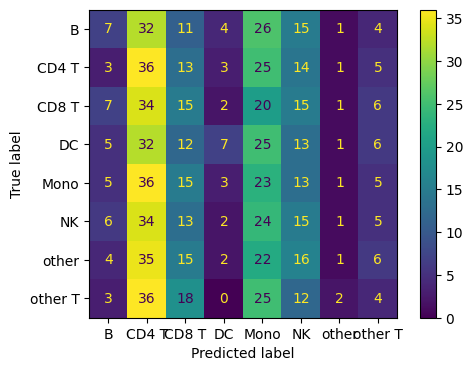

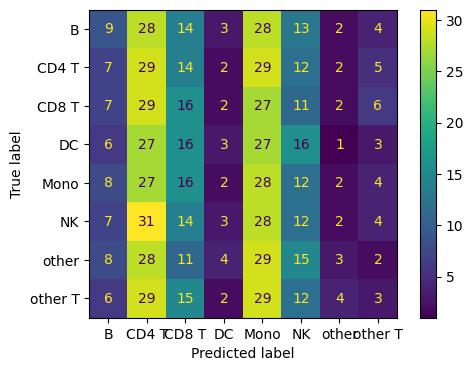

Epoch: 10
Last discriminator loss 1: List is empty
Last discriminator loss 2: List is empty
Last RNA reconstruction loss: List is empty
Last RNA KL divergence L: List is empty
Last RNA KL divergence Z: List is empty
Last protein reconstruction loss: List is empty
Last protein KL divergence back pro: List is empty
Last protein KL divergence Z: List is empty
Last total loss: List is empty
Epoch: 20
Last discriminator loss 1: 0.5739794105291367
Last discriminator loss 2: 0.6732236549258233
Last RNA reconstruction loss: 86.61515922546387
Last RNA KL divergence L: 23.35994510650635
Last RNA KL divergence Z: 99.02026748657227
Last protein reconstruction loss: 509.6554656982422
Last protein KL divergence back pro: 1792.528387451172
Last protein KL divergence Z: 99.02026748657227
Last total loss: 598.858757019043
Epoch: 30
Last discriminator loss 1: 0.5100788980722427
Last discriminator loss 2: 0.6910100415349006
Last RNA reconstruction loss: 81.56081771850586
Last RNA KL divergence L: 25.7964

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


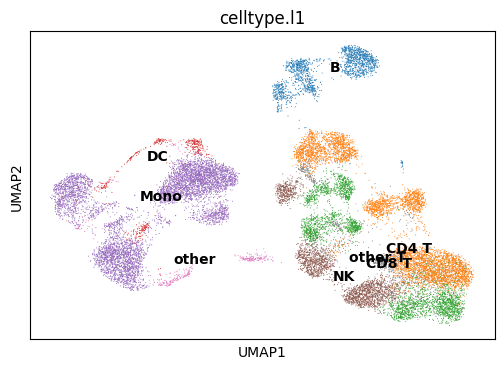

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


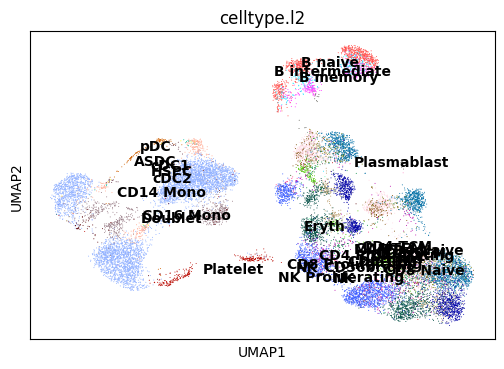

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


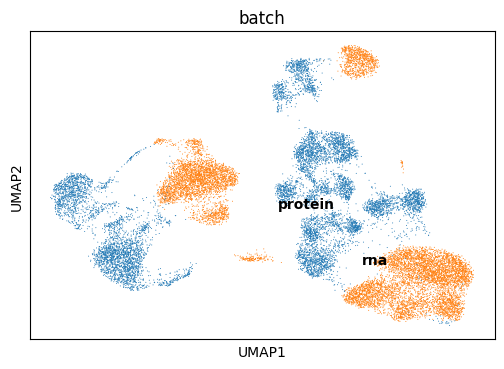

Plots for only rna


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


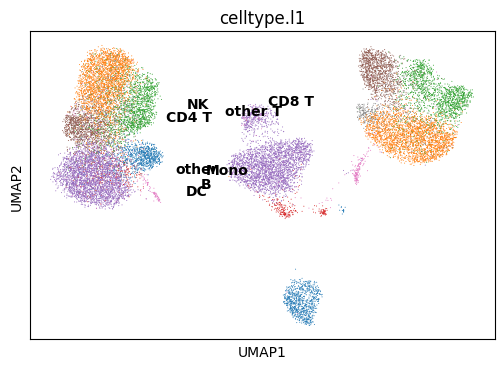

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


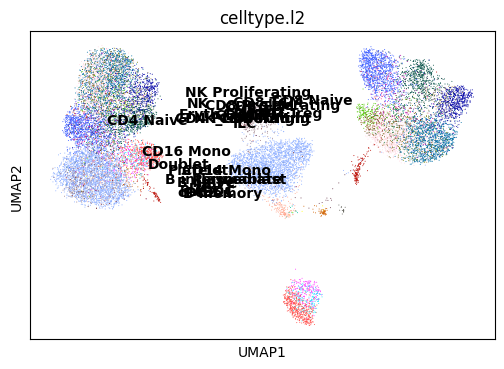

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


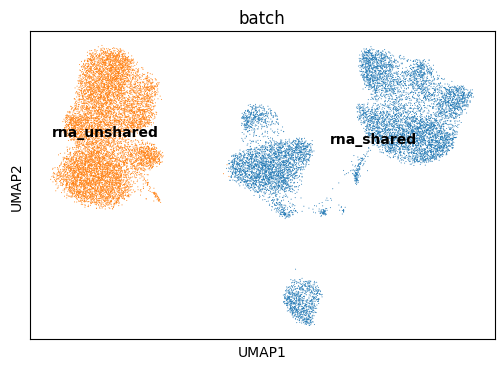

Plots for only proteins


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


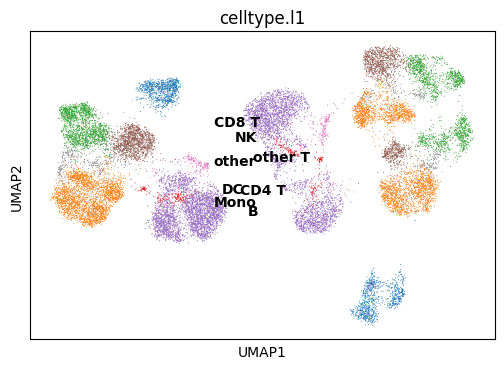

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


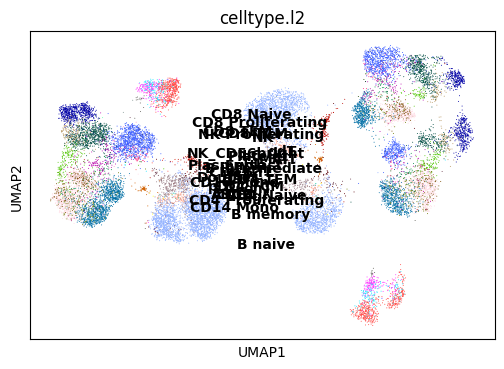

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


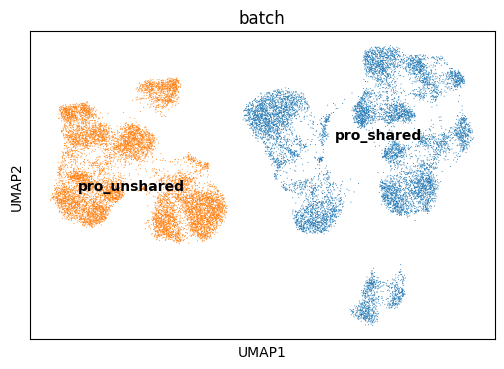

euclidean metric will be used for calculating the distance!
Start the matching process...
Computing the distance matrix...
Getting matchings by Minimum Distance...
Linear assignment completed!
For All matchings: lv1 matching acc: 0.642,
lv2 matching acc: 0.494.
For All matchings: FOSCTTM score: 0.31929153, 
Knn Alignment score: [0.0008 0.0021 0.003  0.004  0.0044 0.0054 0.0063 0.0069 0.0075 0.0084
 0.0092 0.0096 0.0105 0.0108 0.0113 0.0118 0.0127 0.0131 0.0134 0.0141
 0.0151 0.0163 0.0173 0.0177 0.0187]
For All matchings: Silhouette F1 score for lv1: 0.4460303032207522, 
Silhouette F1 score for lv2: 0.4363792888176702



Matches are being filtered...
Matchings before filtering:  10000
Threshold distance for filtering the matchings:  6.099445581436157
Matchings are reduced to 5000 after filtering...
For only filtered matchings: lv1 matching acc: 0.701,
lv2 matching acc: 0.561.



Matches are being propagated....


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scipy\sparse\_index.py:143: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


Done!
For all matchings after propagation: lv1 matching acc: 0.750,
lv2 matching acc: 0.566.


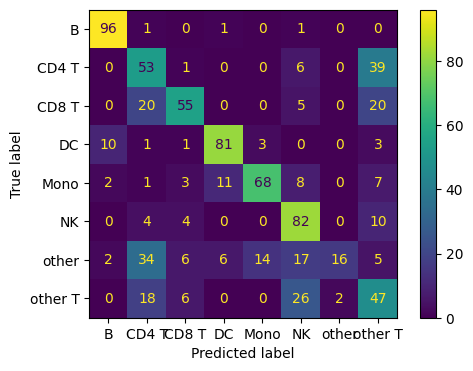

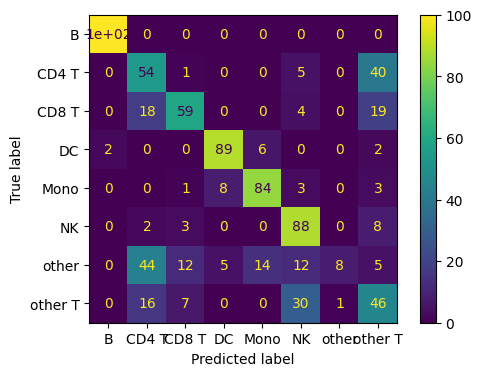

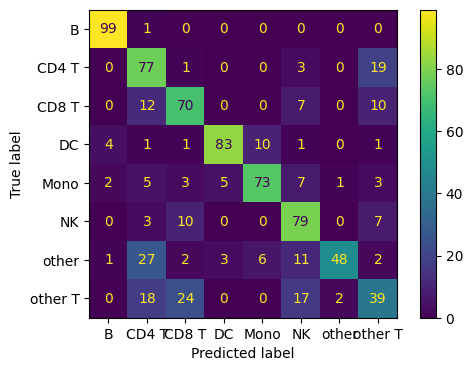

Epoch: 110
Last discriminator loss 1: 0.5037493631243706
Last discriminator loss 2: 0.692838816344738
Last RNA reconstruction loss: 69.10310897827148
Last RNA KL divergence L: 28.005525827407837
Last RNA KL divergence Z: 164.18910865783693
Last protein reconstruction loss: 465.19370422363284
Last protein KL divergence back pro: 819.8215988159179
Last protein KL divergence Z: 164.18910865783693
Last total loss: 536.0016693115234
Epoch: 120
Last discriminator loss 1: 0.5037104249000549
Last discriminator loss 2: 0.6928255841135978
Last RNA reconstruction loss: 68.55346622467042
Last RNA KL divergence L: 28.112685203552246
Last RNA KL divergence Z: 162.94549865722655
Last protein reconstruction loss: 463.546834564209
Last protein KL divergence back pro: 808.9672653198243
Last protein KL divergence Z: 162.94549865722655
Last total loss: 533.7931579589844
Epoch: 130
Last discriminator loss 1: 0.5037268951535225
Last discriminator loss 2: 0.6927521884441376
Last RNA reconstruction loss: 68.4

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


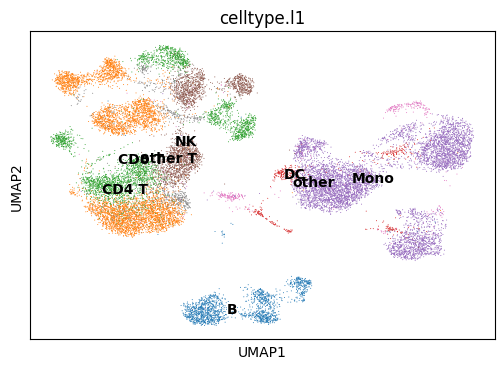

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


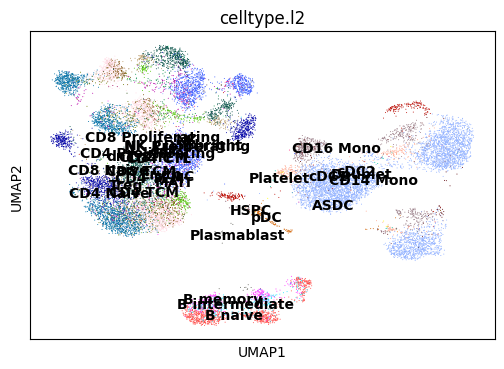

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


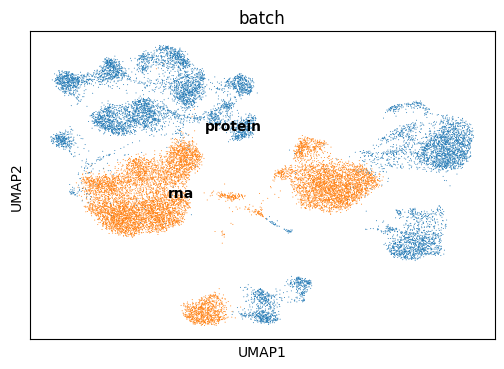

Plots for only rna


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


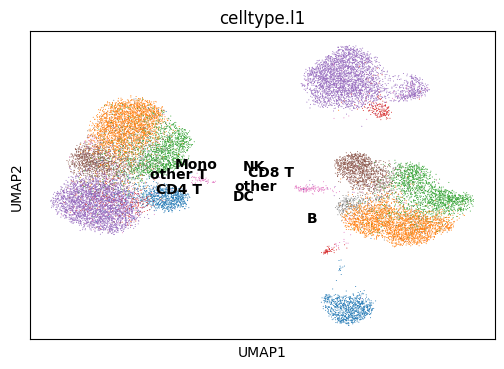

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


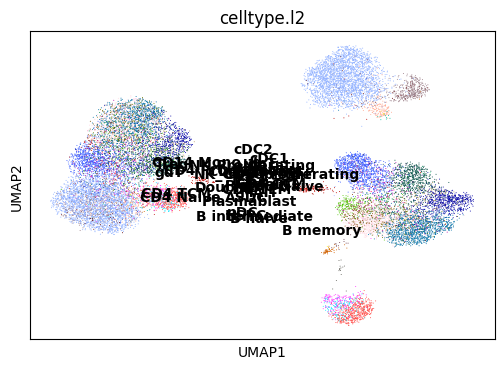

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


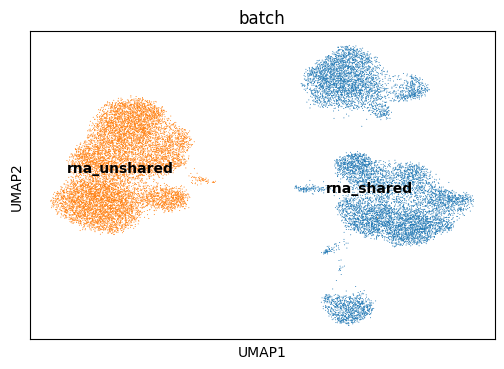

Plots for only proteins


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


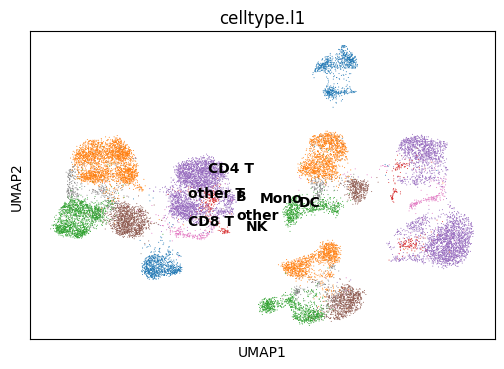

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


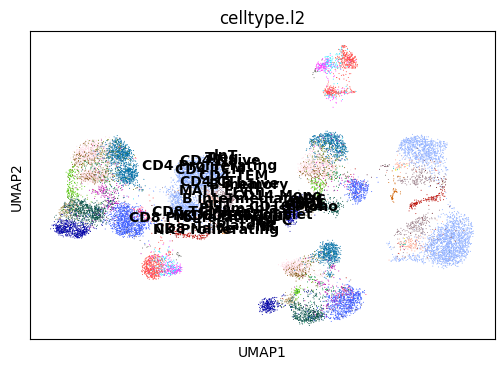

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


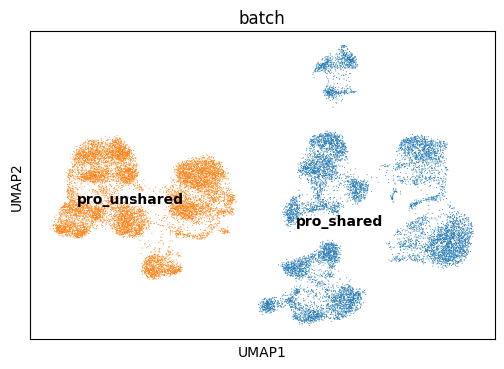

euclidean metric will be used for calculating the distance!
Start the matching process...
Computing the distance matrix...
Getting matchings by Minimum Distance...
Linear assignment completed!
For All matchings: lv1 matching acc: 0.684,
lv2 matching acc: 0.523.
For All matchings: FOSCTTM score: 0.28357568, 
Knn Alignment score: [0.0011 0.0021 0.0032 0.0041 0.0053 0.0069 0.0073 0.0082 0.0091 0.0102
 0.011  0.0121 0.0127 0.0143 0.015  0.0157 0.0167 0.0182 0.0189 0.0201
 0.0208 0.0216 0.0223 0.0232 0.0241]
For All matchings: Silhouette F1 score for lv1: 0.4705765419283311, 
Silhouette F1 score for lv2: 0.46168196674552026



Matches are being filtered...
Matchings before filtering:  10000
Threshold distance for filtering the matchings:  5.8679280281066895
Matchings are reduced to 5000 after filtering...
For only filtered matchings: lv1 matching acc: 0.765,
lv2 matching acc: 0.621.



Matches are being propagated....


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scipy\sparse\_index.py:143: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


Done!
For all matchings after propagation: lv1 matching acc: 0.698,
lv2 matching acc: 0.537.


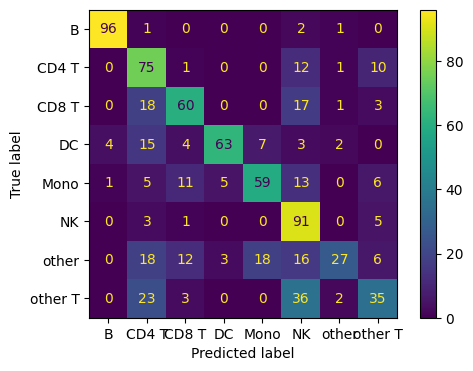

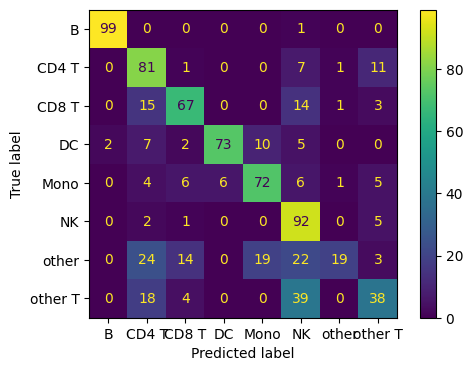

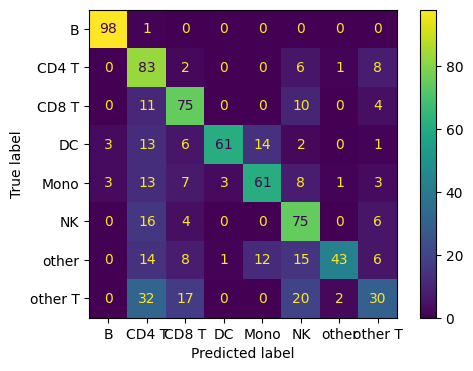

Epoch: 210
Last discriminator loss 1: 0.503721584379673
Last discriminator loss 2: 0.6928243577480316
Last RNA reconstruction loss: 66.88352813720704
Last RNA KL divergence L: 28.105194330215454
Last RNA KL divergence Z: 155.9988655090332
Last protein reconstruction loss: 455.0500228881836
Last protein KL divergence back pro: 773.2353988647461
Last protein KL divergence Z: 155.9988655090332
Last total loss: 523.583723449707
Epoch: 220
Last discriminator loss 1: 0.5038357377052307
Last discriminator loss 2: 0.6928259640932083
Last RNA reconstruction loss: 66.52832489013672
Last RNA KL divergence L: 28.27086877822876
Last RNA KL divergence Z: 155.32455444335938
Last protein reconstruction loss: 455.911856842041
Last protein KL divergence back pro: 773.8580886840821
Last protein KL divergence Z: 155.32455444335938
Last total loss: 524.090463256836
Epoch: 230
Last discriminator loss 1: 0.5036985859274864
Last discriminator loss 2: 0.6928341656923294
Last RNA reconstruction loss: 66.3937460

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


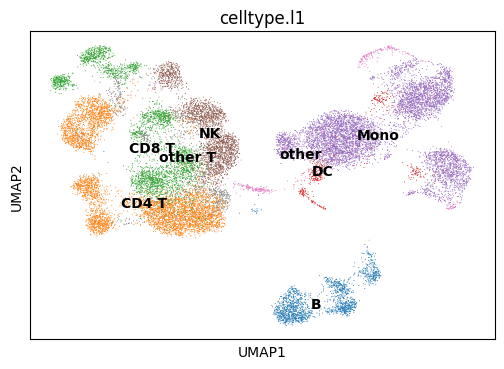

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


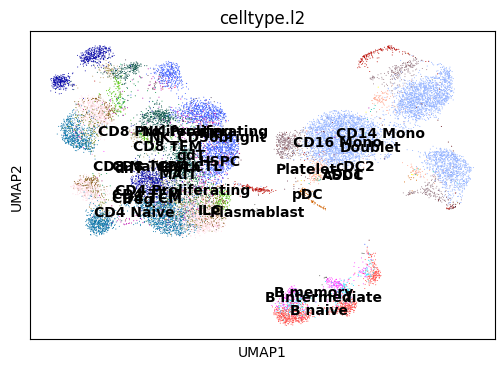

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


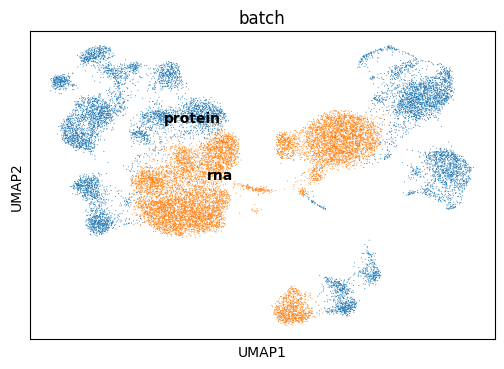

Plots for only rna


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


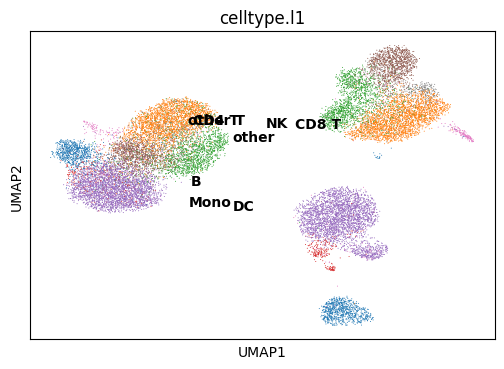

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


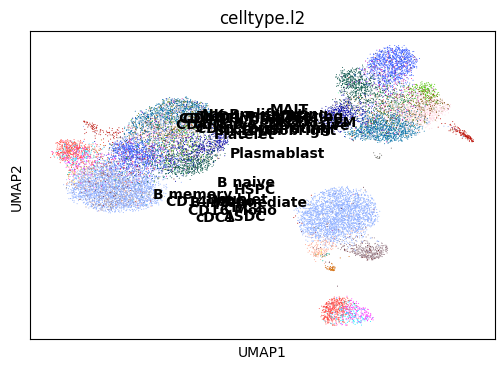

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


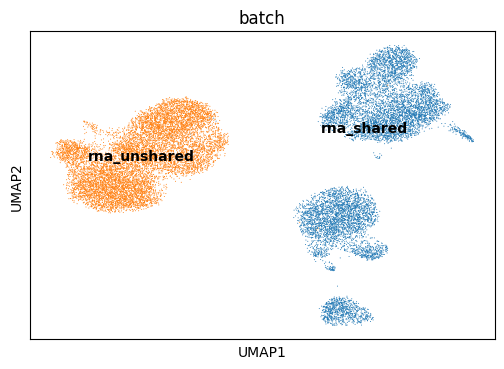

Plots for only proteins


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


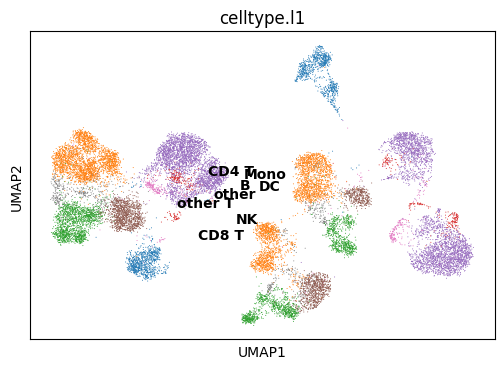

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


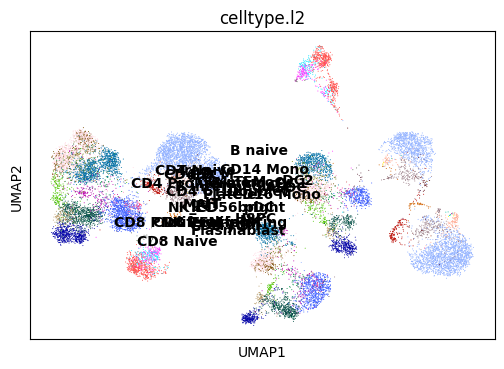

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


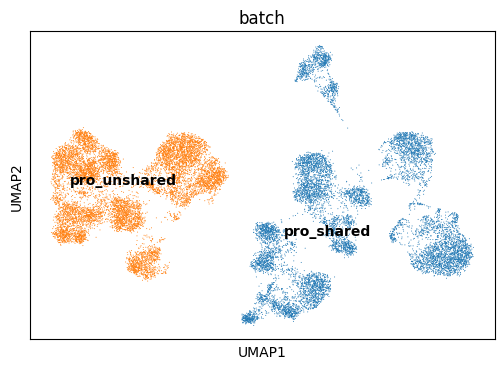

euclidean metric will be used for calculating the distance!
Start the matching process...
Computing the distance matrix...
Getting matchings by Minimum Distance...
Linear assignment completed!
For All matchings: lv1 matching acc: 0.669,
lv2 matching acc: 0.506.
For All matchings: FOSCTTM score: 0.2752255, 
Knn Alignment score: [0.0015 0.0024 0.0036 0.0048 0.0054 0.0066 0.0074 0.0079 0.0089 0.0094
 0.0106 0.0118 0.0123 0.0131 0.014  0.0145 0.0151 0.0157 0.0165 0.0172
 0.0183 0.0193 0.0197 0.0208 0.0216]
For All matchings: Silhouette F1 score for lv1: 0.4821156201927574, 
Silhouette F1 score for lv2: 0.47209307827893543



Matches are being filtered...
Matchings before filtering:  10000
Threshold distance for filtering the matchings:  5.40992546081543
Matchings are reduced to 5000 after filtering...
For only filtered matchings: lv1 matching acc: 0.726,
lv2 matching acc: 0.579.



Matches are being propagated....


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scipy\sparse\_index.py:143: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


Done!
For all matchings after propagation: lv1 matching acc: 0.749,
lv2 matching acc: 0.570.


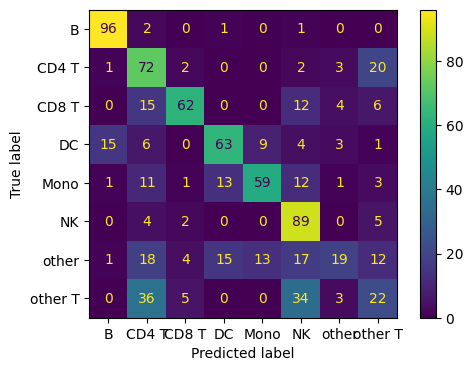

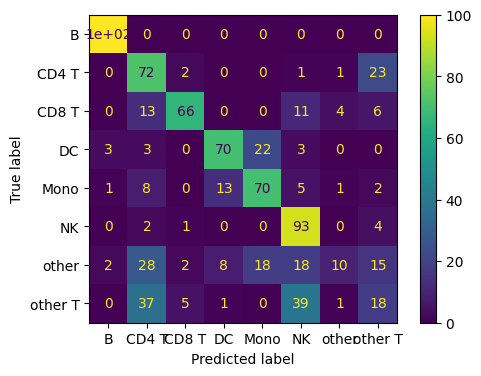

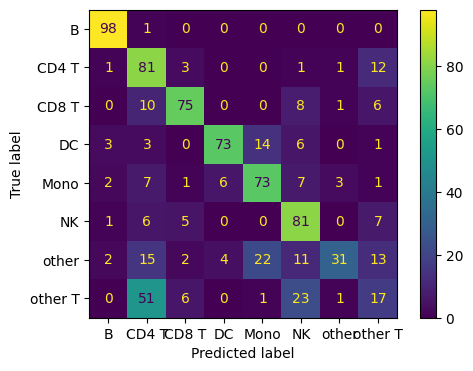

Epoch: 310
Last discriminator loss 1: 0.5038276478648186
Last discriminator loss 2: 0.692680649459362
Last RNA reconstruction loss: 65.4999083518982
Last RNA KL divergence L: 28.091091680526734
Last RNA KL divergence Z: 149.05861167907716
Last protein reconstruction loss: 451.6168045043945
Last protein KL divergence back pro: 755.6257827758789
Last protein KL divergence Z: 149.05861167907716
Last total loss: 518.7421783447265
Epoch: 320
Last discriminator loss 1: 0.5037720397114753
Last discriminator loss 2: 0.6926222518086433
Last RNA reconstruction loss: 65.79401693344116
Last RNA KL divergence L: 28.19090881347656
Last RNA KL divergence Z: 148.99939765930176
Last protein reconstruction loss: 453.35435638427737
Last protein KL divergence back pro: 752.3916610717773
Last protein KL divergence Z: 148.99939765930176
Last total loss: 520.7705841064453
Epoch: 330
Last discriminator loss 1: 0.5037549540400506
Last discriminator loss 2: 0.6927805244922638
Last RNA reconstruction loss: 65.40

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


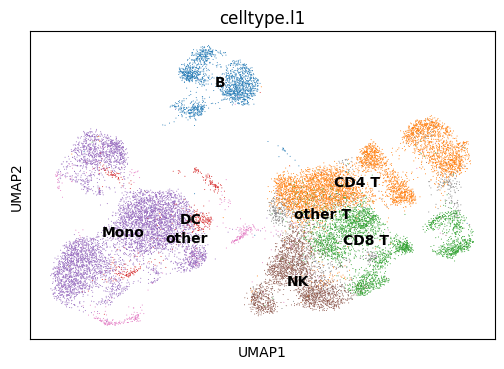

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


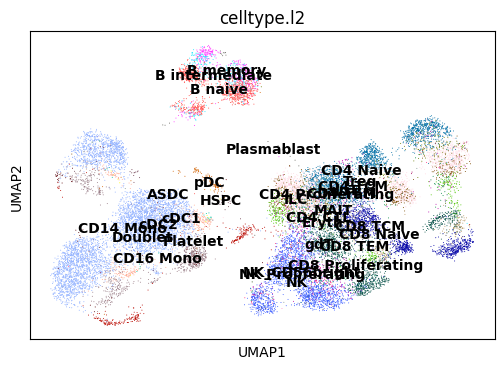

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


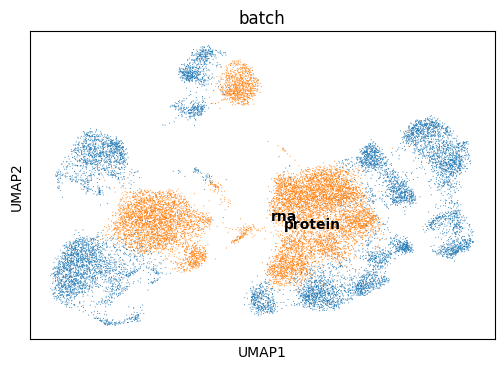

Plots for only rna


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


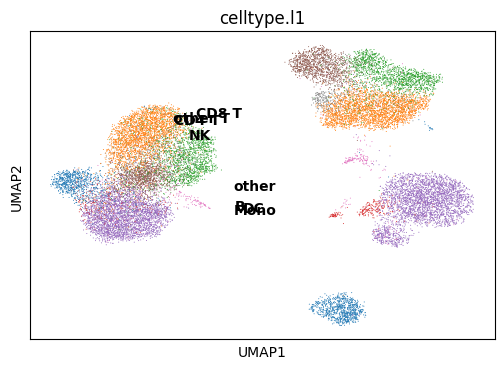

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


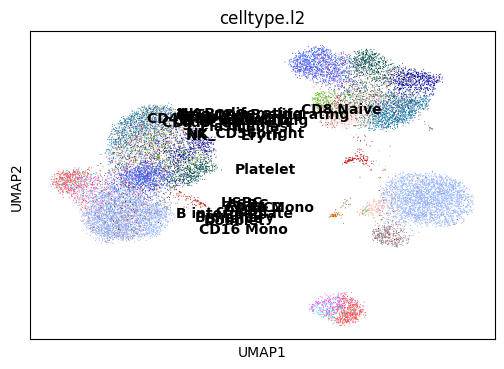

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


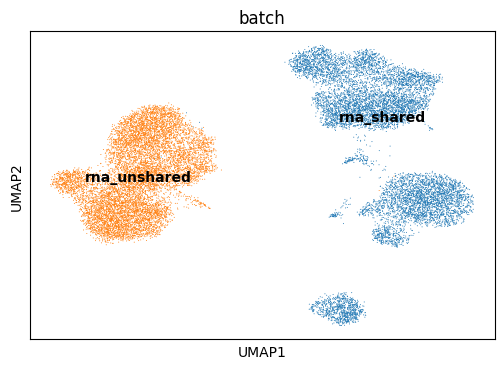

Plots for only proteins


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


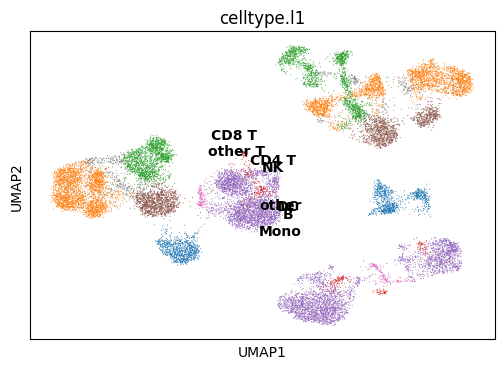

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


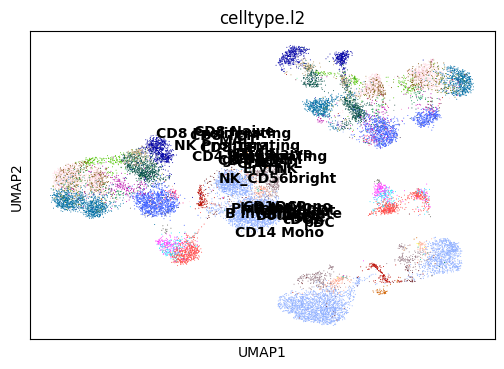

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


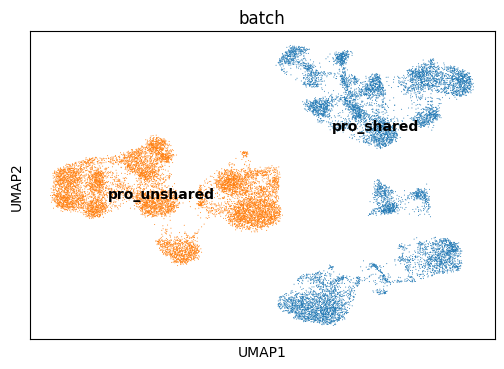

euclidean metric will be used for calculating the distance!
Start the matching process...
Computing the distance matrix...
Getting matchings by Minimum Distance...
Linear assignment completed!
For All matchings: lv1 matching acc: 0.729,
lv2 matching acc: 0.545.
For All matchings: FOSCTTM score: 0.24825090999999996, 
Knn Alignment score: [0.0013 0.0021 0.003  0.0037 0.005  0.0062 0.0076 0.0087 0.01   0.0109
 0.012  0.0127 0.0137 0.0145 0.0157 0.0162 0.0173 0.0188 0.0195 0.0203
 0.0216 0.0224 0.0232 0.0241 0.0243]
For All matchings: Silhouette F1 score for lv1: 0.4950940866012496, 
Silhouette F1 score for lv2: 0.4848433736864624



Matches are being filtered...
Matchings before filtering:  10000
Threshold distance for filtering the matchings:  5.115237236022949
Matchings are reduced to 5000 after filtering...
For only filtered matchings: lv1 matching acc: 0.796,
lv2 matching acc: 0.620.



Matches are being propagated....


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scipy\sparse\_index.py:143: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


Done!
For all matchings after propagation: lv1 matching acc: 0.783,
lv2 matching acc: 0.580.


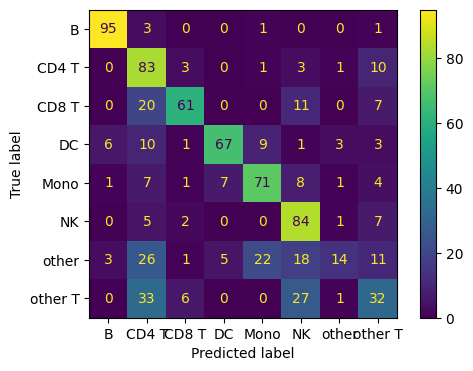

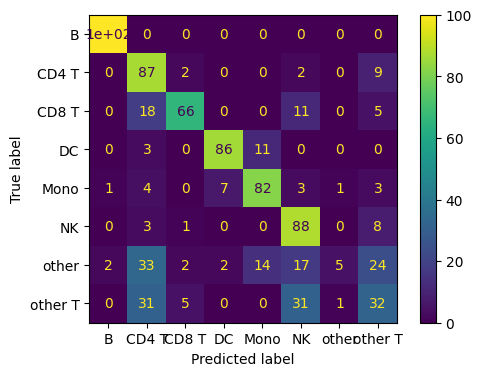

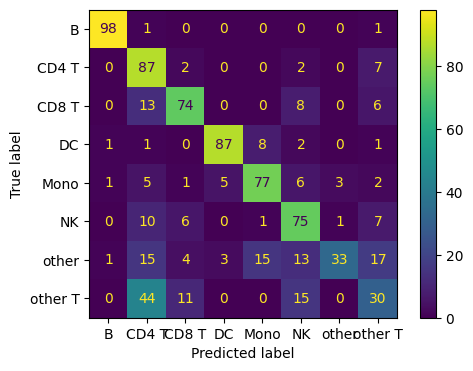

Epoch: 410
Last discriminator loss 1: 0.5039283365011216
Last discriminator loss 2: 0.6926221683621406
Last RNA reconstruction loss: 65.14470586776733
Last RNA KL divergence L: 28.220168828964233
Last RNA KL divergence Z: 147.34804611206056
Last protein reconstruction loss: 451.67344665527344
Last protein KL divergence back pro: 746.6279891967773
Last protein KL divergence Z: 147.34804611206056
Last total loss: 518.4329734802246
Epoch: 420
Last discriminator loss 1: 0.5037871778011322
Last discriminator loss 2: 0.6927230000495911
Last RNA reconstruction loss: 64.88883504867553
Last RNA KL divergence L: 28.210967206954955
Last RNA KL divergence Z: 147.53790779113768
Last protein reconstruction loss: 451.4020942687988
Last protein KL divergence back pro: 746.769139099121
Last protein KL divergence Z: 147.53790779113768
Last total loss: 517.9061698913574
Epoch: 430
Last discriminator loss 1: 0.5037739872932434
Last discriminator loss 2: 0.6928248450160026
Last RNA reconstruction loss: 64.

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


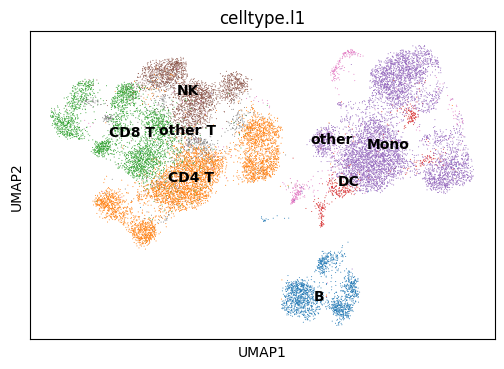

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


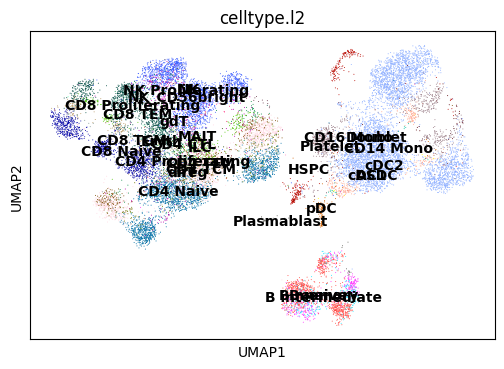

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


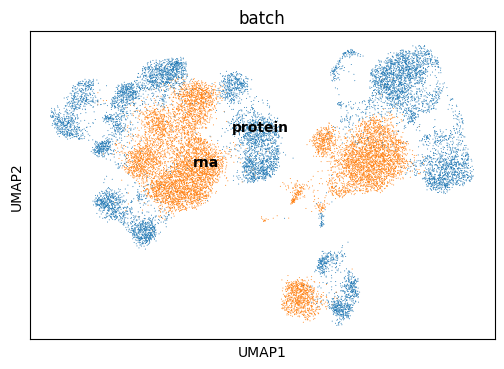

Plots for only rna


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


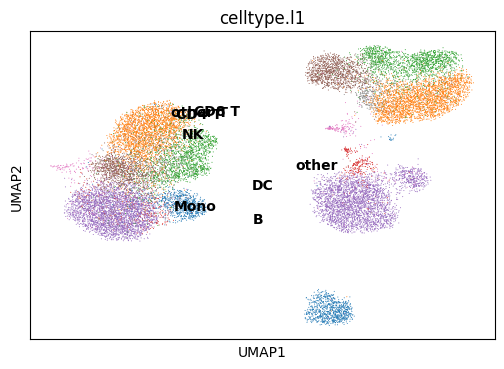

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


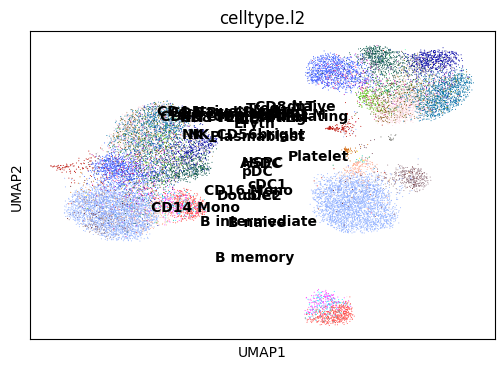

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


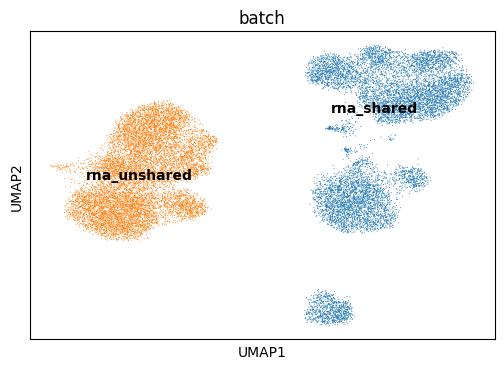

Plots for only proteins


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


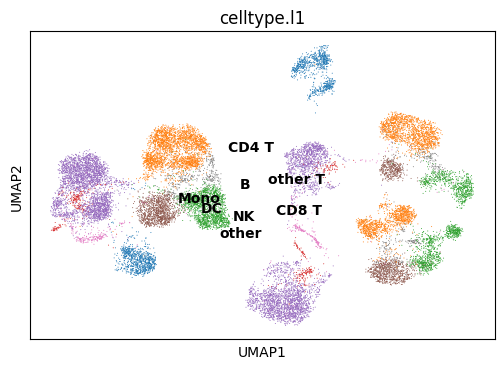

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


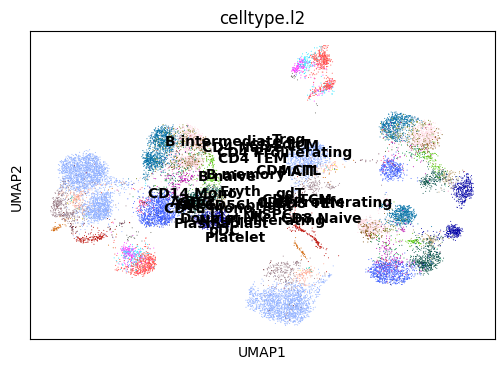

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


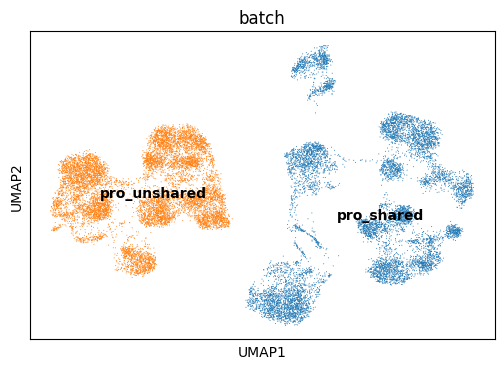

euclidean metric will be used for calculating the distance!
Start the matching process...
Computing the distance matrix...
Getting matchings by Minimum Distance...
Linear assignment completed!
For All matchings: lv1 matching acc: 0.766,
lv2 matching acc: 0.588.
For All matchings: FOSCTTM score: 0.23457013000000002, 
Knn Alignment score: [0.0012 0.0021 0.0033 0.0053 0.0061 0.0075 0.0086 0.0095 0.0105 0.0115
 0.013  0.0138 0.0145 0.0153 0.0161 0.0169 0.0179 0.0189 0.0202 0.0208
 0.0215 0.0225 0.0236 0.0242 0.025 ]
For All matchings: Silhouette F1 score for lv1: 0.4989493833904372, 
Silhouette F1 score for lv2: 0.4880709150145819



Matches are being filtered...
Matchings before filtering:  10000
Threshold distance for filtering the matchings:  5.003492593765259
Matchings are reduced to 5000 after filtering...
For only filtered matchings: lv1 matching acc: 0.846,
lv2 matching acc: 0.687.



Matches are being propagated....


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scipy\sparse\_index.py:143: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


Done!
For all matchings after propagation: lv1 matching acc: 0.790,
lv2 matching acc: 0.587.


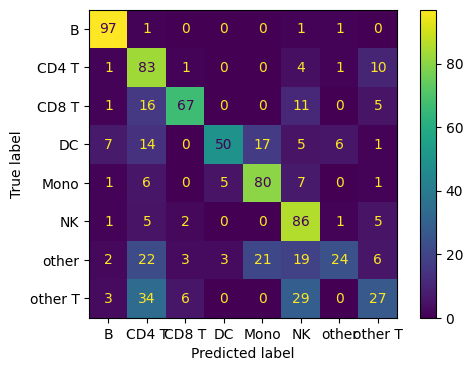

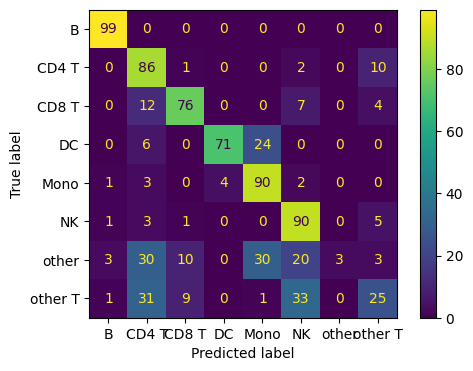

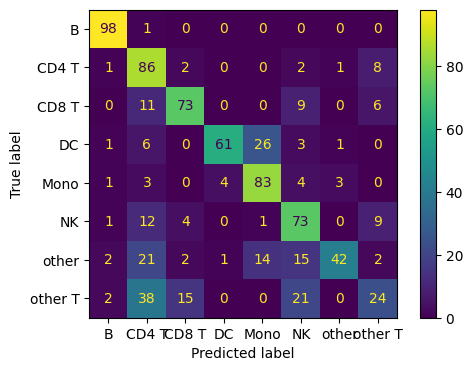

Epoch: 510
Last discriminator loss 1: 0.5037056162953377
Last discriminator loss 2: 0.6928257018327713
Last RNA reconstruction loss: 64.8417896270752
Last RNA KL divergence L: 28.100360059738158
Last RNA KL divergence Z: 145.22308425903321
Last protein reconstruction loss: 450.24064712524415
Last protein KL divergence back pro: 739.0476577758789
Last protein KL divergence Z: 145.22308425903321
Last total loss: 516.6876358032226
Epoch: 520
Last discriminator loss 1: 0.5036988988518715
Last discriminator loss 2: 0.6928801193833352
Last RNA reconstruction loss: 64.8644594192505
Last RNA KL divergence L: 28.133751249313356
Last RNA KL divergence Z: 145.10506057739258
Last protein reconstruction loss: 452.1437187194824
Last protein KL divergence back pro: 735.6848251342774
Last protein KL divergence Z: 145.10506057739258
Last total loss: 518.609992980957
Epoch: 530
Last discriminator loss 1: 0.503764420747757
Last discriminator loss 2: 0.6926803648471832
Last RNA reconstruction loss: 64.644

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


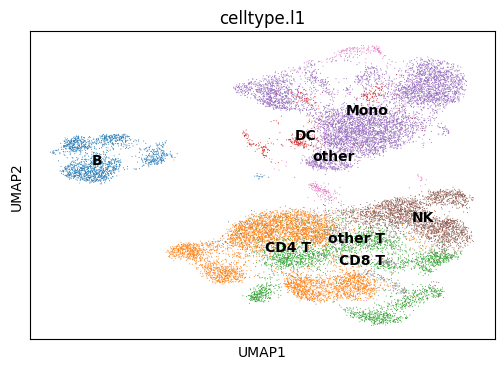

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


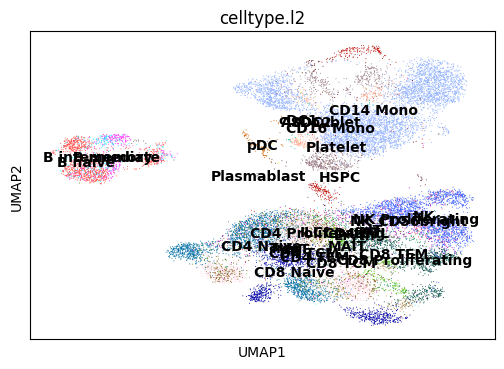

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


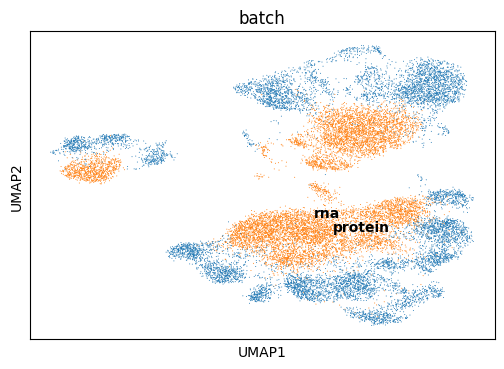

Plots for only rna


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


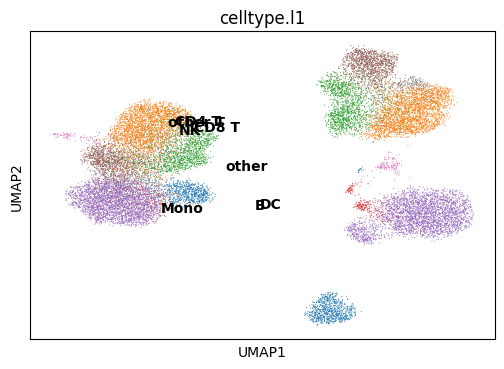

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


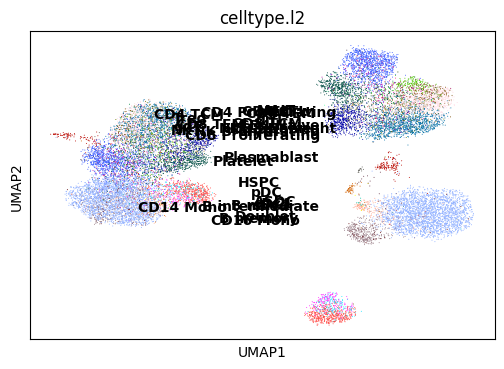

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


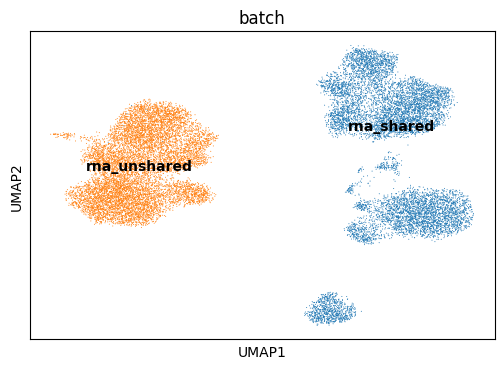

Plots for only proteins


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


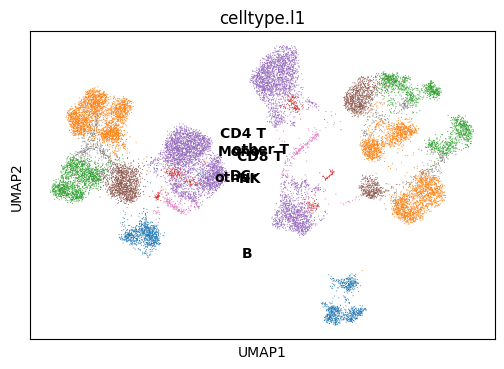

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


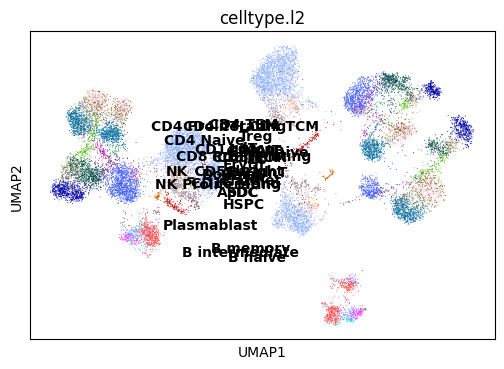

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


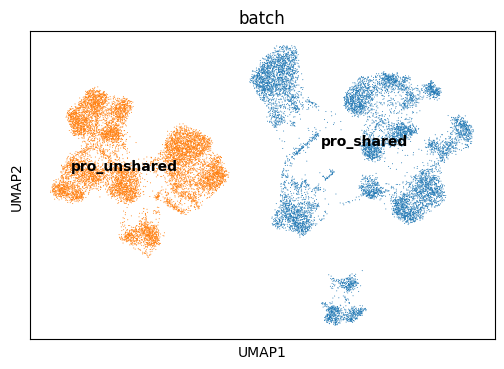

euclidean metric will be used for calculating the distance!
Start the matching process...
Computing the distance matrix...
Getting matchings by Minimum Distance...
Linear assignment completed!
For All matchings: lv1 matching acc: 0.733,
lv2 matching acc: 0.566.
For All matchings: FOSCTTM score: 0.22995890999999996, 
Knn Alignment score: [0.0009 0.0019 0.0034 0.0047 0.006  0.0072 0.0079 0.0084 0.0093 0.01
 0.0111 0.0122 0.0132 0.0144 0.0152 0.0158 0.0165 0.0171 0.018  0.0188
 0.0195 0.0202 0.0211 0.022  0.0227]
For All matchings: Silhouette F1 score for lv1: 0.5018569947241264, 
Silhouette F1 score for lv2: 0.4907823941051743



Matches are being filtered...
Matchings before filtering:  10000
Threshold distance for filtering the matchings:  4.89116644859314
Matchings are reduced to 5000 after filtering...
For only filtered matchings: lv1 matching acc: 0.794,
lv2 matching acc: 0.645.



Matches are being propagated....
Done!
For all matchings after propagation: lv1 matching acc: 0.777,
l

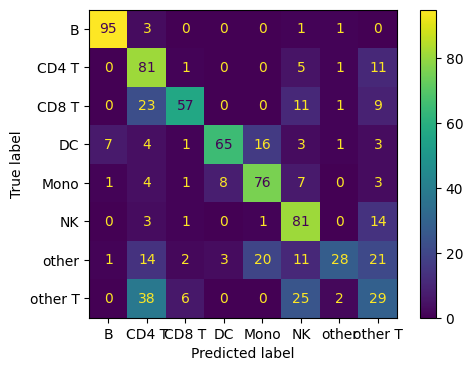

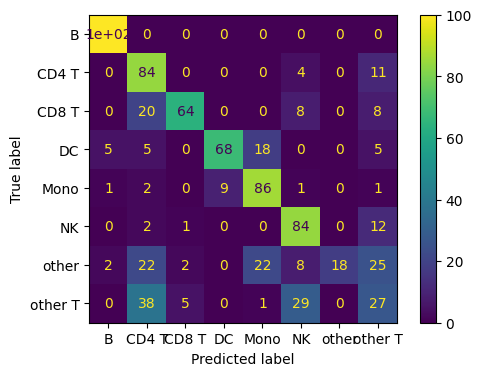

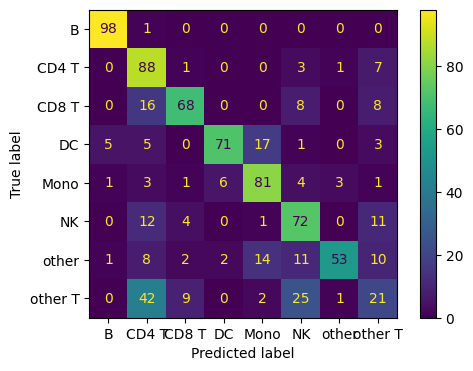

Epoch: 610
Last discriminator loss 1: 0.5038147702813148
Last discriminator loss 2: 0.6928407698869705
Last RNA reconstruction loss: 64.36784572601319
Last RNA KL divergence L: 28.046844720840454
Last RNA KL divergence Z: 143.06501388549805
Last protein reconstruction loss: 449.8945899963379
Last protein KL divergence back pro: 729.548924255371
Last protein KL divergence Z: 143.06501388549805
Last total loss: 515.8559349060058
Epoch: 620
Last discriminator loss 1: 0.5037239983677864
Last discriminator loss 2: 0.6928368404507637
Last RNA reconstruction loss: 64.37432012557983
Last RNA KL divergence L: 28.081029844284057
Last RNA KL divergence Z: 143.09434852600097
Last protein reconstruction loss: 449.6523155212402
Last protein KL divergence back pro: 730.2089157104492
Last protein KL divergence Z: 143.09434852600097
Last total loss: 515.6208534240723
Epoch: 630
Last discriminator loss 1: 0.5036967068910598
Last discriminator loss 2: 0.6926849007606506
Last RNA reconstruction loss: 64.4

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


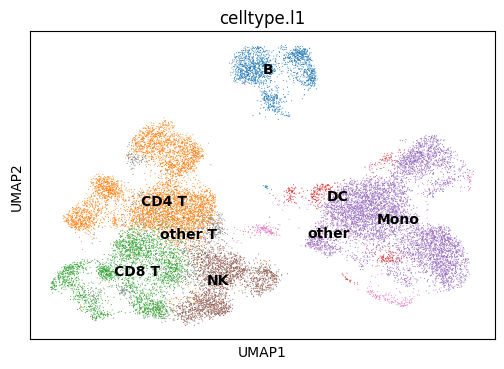

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


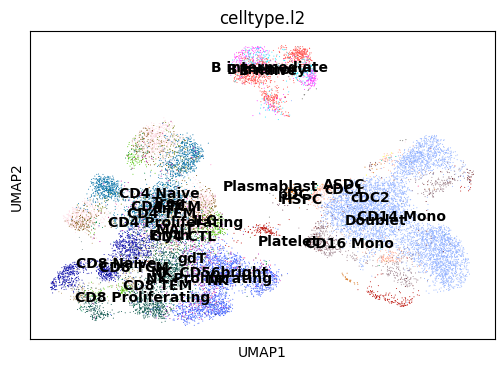

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


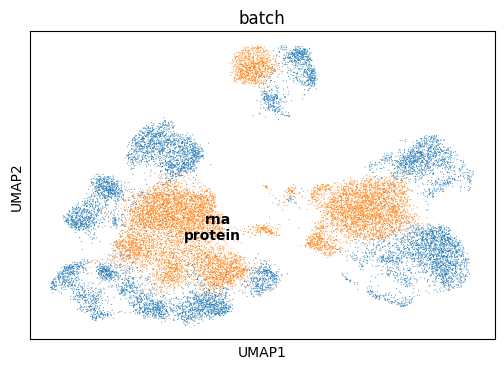

Plots for only rna


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


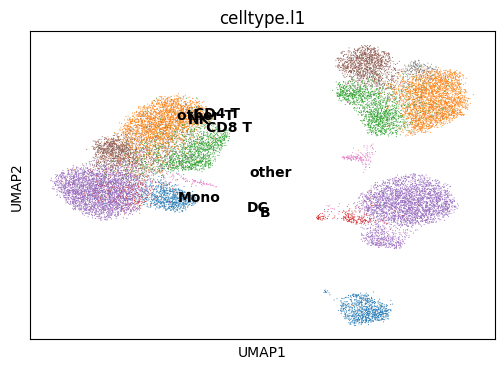

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


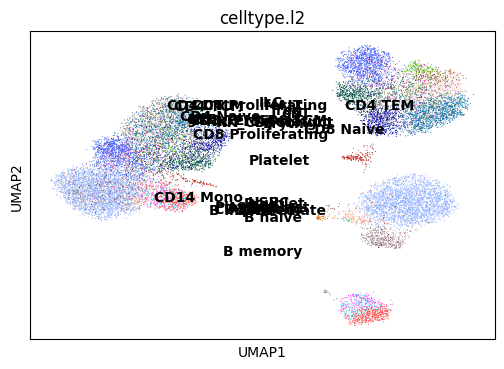

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


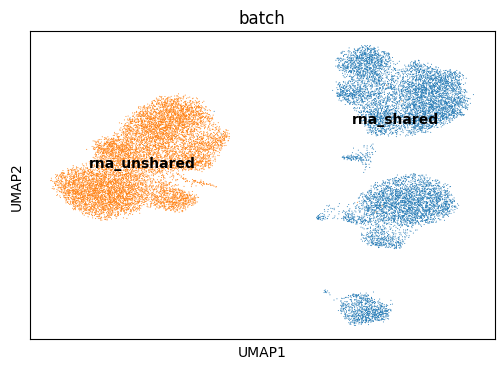

Plots for only proteins


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


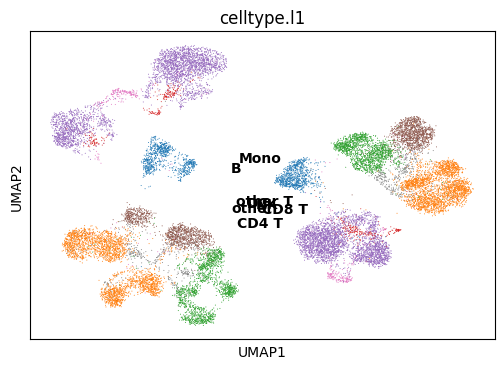

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


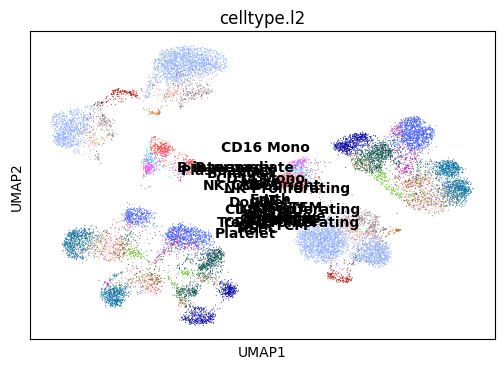

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


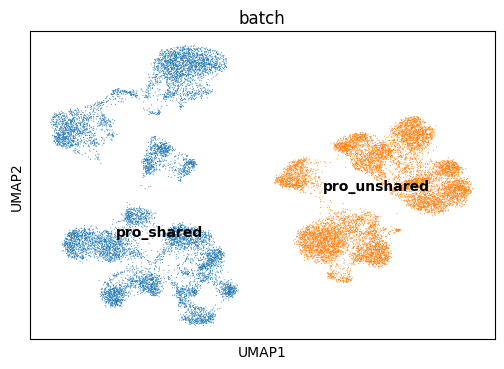

euclidean metric will be used for calculating the distance!
Start the matching process...
Computing the distance matrix...
Getting matchings by Minimum Distance...
Linear assignment completed!
For All matchings: lv1 matching acc: 0.759,
lv2 matching acc: 0.574.
For All matchings: FOSCTTM score: 0.22663735999999998, 
Knn Alignment score: [0.0013 0.0021 0.0035 0.005  0.0058 0.0066 0.0075 0.0086 0.0095 0.0099
 0.011  0.012  0.013  0.0141 0.0154 0.0163 0.0171 0.0179 0.0189 0.0197
 0.0205 0.0213 0.0224 0.0238 0.0248]
For All matchings: Silhouette F1 score for lv1: 0.5046867478041306, 
Silhouette F1 score for lv2: 0.49443908216079663



Matches are being filtered...
Matchings before filtering:  10000
Threshold distance for filtering the matchings:  4.803897142410278
Matchings are reduced to 5000 after filtering...
For only filtered matchings: lv1 matching acc: 0.831,
lv2 matching acc: 0.666.



Matches are being propagated....
Done!
For all matchings after propagation: lv1 matching acc: 0.79

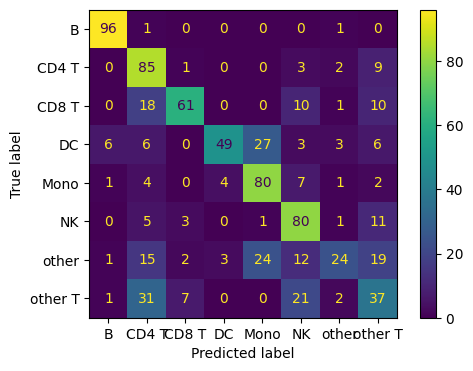

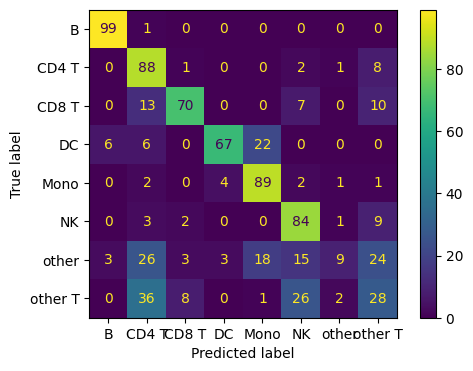

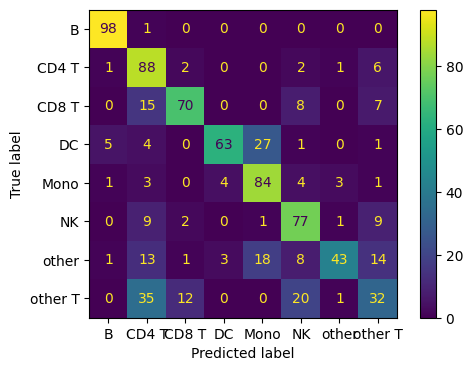

Epoch: 710
Last discriminator loss 1: 0.5036741331219673
Last discriminator loss 2: 0.6926774382591248
Last RNA reconstruction loss: 64.21102132797242
Last RNA KL divergence L: 28.052492332458495
Last RNA KL divergence Z: 142.61932716369628
Last protein reconstruction loss: 450.2305313110352
Last protein KL divergence back pro: 728.5779052734375
Last protein KL divergence Z: 142.61932716369628
Last total loss: 516.0334823608398
Epoch: 720
Last discriminator loss 1: 0.5036788135766983
Last discriminator loss 2: 0.692773962020874
Last RNA reconstruction loss: 64.1416576385498
Last RNA KL divergence L: 28.2626091003418
Last RNA KL divergence Z: 142.34938163757323
Last protein reconstruction loss: 449.0948455810547
Last protein KL divergence back pro: 726.3322326660157
Last protein KL divergence Z: 142.34938163757323
Last total loss: 514.8262115478516
Epoch: 730
Last discriminator loss 1: 0.5037559390068054
Last discriminator loss 2: 0.6927835062146187
Last RNA reconstruction loss: 64.0796

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


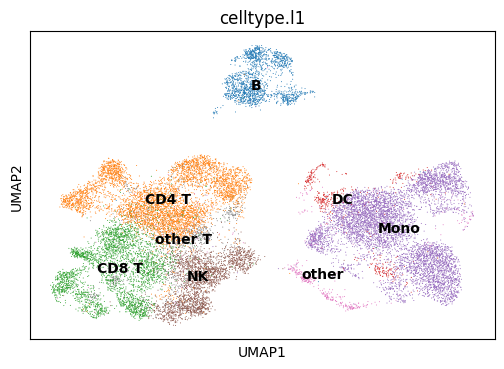

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


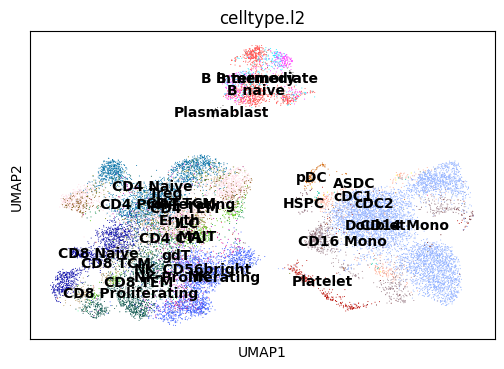

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


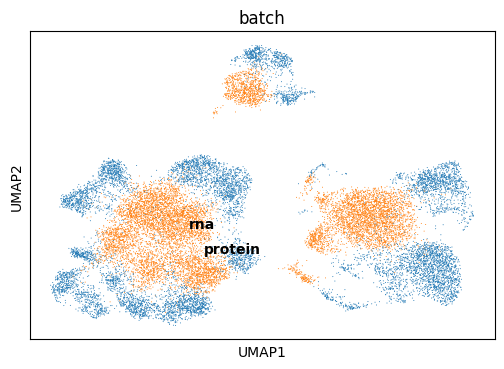

Plots for only rna


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


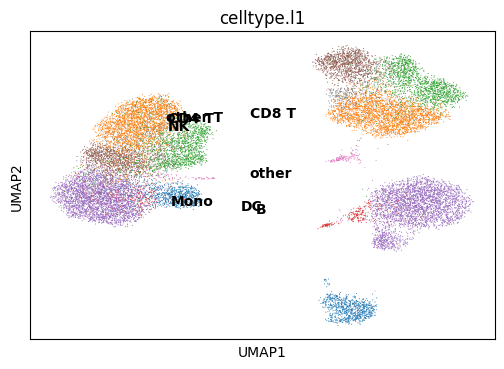

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


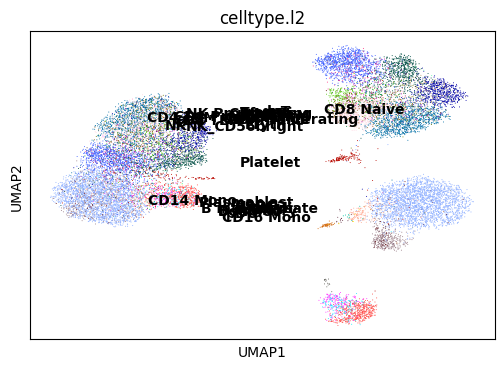

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


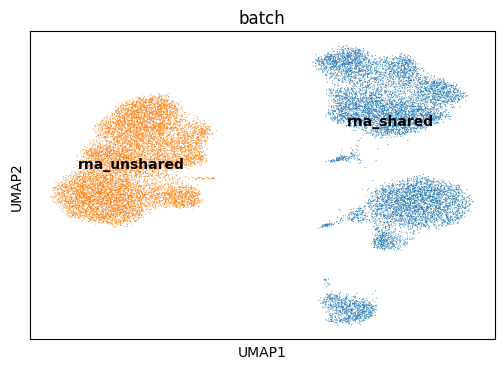

Plots for only proteins


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


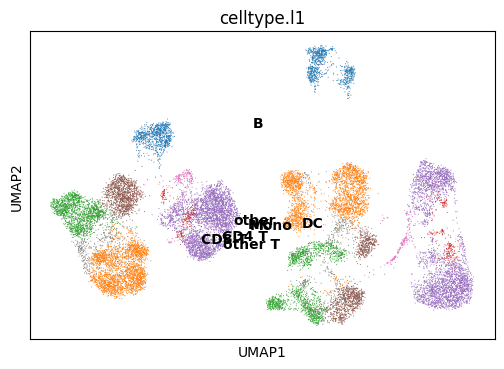

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


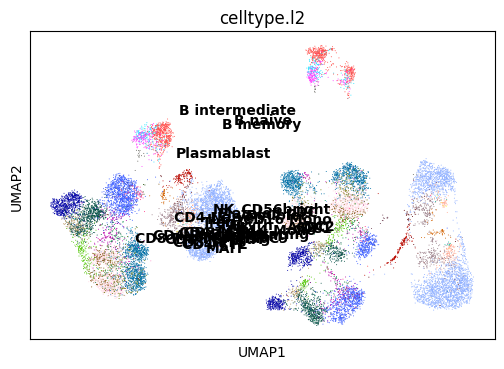

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


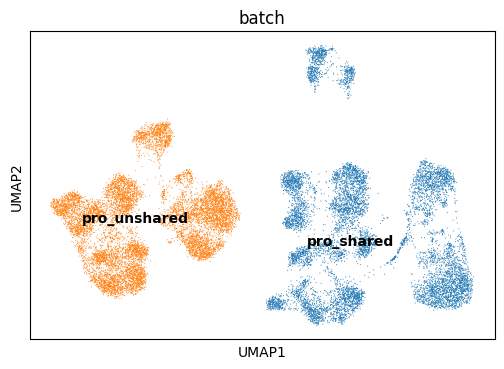

euclidean metric will be used for calculating the distance!
Start the matching process...
Computing the distance matrix...
Getting matchings by Minimum Distance...
Linear assignment completed!
For All matchings: lv1 matching acc: 0.748,
lv2 matching acc: 0.565.
For All matchings: FOSCTTM score: 0.22655495, 
Knn Alignment score: [0.0012 0.0027 0.0037 0.0044 0.0059 0.0067 0.0081 0.0093 0.0103 0.0115
 0.0125 0.0133 0.014  0.015  0.0156 0.0165 0.0169 0.018  0.0187 0.0196
 0.0205 0.0211 0.0223 0.0227 0.0235]
For All matchings: Silhouette F1 score for lv1: 0.5044511399892853, 
Silhouette F1 score for lv2: 0.4934434097195936



Matches are being filtered...
Matchings before filtering:  10000
Threshold distance for filtering the matchings:  4.810956716537476
Matchings are reduced to 5000 after filtering...
For only filtered matchings: lv1 matching acc: 0.827,
lv2 matching acc: 0.654.



Matches are being propagated....
Done!
For all matchings after propagation: lv1 matching acc: 0.796,
lv2 mat

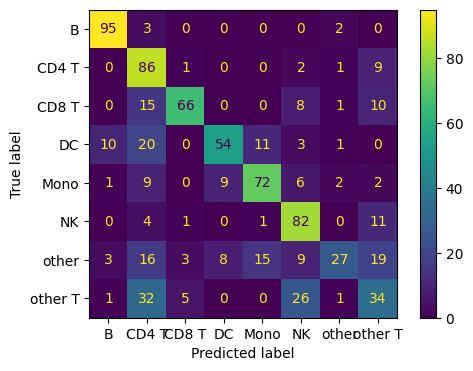

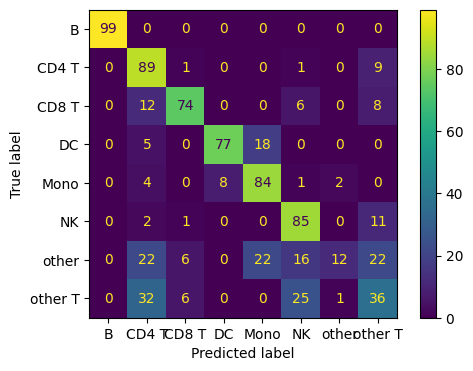

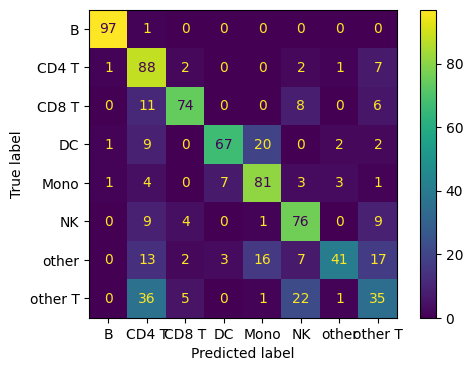

Epoch: 810
Last discriminator loss 1: 0.503618897497654
Last discriminator loss 2: 0.6927278161048889
Last RNA reconstruction loss: 64.1081473350525
Last RNA KL divergence L: 27.92051544189453
Last RNA KL divergence Z: 141.36270027160646
Last protein reconstruction loss: 448.5448516845703
Last protein KL divergence back pro: 724.0844909667969
Last protein KL divergence Z: 141.36270027160646
Last total loss: 514.239094543457
Epoch: 820
Last discriminator loss 1: 0.5036559209227562
Last discriminator loss 2: 0.6928221002221108
Last RNA reconstruction loss: 64.21105785369873
Last RNA KL divergence L: 28.023126125335693
Last RNA KL divergence Z: 141.28035507202148
Last protein reconstruction loss: 448.9056640625
Last protein KL divergence back pro: 720.0678833007812
Last protein KL divergence Z: 141.28035507202148
Last total loss: 514.6989143371582
Epoch: 830
Last discriminator loss 1: 0.5036807760596276
Last discriminator loss 2: 0.6927570298314094
Last RNA reconstruction loss: 64.1195598

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


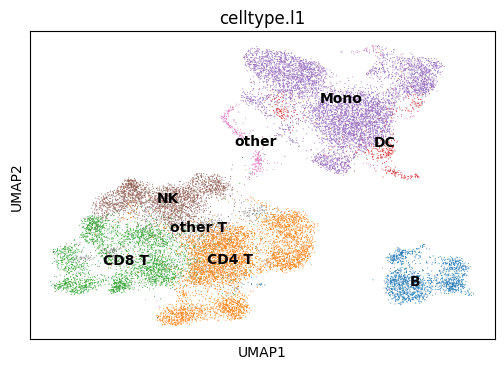

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


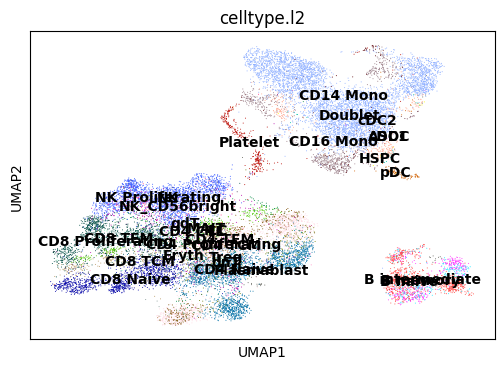

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


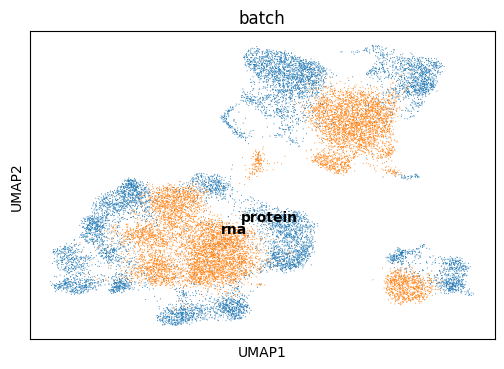

Plots for only rna


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


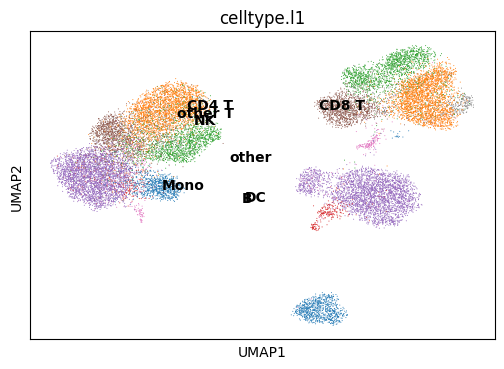

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


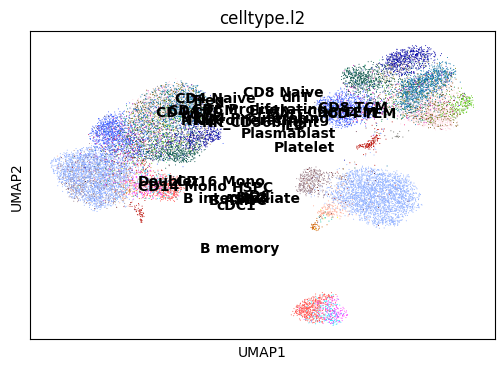

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


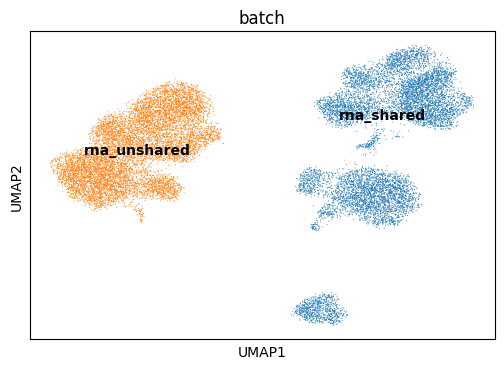

Plots for only proteins


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


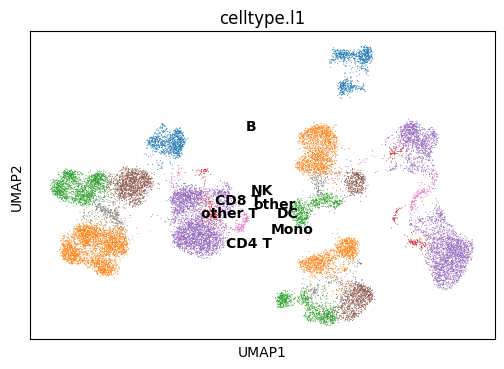

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


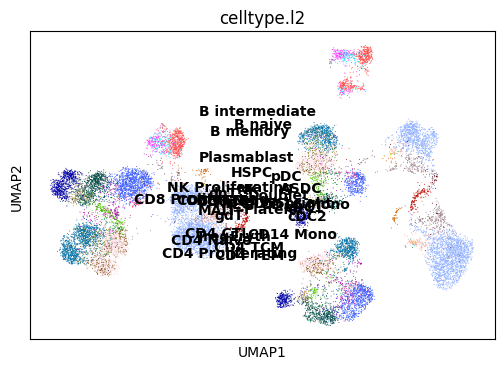

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


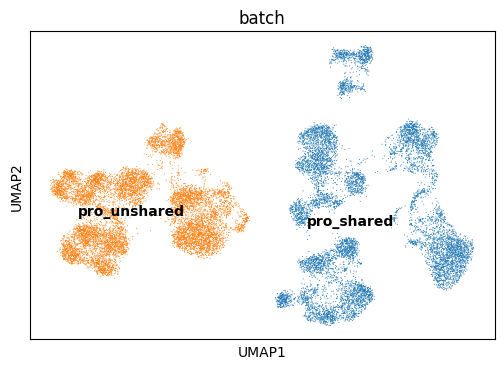

euclidean metric will be used for calculating the distance!
Start the matching process...
Computing the distance matrix...
Getting matchings by Minimum Distance...
Linear assignment completed!
For All matchings: lv1 matching acc: 0.760,
lv2 matching acc: 0.577.
For All matchings: FOSCTTM score: 0.22715853000000003, 
Knn Alignment score: [0.0011 0.0026 0.0034 0.0049 0.0064 0.0073 0.0083 0.0089 0.0098 0.0113
 0.0124 0.0133 0.0142 0.0147 0.0153 0.0163 0.0172 0.0184 0.0196 0.0202
 0.0209 0.022  0.0226 0.0235 0.0242]
For All matchings: Silhouette F1 score for lv1: 0.506266036074192, 
Silhouette F1 score for lv2: 0.49515834445169693



Matches are being filtered...
Matchings before filtering:  10000
Threshold distance for filtering the matchings:  4.732396602630615
Matchings are reduced to 5000 after filtering...
For only filtered matchings: lv1 matching acc: 0.835,
lv2 matching acc: 0.669.



Matches are being propagated....


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scipy\sparse\_index.py:143: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


Done!
For all matchings after propagation: lv1 matching acc: 0.796,
lv2 matching acc: 0.600.


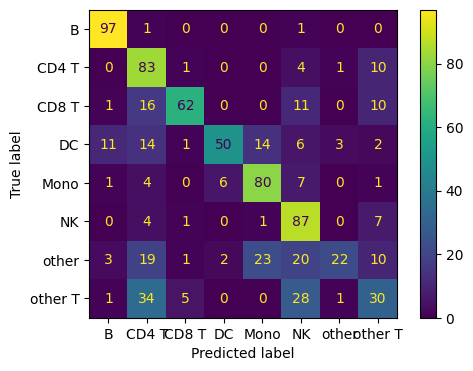

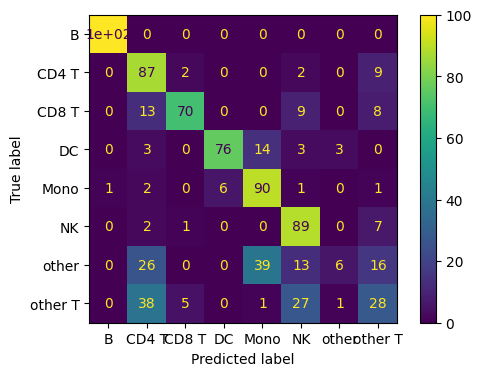

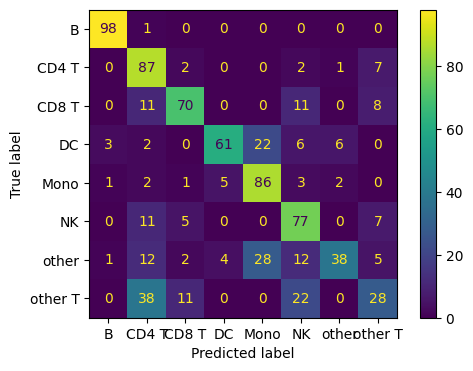

Epoch: 910
Last discriminator loss 1: 0.5036193981766701
Last discriminator loss 2: 0.6928264319896698
Last RNA reconstruction loss: 64.11151437759399
Last RNA KL divergence L: 28.03318691253662
Last RNA KL divergence Z: 140.71069145202637
Last protein reconstruction loss: 448.5949760437012
Last protein KL divergence back pro: 723.9577514648438
Last protein KL divergence Z: 140.71069145202637
Last total loss: 514.2920219421387
Epoch: 920
Last discriminator loss 1: 0.5036818340420723
Last discriminator loss 2: 0.6928378850221634
Last RNA reconstruction loss: 64.18862895965576
Last RNA KL divergence L: 27.901736068725587
Last RNA KL divergence Z: 140.445259475708
Last protein reconstruction loss: 448.0890937805176
Last protein KL divergence back pro: 719.7996505737304
Last protein KL divergence Z: 140.445259475708
Last total loss: 513.8587059020996
Epoch: 930
Last discriminator loss 1: 0.5037398785352707
Last discriminator loss 2: 0.6928753569722176
Last RNA reconstruction loss: 64.01485

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


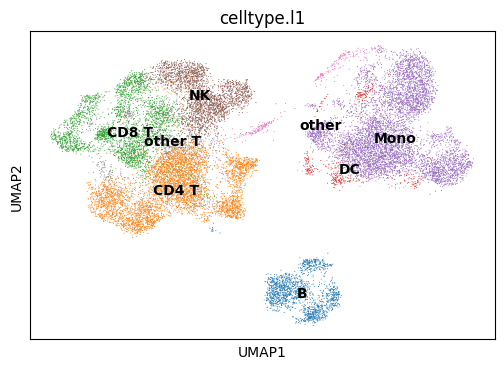

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


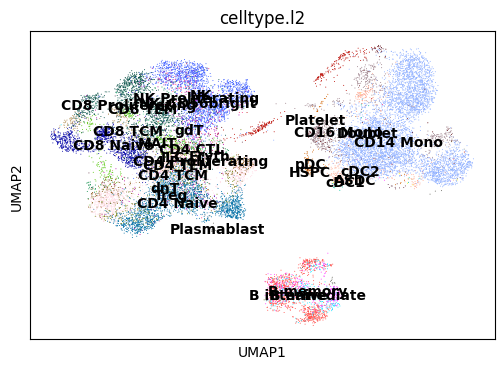

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


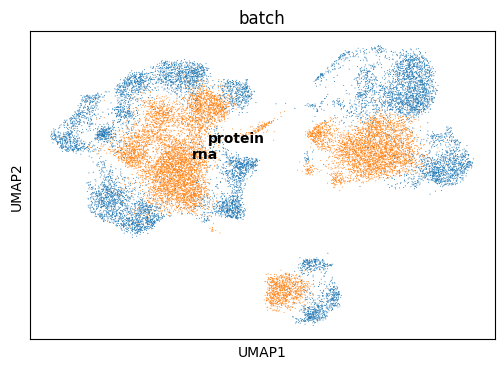

Plots for only rna


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


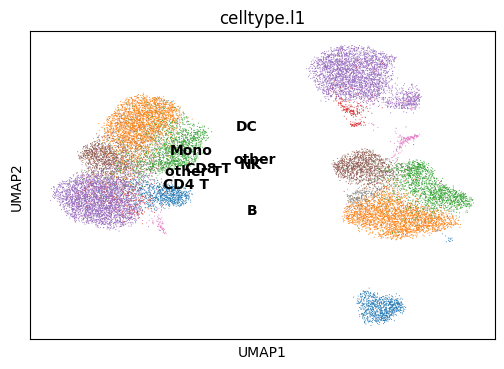

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


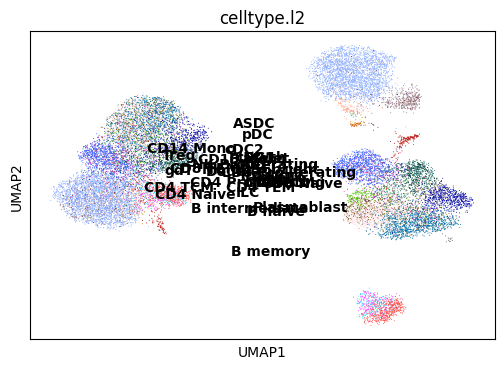

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


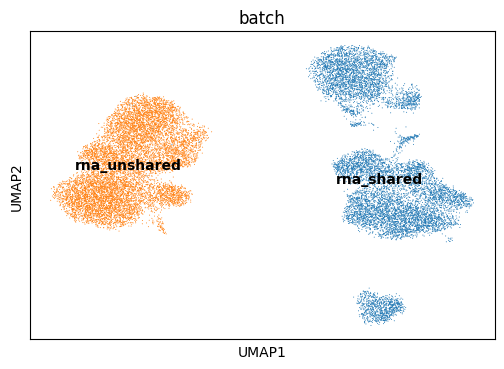

Plots for only proteins


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


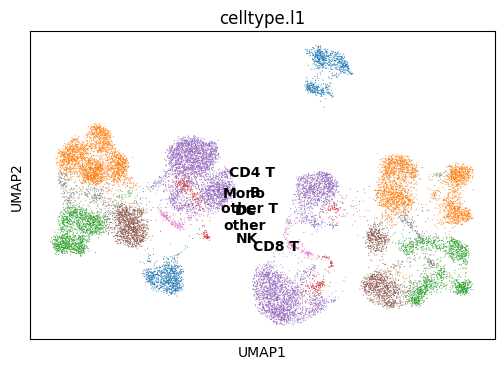

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


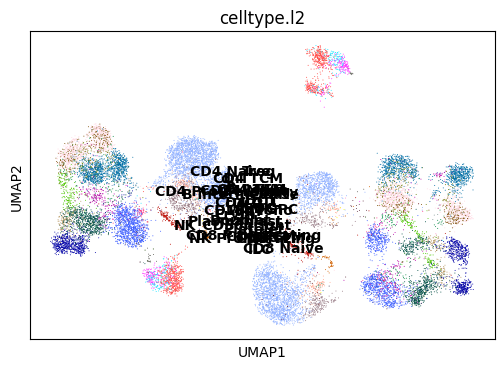

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


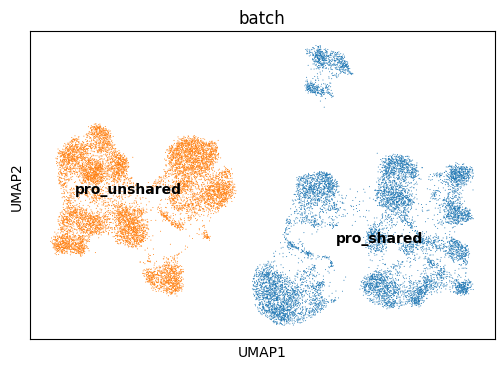

euclidean metric will be used for calculating the distance!
Start the matching process...
Computing the distance matrix...
Getting matchings by Minimum Distance...
Linear assignment completed!
For All matchings: lv1 matching acc: 0.771,
lv2 matching acc: 0.587.
For All matchings: FOSCTTM score: 0.22113231, 
Knn Alignment score: [0.0013 0.0026 0.004  0.0048 0.006  0.0074 0.0088 0.0102 0.0113 0.0118
 0.0128 0.0135 0.0142 0.0152 0.0165 0.0177 0.0183 0.019  0.0203 0.0212
 0.022  0.0231 0.0238 0.0244 0.0258]
For All matchings: Silhouette F1 score for lv1: 0.5076957291538007, 
Silhouette F1 score for lv2: 0.49686972916818384



Matches are being filtered...
Matchings before filtering:  10000
Threshold distance for filtering the matchings:  4.733118295669556
Matchings are reduced to 5000 after filtering...
For only filtered matchings: lv1 matching acc: 0.843,
lv2 matching acc: 0.674.



Matches are being propagated....


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scipy\sparse\_index.py:143: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


Done!
For all matchings after propagation: lv1 matching acc: 0.801,
lv2 matching acc: 0.602.


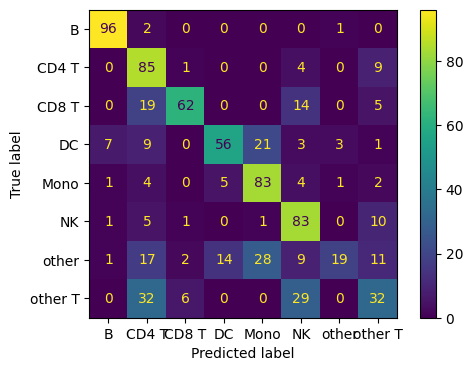

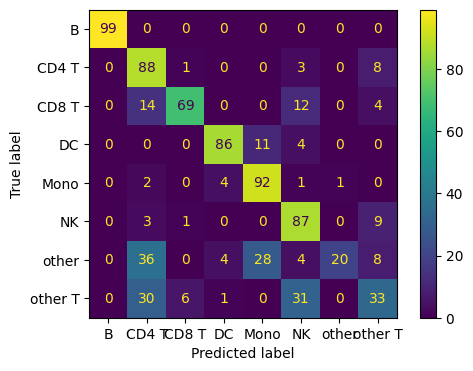

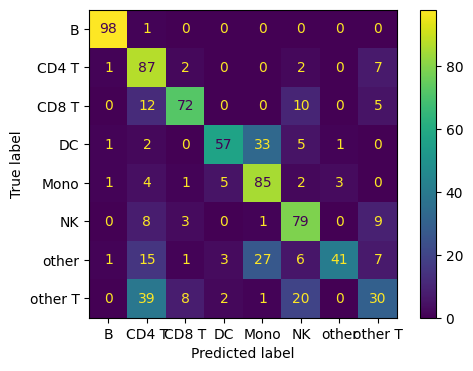

Epoch: 1010
Last discriminator loss 1: 0.5038472563028336
Last discriminator loss 2: 0.6928658694028854
Last RNA reconstruction loss: 63.87598571777344
Last RNA KL divergence L: 27.915452337265016
Last RNA KL divergence Z: 140.33614273071288
Last protein reconstruction loss: 448.76552734375
Last protein KL divergence back pro: 720.283366394043
Last protein KL divergence Z: 140.33614273071288
Last total loss: 514.2229064941406
Epoch: 1020
Last discriminator loss 1: 0.5037484467029572
Last discriminator loss 2: 0.6928341701626778
Last RNA reconstruction loss: 63.82114925384521
Last RNA KL divergence L: 27.995459032058715
Last RNA KL divergence Z: 140.26430969238282
Last protein reconstruction loss: 448.0769836425781
Last protein KL divergence back pro: 720.5357086181641
Last protein KL divergence Z: 140.26430969238282
Last total loss: 513.4797744750977
Epoch: 1030
Last discriminator loss 1: 0.503674641251564
Last discriminator loss 2: 0.6928625047206879
Last RNA reconstruction loss: 63.9

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


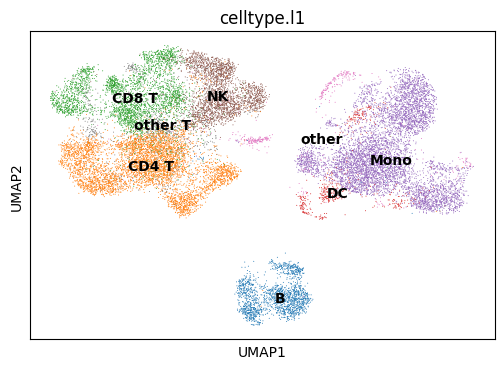

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


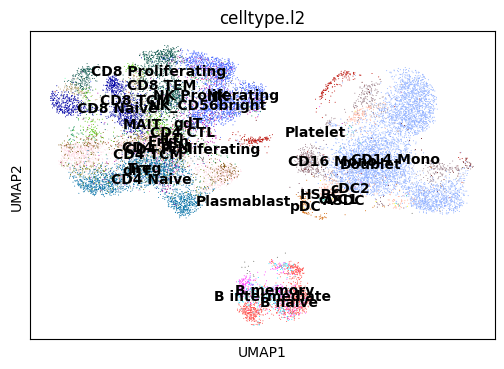

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


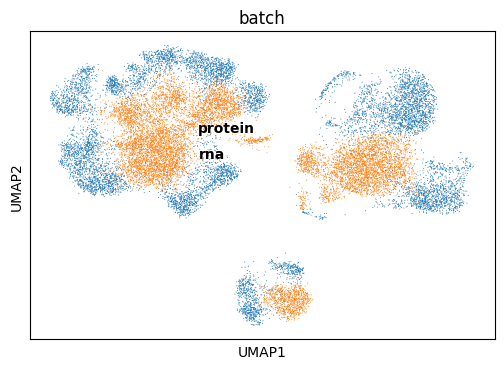

Plots for only rna


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


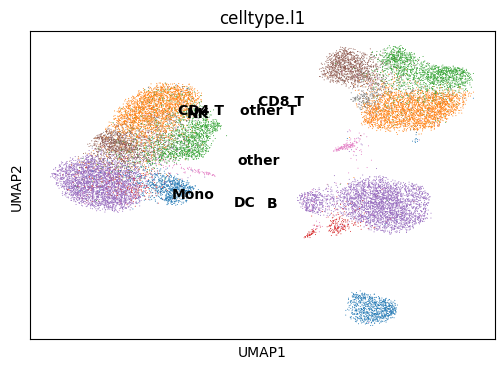

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


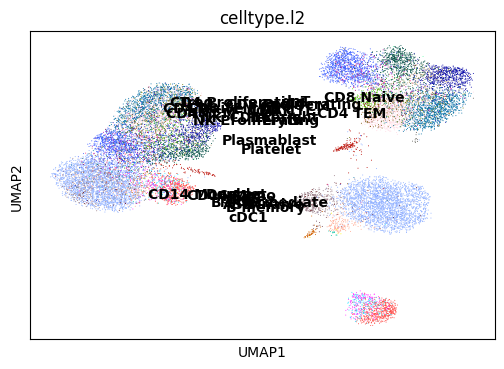

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


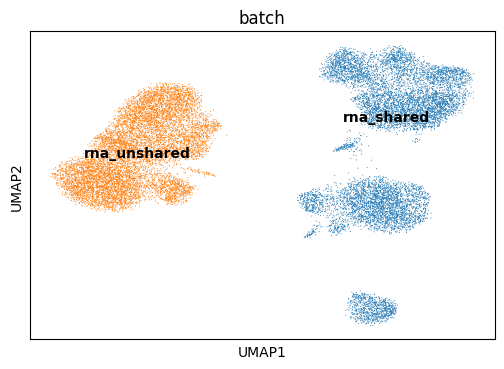

Plots for only proteins


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


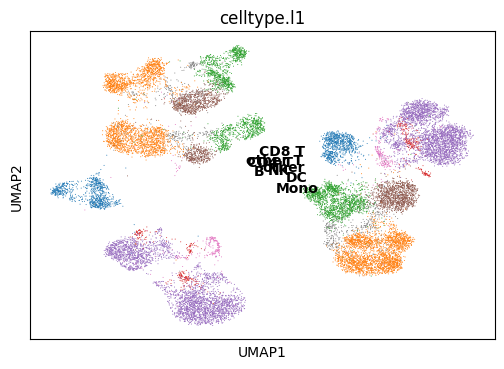

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


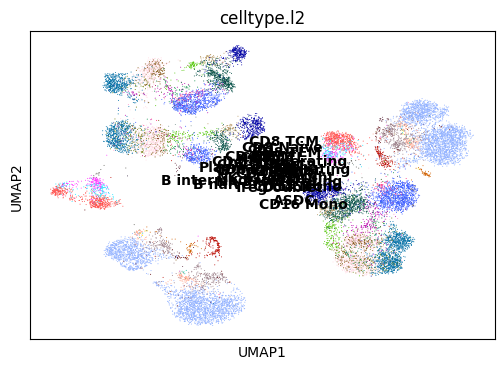

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


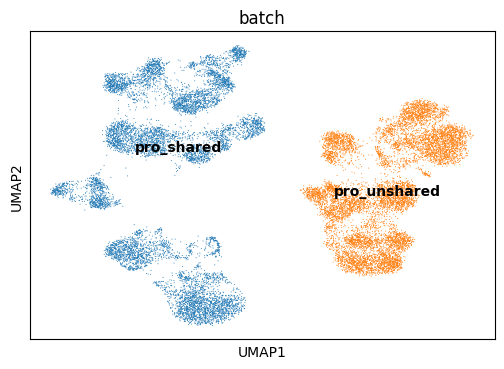

euclidean metric will be used for calculating the distance!
Start the matching process...
Computing the distance matrix...
Getting matchings by Minimum Distance...
Linear assignment completed!
For All matchings: lv1 matching acc: 0.769,
lv2 matching acc: 0.590.
For All matchings: FOSCTTM score: 0.21942106999999997, 
Knn Alignment score: [0.0014 0.0021 0.0032 0.0043 0.0061 0.0073 0.008  0.0086 0.0093 0.0102
 0.0106 0.0116 0.0124 0.0134 0.0145 0.0152 0.0166 0.0168 0.0174 0.018
 0.0188 0.0199 0.0206 0.0212 0.0224]
For All matchings: Silhouette F1 score for lv1: 0.5085118218361936, 
Silhouette F1 score for lv2: 0.4973089625235908



Matches are being filtered...
Matchings before filtering:  10000
Threshold distance for filtering the matchings:  4.69527530670166
Matchings are reduced to 5000 after filtering...
For only filtered matchings: lv1 matching acc: 0.854,
lv2 matching acc: 0.691.



Matches are being propagated....
Done!
For all matchings after propagation: lv1 matching acc: 0.797,


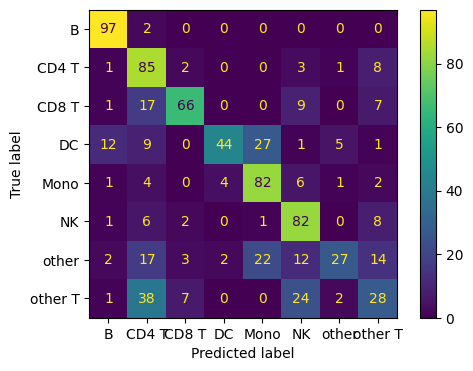

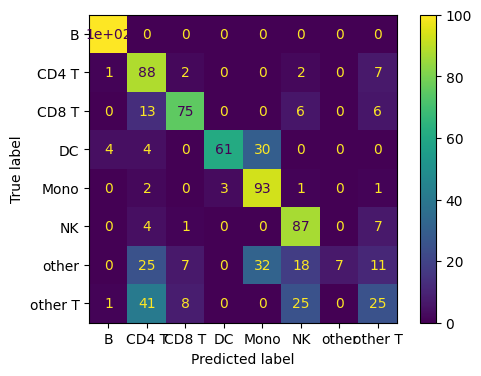

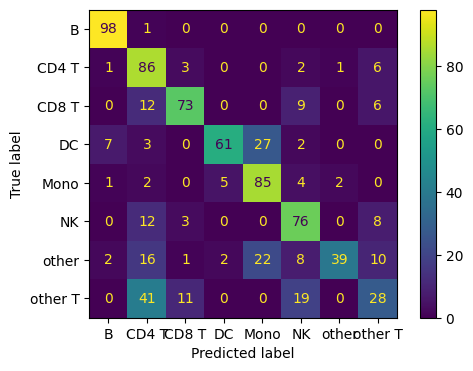

Epoch: 1110
Last discriminator loss 1: 0.5036869093775749
Last discriminator loss 2: 0.6928127437829972
Last RNA reconstruction loss: 63.70255794525146
Last RNA KL divergence L: 27.99667477607727
Last RNA KL divergence Z: 139.9160015106201
Last protein reconstruction loss: 448.32622985839845
Last protein KL divergence back pro: 717.8449813842774
Last protein KL divergence Z: 139.9160015106201
Last total loss: 513.6073585510254
Epoch: 1120
Last discriminator loss 1: 0.5037104472517967
Last discriminator loss 2: 0.6928753927350044
Last RNA reconstruction loss: 64.064768409729
Last RNA KL divergence L: 27.86046185493469
Last RNA KL divergence Z: 139.75657005310057
Last protein reconstruction loss: 449.3937072753906
Last protein KL divergence back pro: 718.570458984375
Last protein KL divergence Z: 139.75657005310057
Last total loss: 515.0375434875489
Epoch: 1130
Last discriminator loss 1: 0.503669160604477
Last discriminator loss 2: 0.6928653419017792
Last RNA reconstruction loss: 63.8516

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


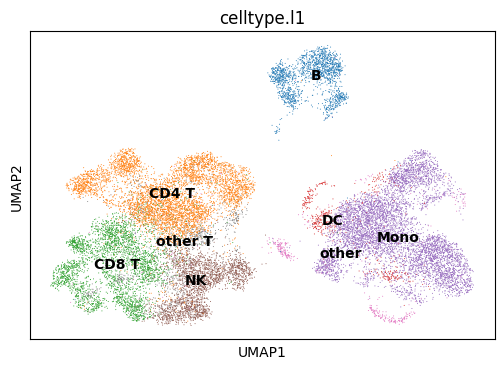

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


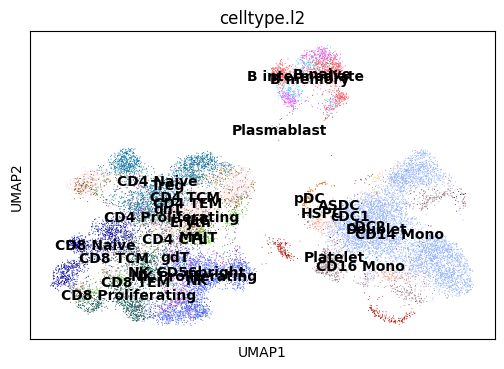

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


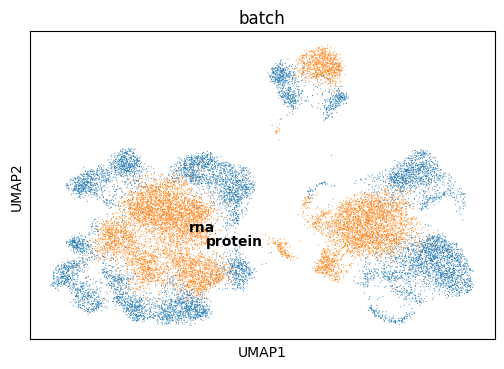

Plots for only rna


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


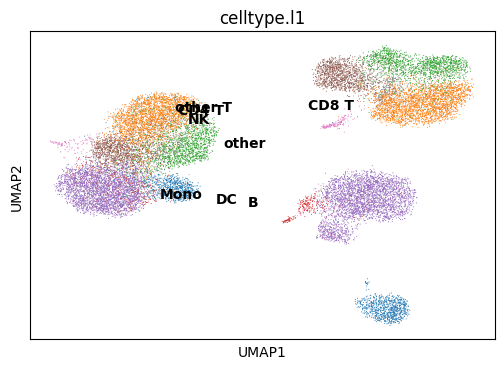

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


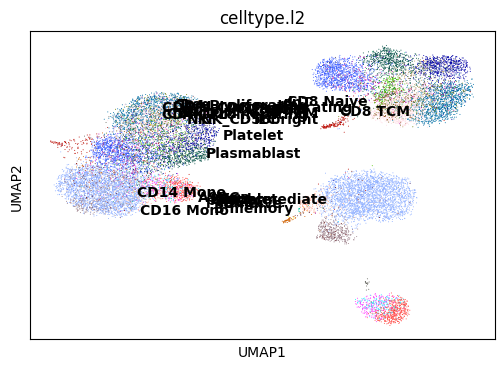

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


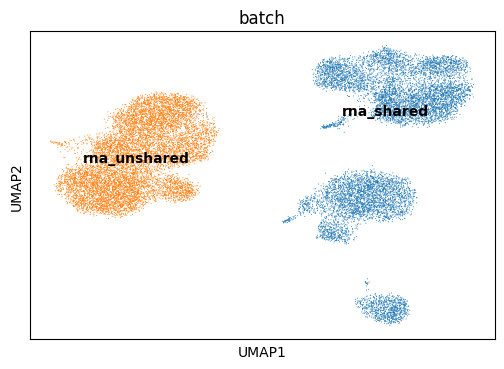

Plots for only proteins


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


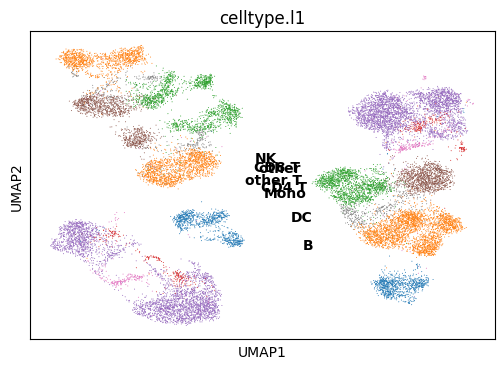

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


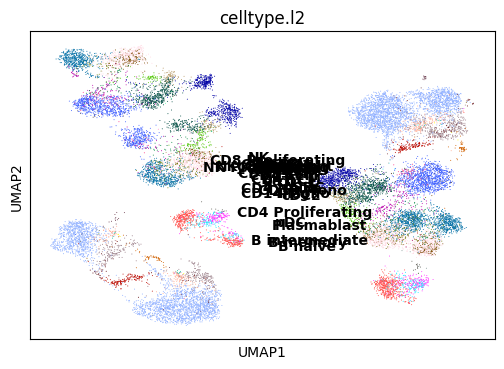

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


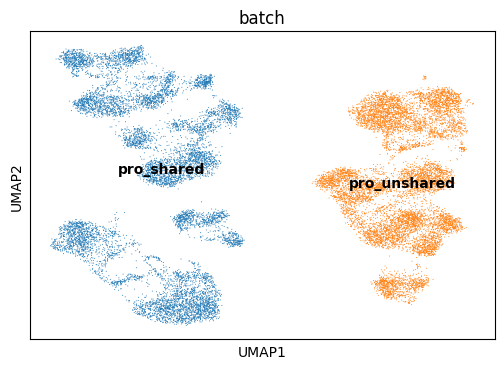

euclidean metric will be used for calculating the distance!
Start the matching process...
Computing the distance matrix...
Getting matchings by Minimum Distance...
Linear assignment completed!
For All matchings: lv1 matching acc: 0.780,
lv2 matching acc: 0.601.
For All matchings: FOSCTTM score: 0.21593023000000003, 
Knn Alignment score: [0.001  0.0022 0.0042 0.0053 0.0066 0.0082 0.0094 0.0111 0.0115 0.0119
 0.0131 0.014  0.0144 0.0154 0.0162 0.0169 0.018  0.0191 0.02   0.0209
 0.0224 0.0236 0.0243 0.0253 0.0264]
For All matchings: Silhouette F1 score for lv1: 0.5092294113190005, 
Silhouette F1 score for lv2: 0.49830973471441115



Matches are being filtered...
Matchings before filtering:  10000
Threshold distance for filtering the matchings:  4.6980485916137695
Matchings are reduced to 5000 after filtering...
For only filtered matchings: lv1 matching acc: 0.851,
lv2 matching acc: 0.698.



Matches are being propagated....
Done!
For all matchings after propagation: lv1 matching acc: 0.8

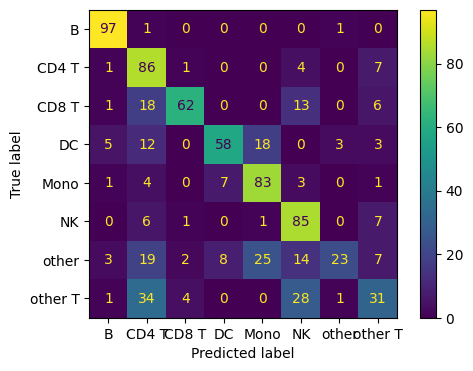

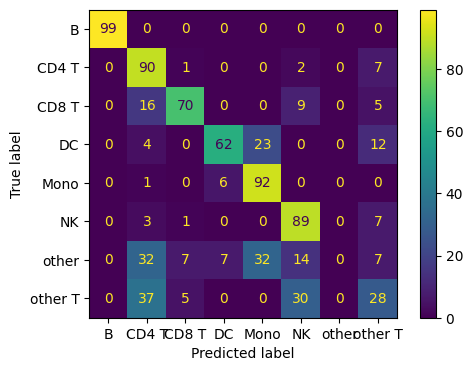

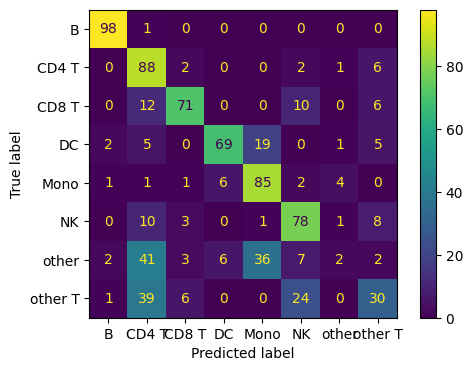

Epoch: 1210
Last discriminator loss 1: 0.5037784025073051
Last discriminator loss 2: 0.69269300699234
Last RNA reconstruction loss: 63.7951678276062
Last RNA KL divergence L: 27.86024441719055
Last RNA KL divergence Z: 139.62932624816895
Last protein reconstruction loss: 448.1824203491211
Last protein KL divergence back pro: 717.0263565063476
Last protein KL divergence Z: 139.62932624816895
Last total loss: 513.5547966003418
Epoch: 1220
Last discriminator loss 1: 0.5037276655435562
Last discriminator loss 2: 0.6928066030144692
Last RNA reconstruction loss: 63.93545274734497
Last RNA KL divergence L: 27.9911358833313
Last RNA KL divergence Z: 139.735684967041
Last protein reconstruction loss: 448.13968124389646
Last protein KL divergence back pro: 717.8585678100586
Last protein KL divergence Z: 139.735684967041
Last total loss: 513.6535316467285
Epoch: 1230
Last discriminator loss 1: 0.5036718368530273
Last discriminator loss 2: 0.6928369298577308
Last RNA reconstruction loss: 63.682939

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


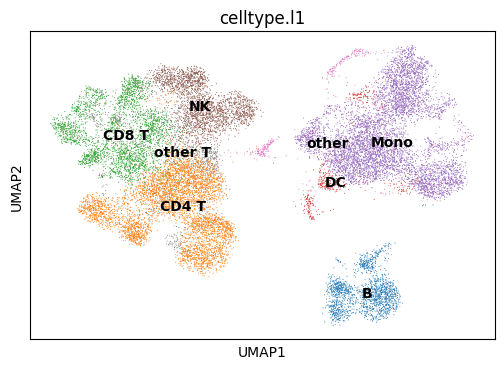

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


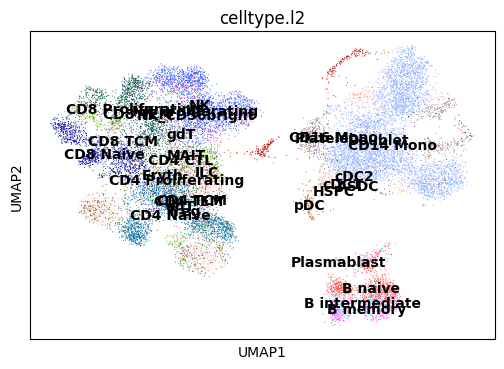

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


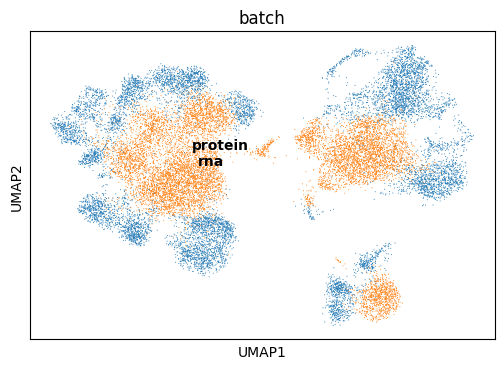

Plots for only rna


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


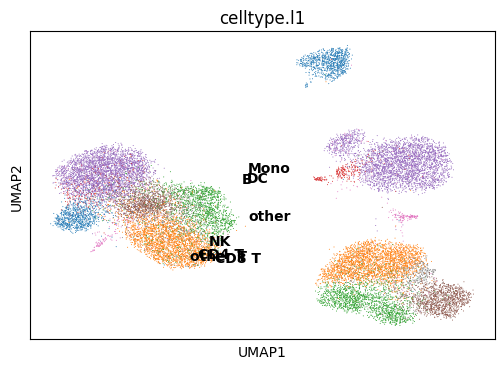

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


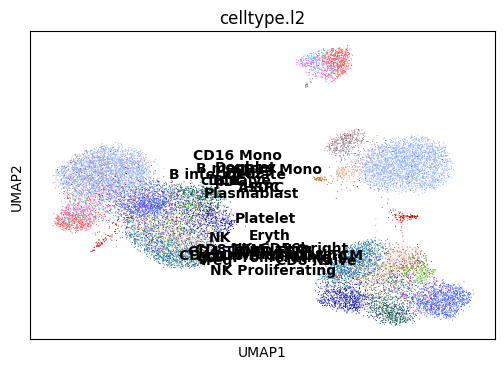

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


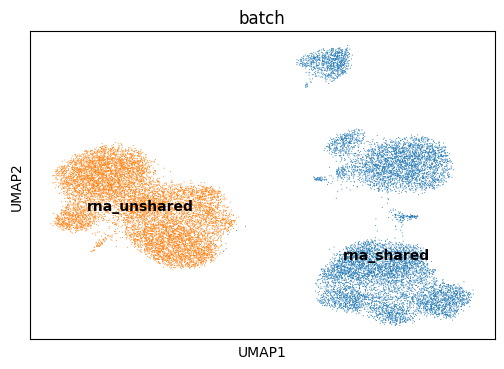

Plots for only proteins


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


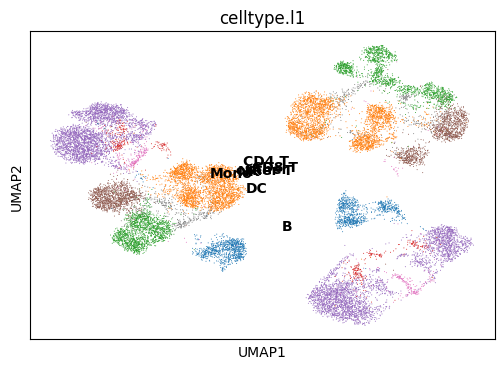

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


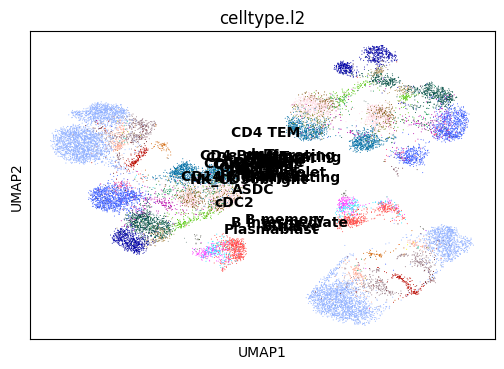

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


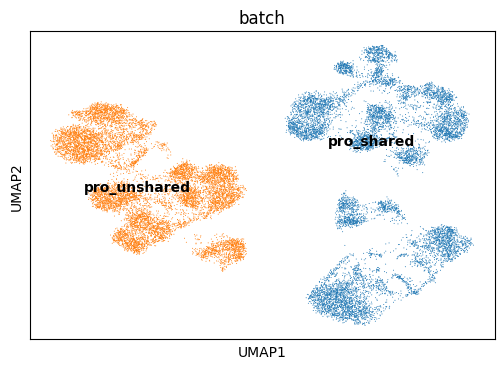

euclidean metric will be used for calculating the distance!
Start the matching process...
Computing the distance matrix...
Getting matchings by Minimum Distance...
Linear assignment completed!
For All matchings: lv1 matching acc: 0.777,
lv2 matching acc: 0.592.
For All matchings: FOSCTTM score: 0.21744912, 
Knn Alignment score: [0.001  0.0024 0.0046 0.0053 0.0062 0.007  0.0077 0.0094 0.0107 0.0114
 0.0125 0.0139 0.0146 0.0153 0.0164 0.0174 0.0181 0.0195 0.02   0.0209
 0.0216 0.0228 0.0232 0.024  0.0249]
For All matchings: Silhouette F1 score for lv1: 0.5091415454124939, 
Silhouette F1 score for lv2: 0.49778368529882083



Matches are being filtered...
Matchings before filtering:  10000
Threshold distance for filtering the matchings:  4.696975231170654
Matchings are reduced to 5000 after filtering...
For only filtered matchings: lv1 matching acc: 0.855,
lv2 matching acc: 0.687.



Matches are being propagated....
Done!
For all matchings after propagation: lv1 matching acc: 0.801,
lv2 ma

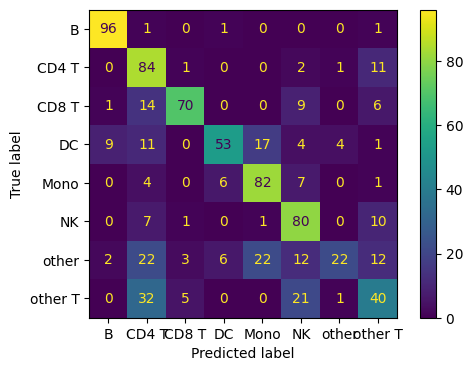

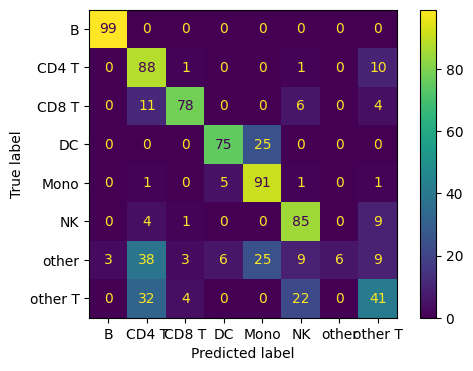

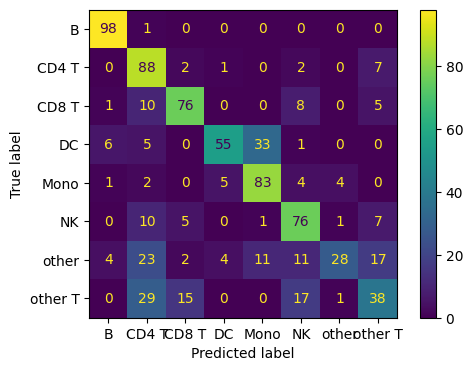

Epoch: 1310
Last discriminator loss 1: 0.5036976411938667
Last discriminator loss 2: 0.692820294201374
Last RNA reconstruction loss: 63.98366765975952
Last RNA KL divergence L: 27.784227275848387
Last RNA KL divergence Z: 139.59389457702636
Last protein reconstruction loss: 448.30952072143555
Last protein KL divergence back pro: 717.4888778686524
Last protein KL divergence Z: 139.59389457702636
Last total loss: 513.8708778381348
Epoch: 1320
Last discriminator loss 1: 0.5036885127425194
Last discriminator loss 2: 0.6928959250450134
Last RNA reconstruction loss: 63.94988594055176
Last RNA KL divergence L: 27.958197021484374
Last RNA KL divergence Z: 139.18398323059083
Last protein reconstruction loss: 448.10777893066404
Last protein KL divergence back pro: 715.5202377319335
Last protein KL divergence Z: 139.18398323059083
Last total loss: 513.6332191467285
Epoch: 1330
Last discriminator loss 1: 0.5036841452121734
Last discriminator loss 2: 0.6928181976079941
Last RNA reconstruction loss:

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


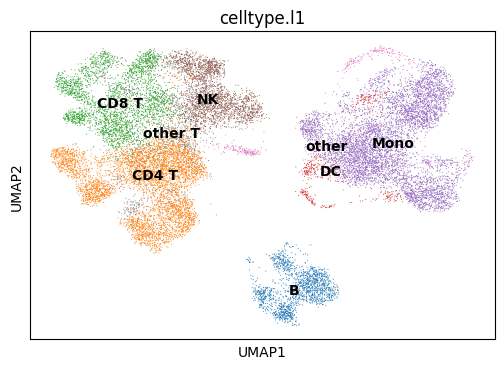

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


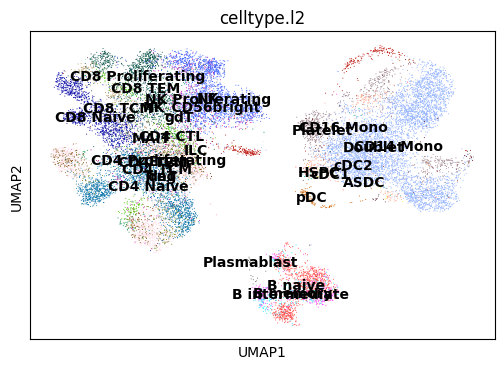

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


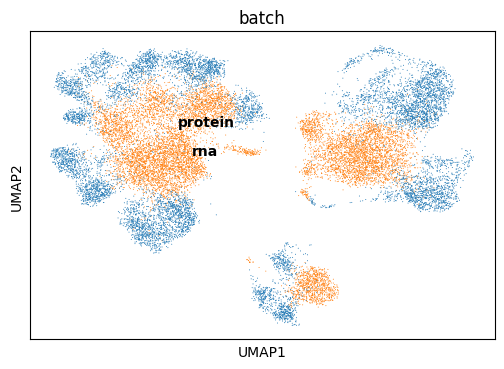

Plots for only rna


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


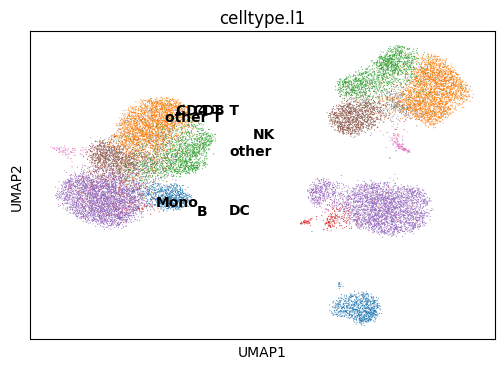

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


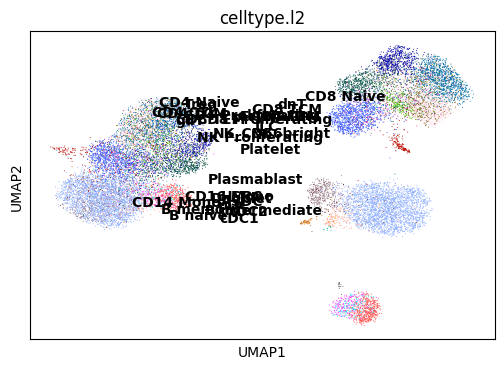

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


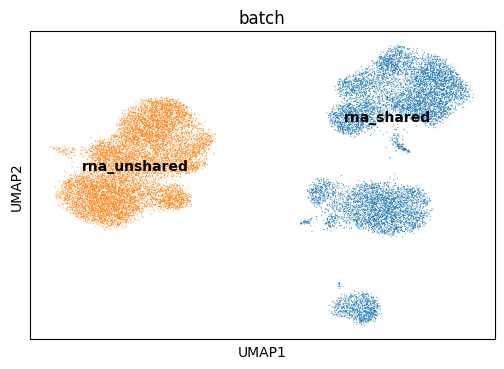

Plots for only proteins


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


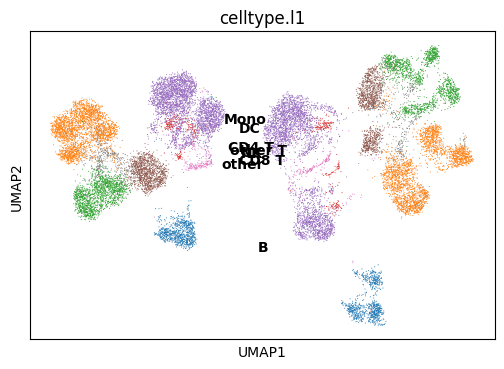

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


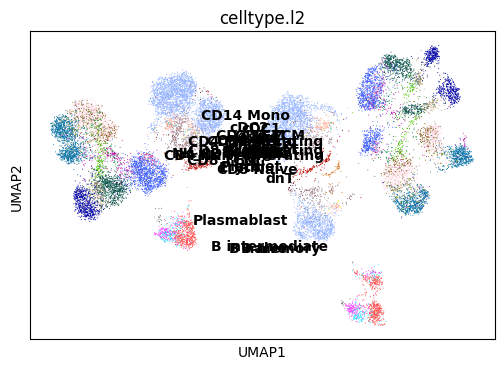

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


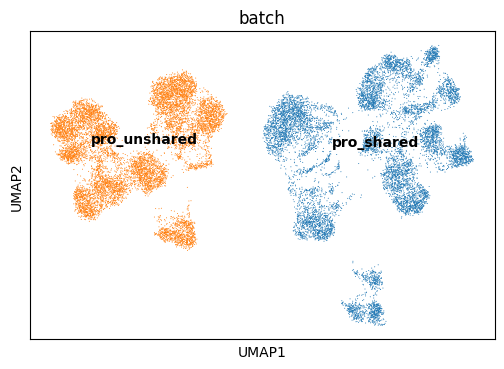

euclidean metric will be used for calculating the distance!
Start the matching process...
Computing the distance matrix...
Getting matchings by Minimum Distance...
Linear assignment completed!
For All matchings: lv1 matching acc: 0.764,
lv2 matching acc: 0.582.
For All matchings: FOSCTTM score: 0.21748124000000002, 
Knn Alignment score: [0.0012 0.0024 0.0038 0.0052 0.0063 0.007  0.008  0.0097 0.0109 0.012
 0.0129 0.0135 0.014  0.0154 0.0165 0.0171 0.0179 0.0189 0.0201 0.0211
 0.022  0.023  0.0239 0.0247 0.0259]
For All matchings: Silhouette F1 score for lv1: 0.5097203252267908, 
Silhouette F1 score for lv2: 0.49845905824091197



Matches are being filtered...
Matchings before filtering:  10000
Threshold distance for filtering the matchings:  4.668414831161499
Matchings are reduced to 5000 after filtering...
For only filtered matchings: lv1 matching acc: 0.841,
lv2 matching acc: 0.680.



Matches are being propagated....


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scipy\sparse\_index.py:143: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


Done!
For all matchings after propagation: lv1 matching acc: 0.792,
lv2 matching acc: 0.588.


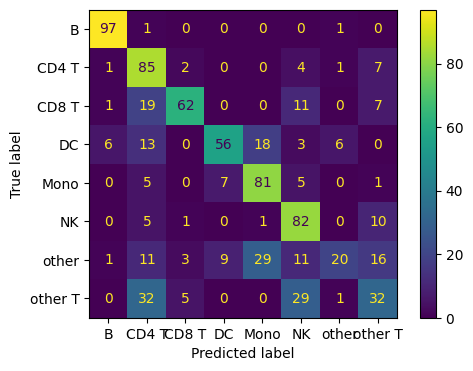

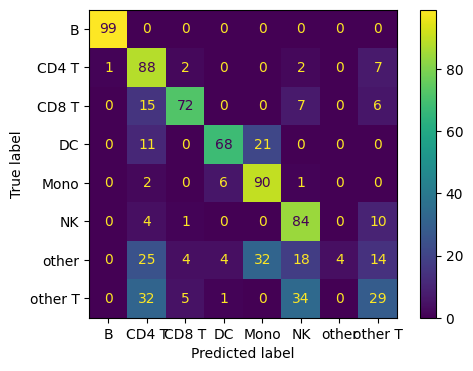

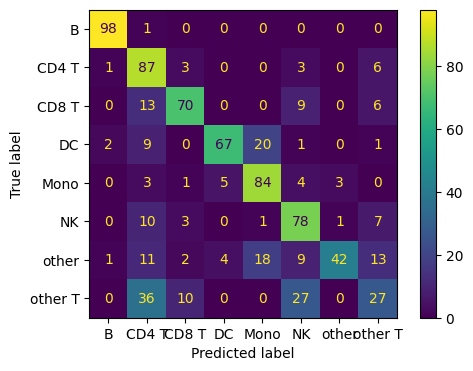

Epoch: 1410
Last discriminator loss 1: 0.5037283852696419
Last discriminator loss 2: 0.6928035616874695
Last RNA reconstruction loss: 63.31576671600342
Last RNA KL divergence L: 28.04881043434143
Last RNA KL divergence Z: 139.31297225952147
Last protein reconstruction loss: 448.7075248718262
Last protein KL divergence back pro: 718.1824264526367
Last protein KL divergence Z: 139.31297225952147
Last total loss: 513.6016387939453
Epoch: 1420
Last discriminator loss 1: 0.5036831617355346
Last discriminator loss 2: 0.6928452298045158
Last RNA reconstruction loss: 63.87384586334228
Last RNA KL divergence L: 27.926983547210693
Last RNA KL divergence Z: 139.27919845581056
Last protein reconstruction loss: 448.1249687194824
Last protein KL divergence back pro: 717.0985214233399
Last protein KL divergence Z: 139.27919845581056
Last total loss: 513.5759689331055
Epoch: 1430
Last discriminator loss 1: 0.5036340221762657
Last discriminator loss 2: 0.6928590089082718
Last RNA reconstruction loss: 6

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


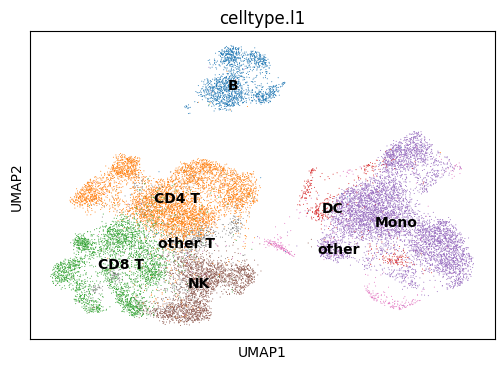

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


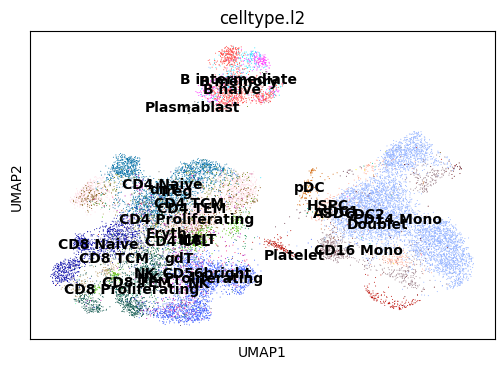

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


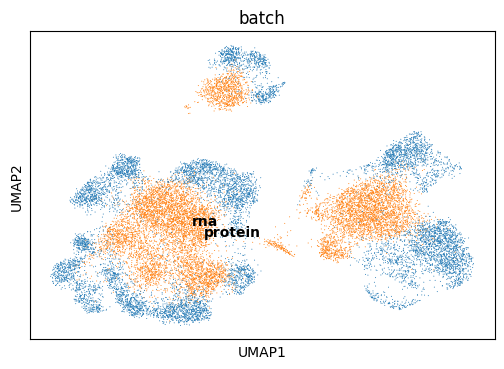

Plots for only rna


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


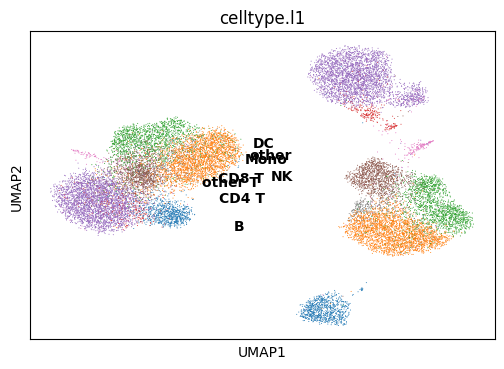

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


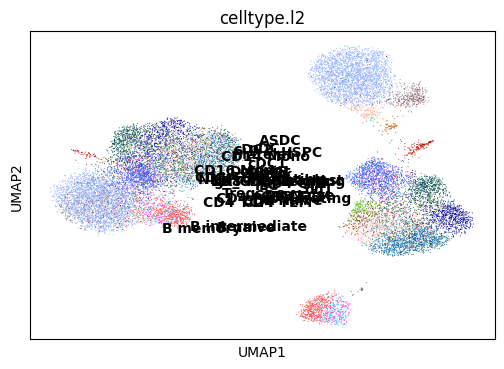

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


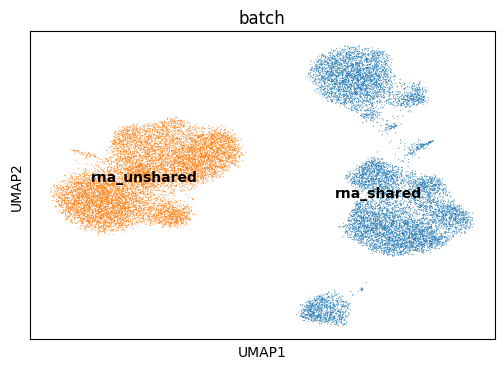

Plots for only proteins


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


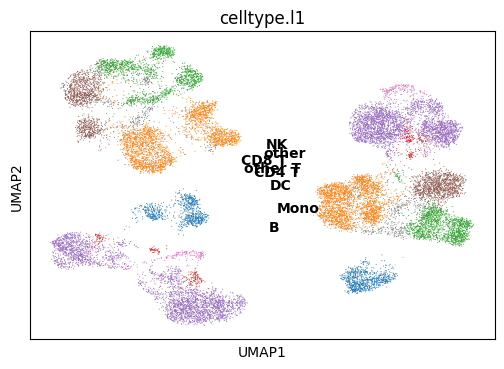

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


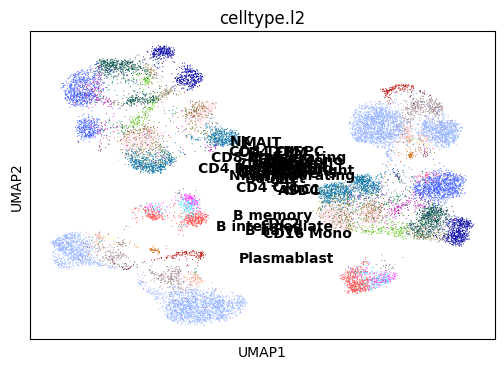

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


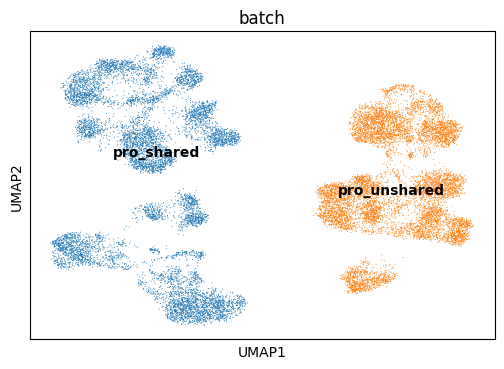

euclidean metric will be used for calculating the distance!
Start the matching process...
Computing the distance matrix...
Getting matchings by Minimum Distance...
Linear assignment completed!
For All matchings: lv1 matching acc: 0.776,
lv2 matching acc: 0.598.
For All matchings: FOSCTTM score: 0.21541145, 
Knn Alignment score: [0.002  0.0034 0.0041 0.0053 0.0062 0.0082 0.0091 0.0101 0.011  0.0119
 0.0129 0.0137 0.0142 0.0152 0.0159 0.0166 0.0178 0.0186 0.0195 0.0207
 0.0219 0.0221 0.0227 0.0231 0.0238]
For All matchings: Silhouette F1 score for lv1: 0.5100731101894158, 
Silhouette F1 score for lv2: 0.4985019116297935



Matches are being filtered...
Matchings before filtering:  10000
Threshold distance for filtering the matchings:  4.658339500427246
Matchings are reduced to 5000 after filtering...
For only filtered matchings: lv1 matching acc: 0.853,
lv2 matching acc: 0.700.



Matches are being propagated....
Done!
For all matchings after propagation: lv1 matching acc: 0.803,
lv2 mat

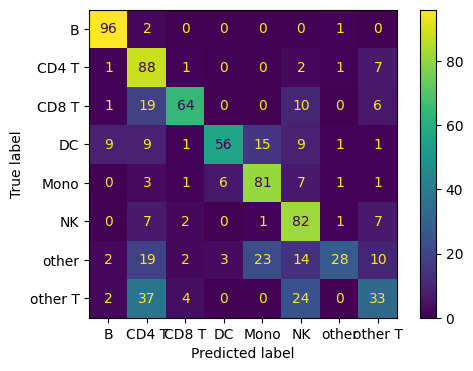

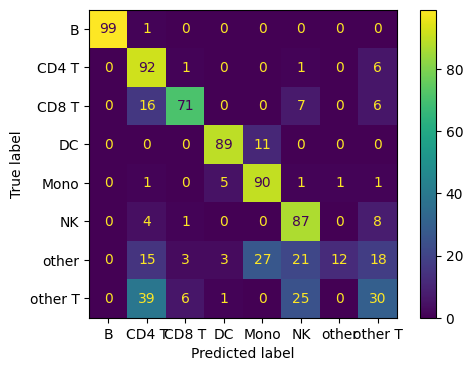

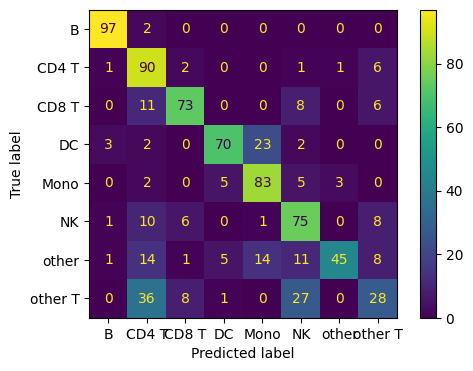

Epoch: 1510
Last discriminator loss 1: 0.5037037670612335
Last discriminator loss 2: 0.6928657099604607
Last RNA reconstruction loss: 63.70199842453003
Last RNA KL divergence L: 27.94015727043152
Last RNA KL divergence Z: 139.00723762512206
Last protein reconstruction loss: 447.21432037353514
Last protein KL divergence back pro: 714.180941772461
Last protein KL divergence Z: 139.00723762512206
Last total loss: 512.4903137207032
Epoch: 1520
Last discriminator loss 1: 0.5036795809864998
Last discriminator loss 2: 0.6928190648555755
Last RNA reconstruction loss: 63.90262384414673
Last RNA KL divergence L: 27.85602731704712
Last RNA KL divergence Z: 139.26032409667968
Last protein reconstruction loss: 447.657169342041
Last protein KL divergence back pro: 716.1297668457031
Last protein KL divergence Z: 139.26032409667968
Last total loss: 513.1358589172363
Epoch: 1530
Last discriminator loss 1: 0.5036088228225708
Last discriminator loss 2: 0.6926750794053078
Last RNA reconstruction loss: 63.

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


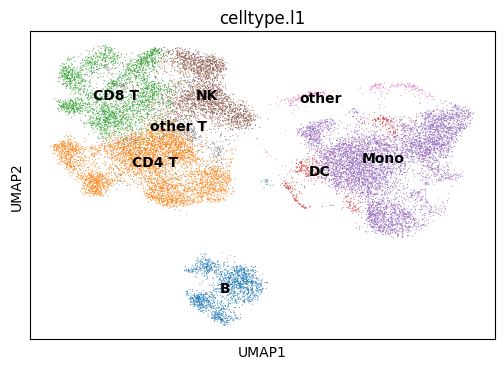

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


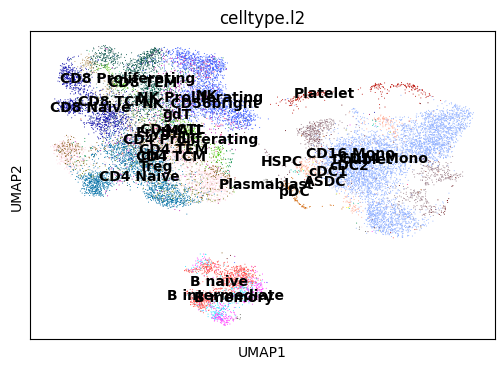

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


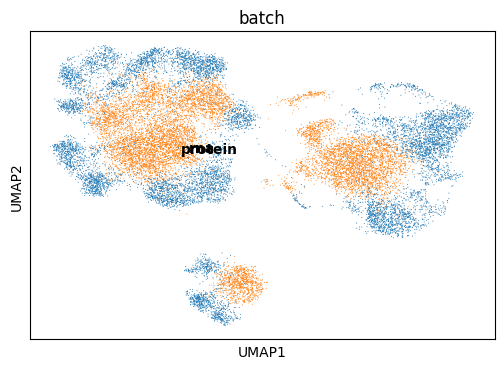

Plots for only rna


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


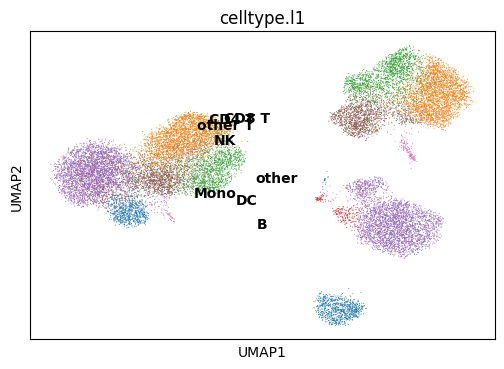

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


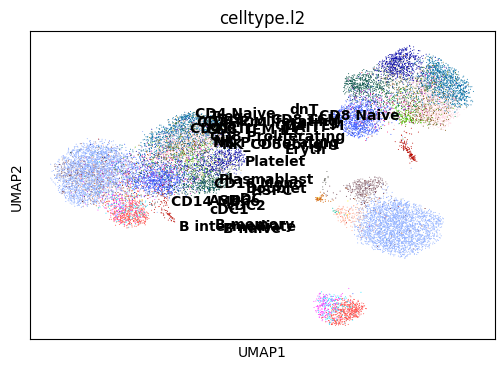

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


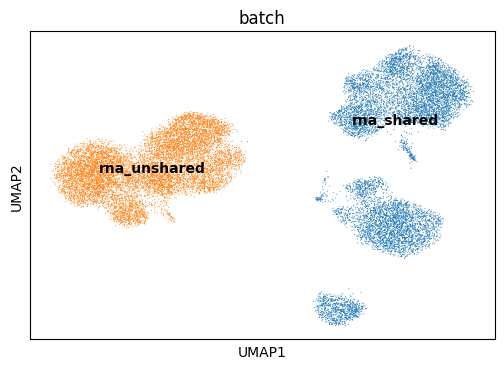

Plots for only proteins


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


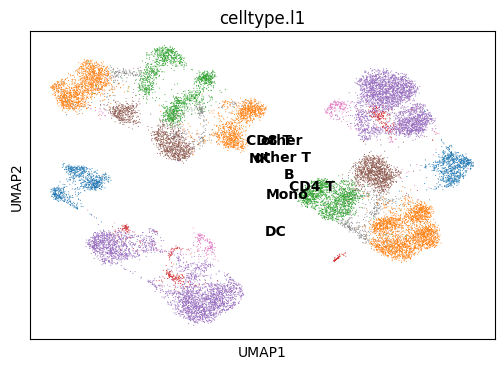

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


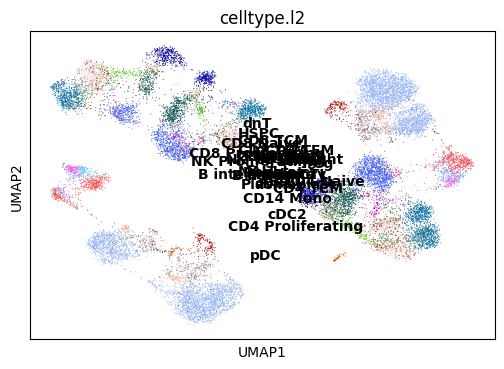

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


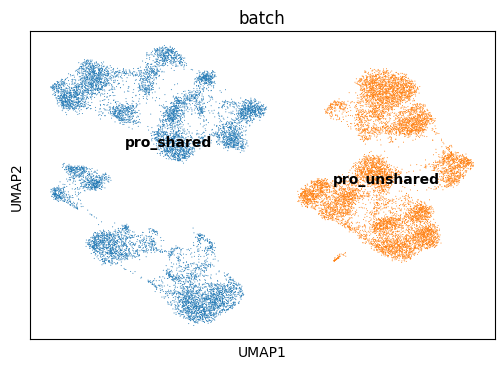

euclidean metric will be used for calculating the distance!
Start the matching process...
Computing the distance matrix...
Getting matchings by Minimum Distance...
Linear assignment completed!
For All matchings: lv1 matching acc: 0.790,
lv2 matching acc: 0.605.
For All matchings: FOSCTTM score: 0.21459229999999999, 
Knn Alignment score: [0.0011 0.0022 0.0036 0.0049 0.006  0.0067 0.0078 0.0092 0.0105 0.0116
 0.0125 0.0143 0.0149 0.016  0.017  0.0182 0.0188 0.0192 0.0196 0.0203
 0.0211 0.0218 0.0229 0.0239 0.025 ]
For All matchings: Silhouette F1 score for lv1: 0.5103895283077005, 
Silhouette F1 score for lv2: 0.49906669605246473



Matches are being filtered...
Matchings before filtering:  10000
Threshold distance for filtering the matchings:  4.626798152923584
Matchings are reduced to 5000 after filtering...
For only filtered matchings: lv1 matching acc: 0.859,
lv2 matching acc: 0.692.



Matches are being propagated....
Done!
For all matchings after propagation: lv1 matching acc: 0.79

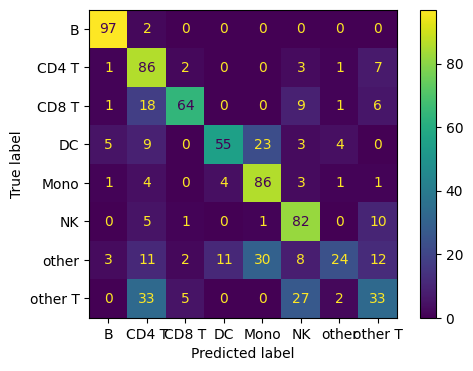

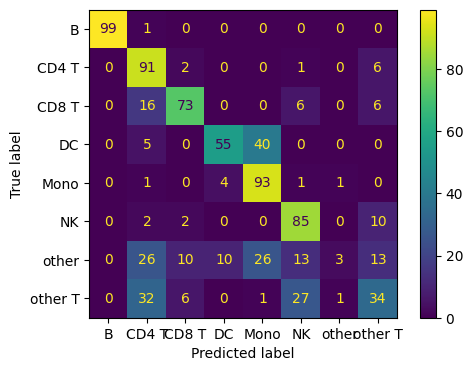

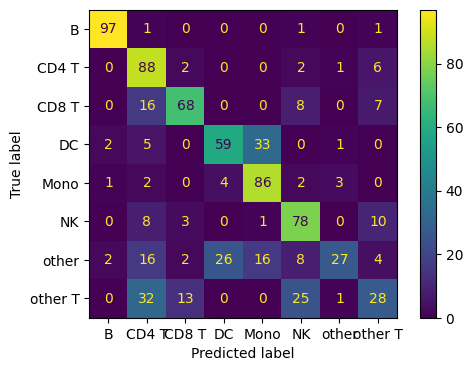

Epoch: 1610
Last discriminator loss 1: 0.5037054210901261
Last discriminator loss 2: 0.6928362160921097
Last RNA reconstruction loss: 63.61319646835327
Last RNA KL divergence L: 27.91654691696167
Last RNA KL divergence Z: 138.94331436157228
Last protein reconstruction loss: 447.5512809753418
Last protein KL divergence back pro: 714.3617340087891
Last protein KL divergence Z: 138.94331436157228
Last total loss: 512.7385406494141
Epoch: 1620
Last discriminator loss 1: 0.5036685153841972
Last discriminator loss 2: 0.6929144948720932
Last RNA reconstruction loss: 63.58201789855957
Last RNA KL divergence L: 27.9703453540802
Last RNA KL divergence Z: 139.06996154785156
Last protein reconstruction loss: 447.4382064819336
Last protein KL divergence back pro: 716.6328048706055
Last protein KL divergence Z: 139.06996154785156
Last total loss: 512.5968101501464
Epoch: 1630
Last discriminator loss 1: 0.5037459015846253
Last discriminator loss 2: 0.6929328471422196
Last RNA reconstruction loss: 63.

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


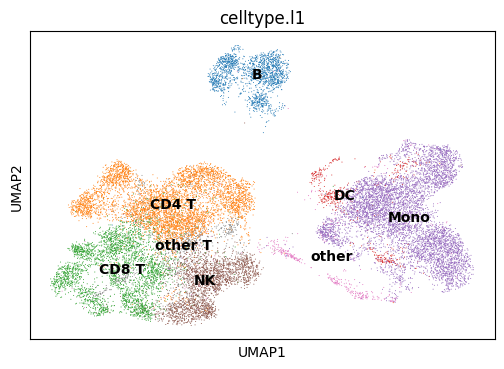

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


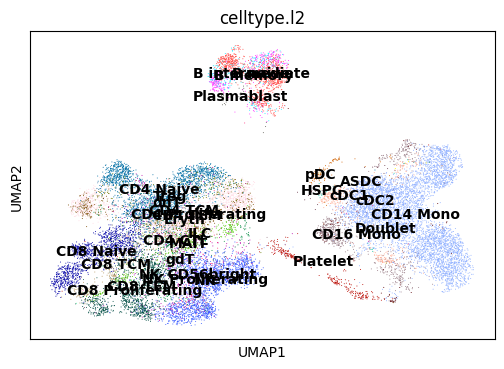

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


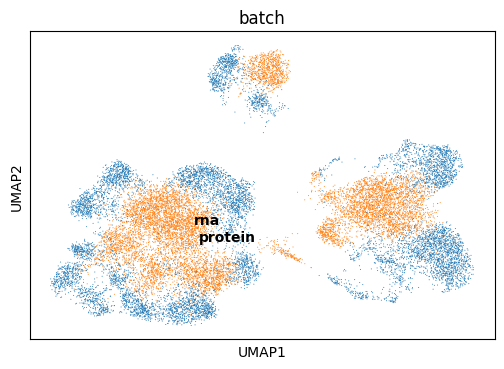

Plots for only rna


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


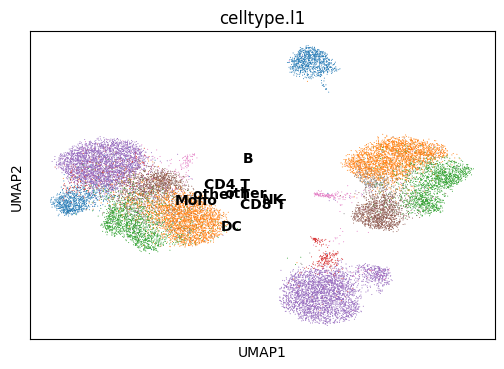

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


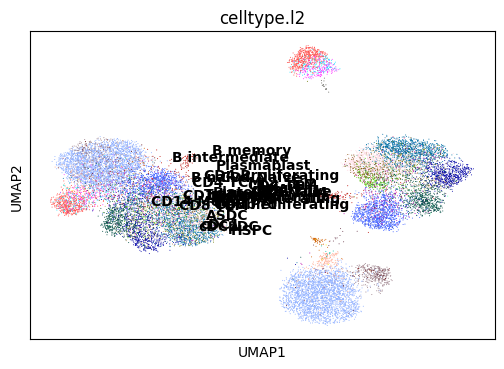

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


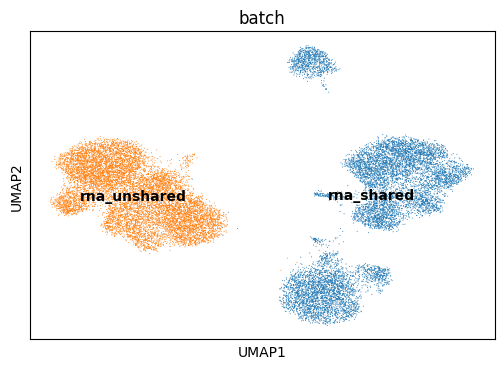

Plots for only proteins


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


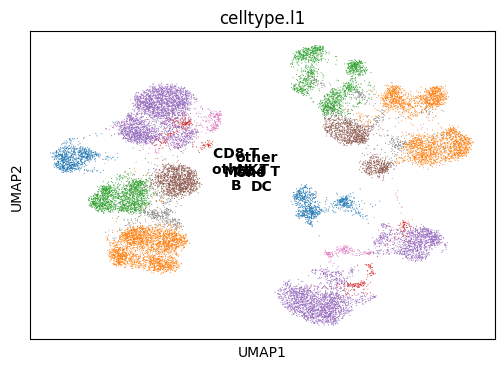

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


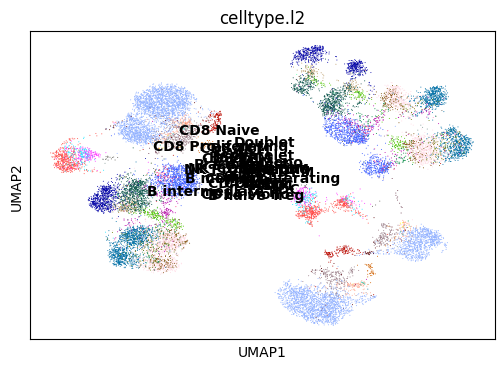

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


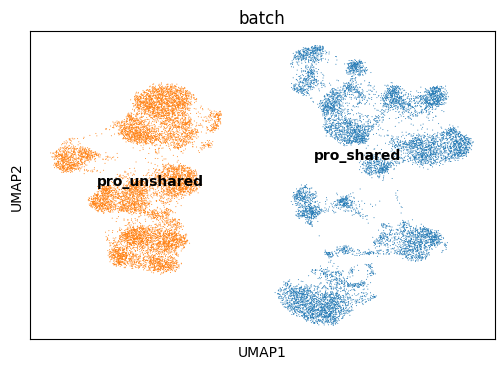

euclidean metric will be used for calculating the distance!
Start the matching process...
Computing the distance matrix...
Getting matchings by Minimum Distance...
Linear assignment completed!
For All matchings: lv1 matching acc: 0.770,
lv2 matching acc: 0.588.
For All matchings: FOSCTTM score: 0.21500636, 
Knn Alignment score: [0.0008 0.0028 0.0044 0.0055 0.0072 0.0082 0.0094 0.0103 0.0114 0.0125
 0.0134 0.0141 0.0153 0.0168 0.0176 0.0182 0.0195 0.0205 0.0215 0.0226
 0.024  0.0248 0.0258 0.0261 0.027 ]
For All matchings: Silhouette F1 score for lv1: 0.5105374159180526, 
Silhouette F1 score for lv2: 0.49908001442313155



Matches are being filtered...
Matchings before filtering:  10000
Threshold distance for filtering the matchings:  4.614518880844116
Matchings are reduced to 5000 after filtering...
For only filtered matchings: lv1 matching acc: 0.851,
lv2 matching acc: 0.687.



Matches are being propagated....
Done!
For all matchings after propagation: lv1 matching acc: 0.788,
lv2 ma

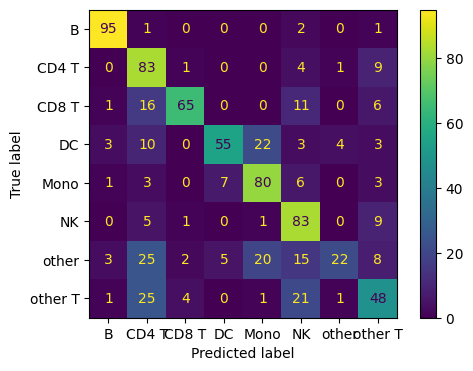

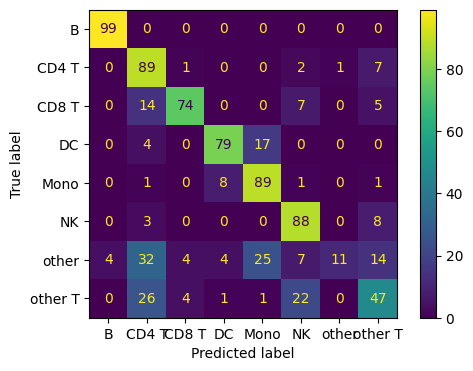

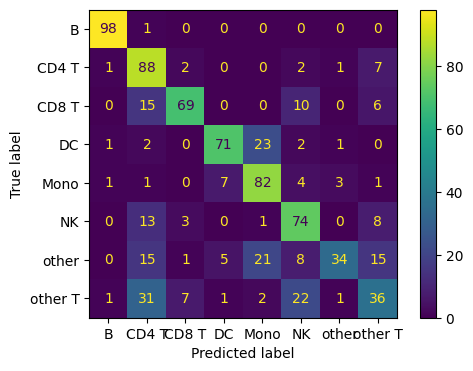

Epoch: 1710
Last discriminator loss 1: 0.5038029819726944
Last discriminator loss 2: 0.6927880316972732
Last RNA reconstruction loss: 63.70388441085815
Last RNA KL divergence L: 27.897583341598512
Last RNA KL divergence Z: 138.9268684387207
Last protein reconstruction loss: 447.6348762512207
Last protein KL divergence back pro: 715.4251159667969
Last protein KL divergence Z: 138.9268684387207
Last total loss: 512.9138000488281
Epoch: 1720
Last discriminator loss 1: 0.5036991491913796
Last discriminator loss 2: 0.6928590908646584
Last RNA reconstruction loss: 63.80079193115235
Last RNA KL divergence L: 27.95659456253052
Last RNA KL divergence Z: 139.0093074798584
Last protein reconstruction loss: 447.7645973205566
Last protein KL divergence back pro: 715.4723114013672
Last protein KL divergence Z: 139.0093074798584
Last total loss: 513.1406875610352
Epoch: 1730
Last discriminator loss 1: 0.503630892932415
Last discriminator loss 2: 0.6927894786000252
Last RNA reconstruction loss: 63.560

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


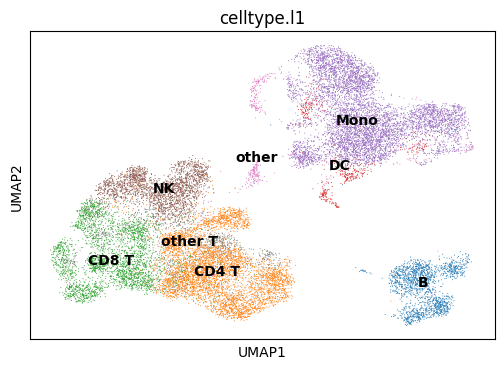

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


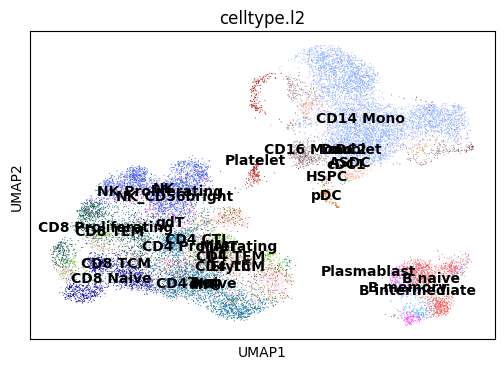

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


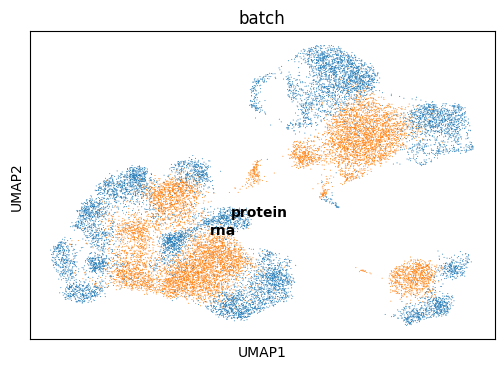

Plots for only rna


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


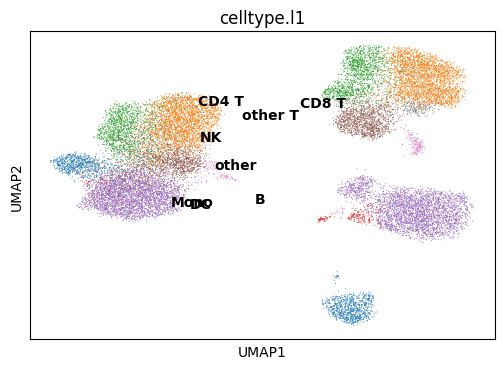

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


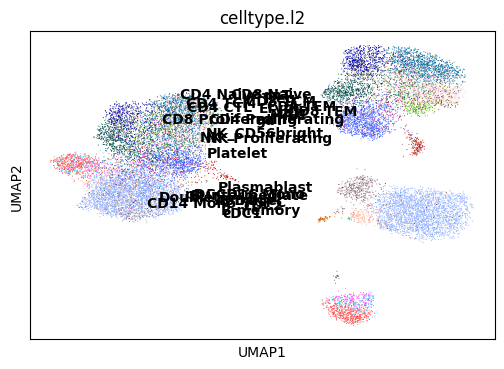

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


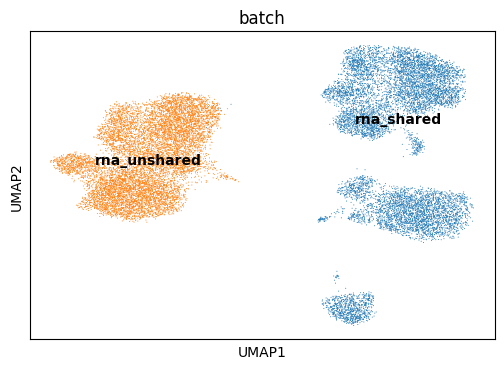

Plots for only proteins


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


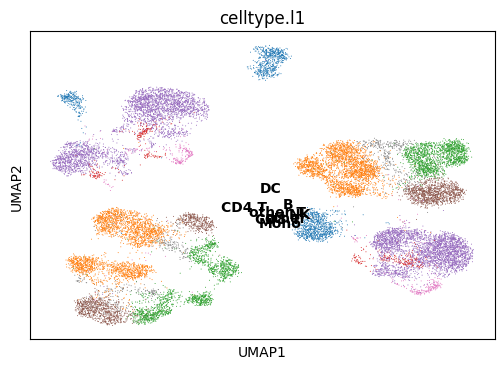

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


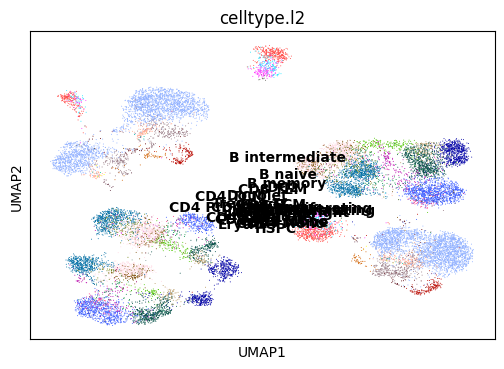

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


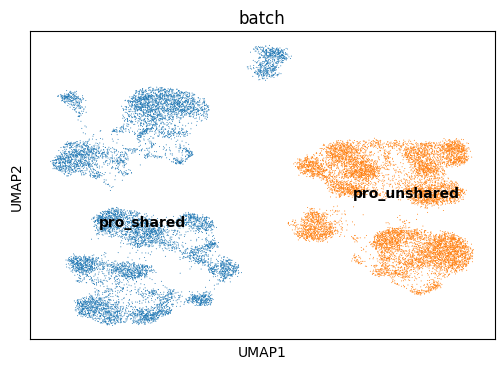

euclidean metric will be used for calculating the distance!
Start the matching process...
Computing the distance matrix...
Getting matchings by Minimum Distance...
Linear assignment completed!
For All matchings: lv1 matching acc: 0.775,
lv2 matching acc: 0.590.
For All matchings: FOSCTTM score: 0.21473563999999998, 
Knn Alignment score: [0.0011 0.0015 0.003  0.0046 0.0062 0.0079 0.0087 0.0093 0.0103 0.0118
 0.013  0.0146 0.0158 0.0166 0.0177 0.0189 0.0196 0.0198 0.0206 0.0211
 0.0222 0.0228 0.0234 0.0239 0.025 ]
For All matchings: Silhouette F1 score for lv1: 0.5104018508664262, 
Silhouette F1 score for lv2: 0.4991698660979557



Matches are being filtered...
Matchings before filtering:  10000
Threshold distance for filtering the matchings:  4.644261121749878
Matchings are reduced to 5000 after filtering...
For only filtered matchings: lv1 matching acc: 0.854,
lv2 matching acc: 0.688.



Matches are being propagated....


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scipy\sparse\_index.py:143: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


Done!
For all matchings after propagation: lv1 matching acc: 0.805,
lv2 matching acc: 0.594.


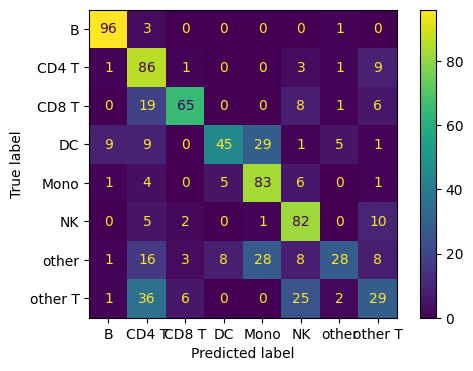

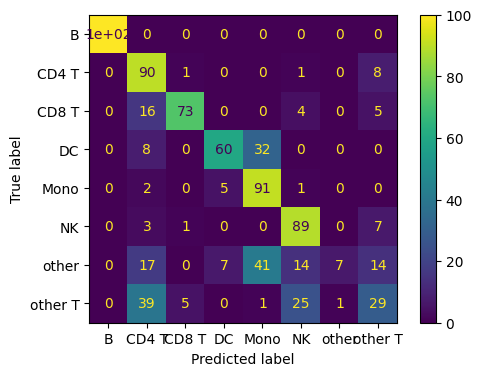

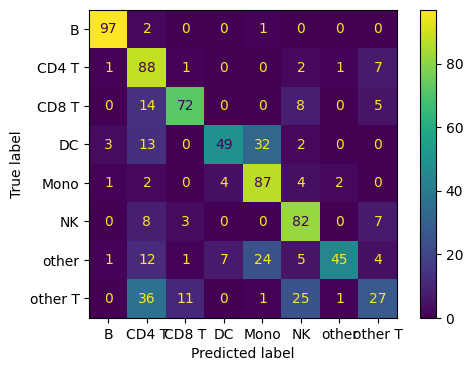

Epoch: 1810
Last discriminator loss 1: 0.5035920321941376
Last discriminator loss 2: 0.692851436138153
Last RNA reconstruction loss: 63.54508829116821
Last RNA KL divergence L: 28.057286405563353
Last RNA KL divergence Z: 139.06406745910644
Last protein reconstruction loss: 447.5375915527344
Last protein KL divergence back pro: 715.8660324096679
Last protein KL divergence Z: 139.06406745910644
Last total loss: 512.6585136413574
Epoch: 1820
Last discriminator loss 1: 0.5036287382245064
Last discriminator loss 2: 0.6928025007247924
Last RNA reconstruction loss: 63.67509050369263
Last RNA KL divergence L: 27.839934968948363
Last RNA KL divergence Z: 138.9712329864502
Last protein reconstruction loss: 447.3431060791016
Last protein KL divergence back pro: 714.7403793334961
Last protein KL divergence Z: 138.9712329864502
Last total loss: 512.5925537109375
Epoch: 1830
Last discriminator loss 1: 0.5037051096558571
Last discriminator loss 2: 0.6929074183106423
Last RNA reconstruction loss: 63.

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


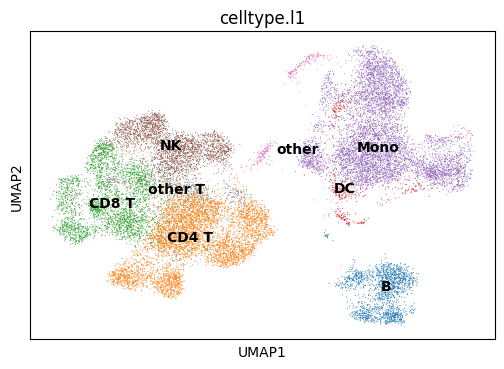

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


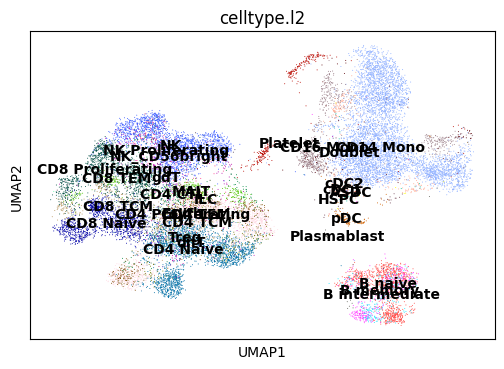

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


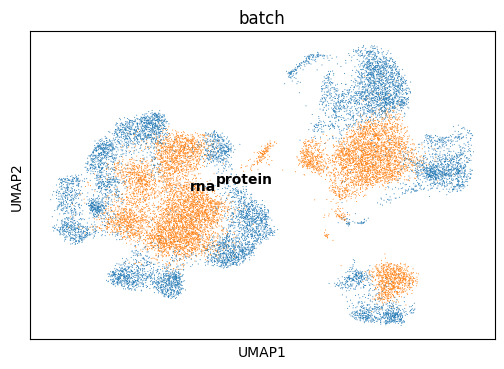

Plots for only rna


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


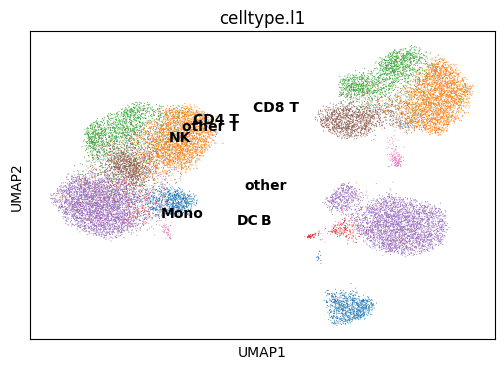

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


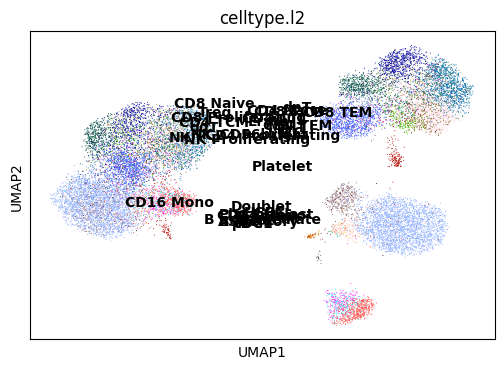

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


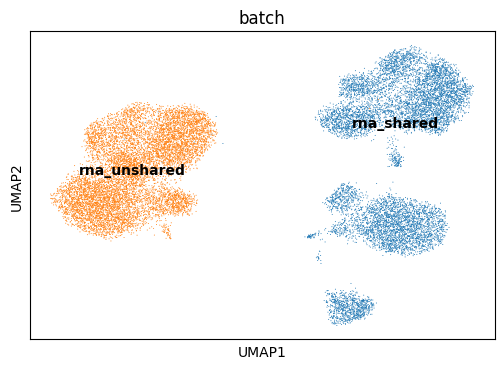

Plots for only proteins


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


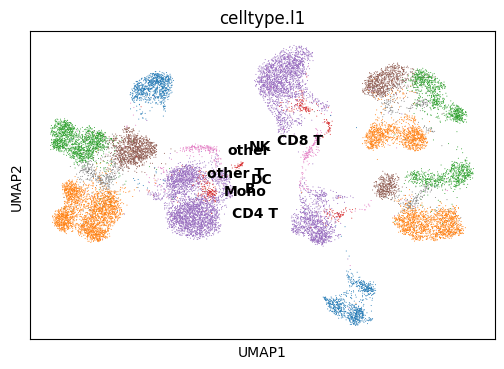

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


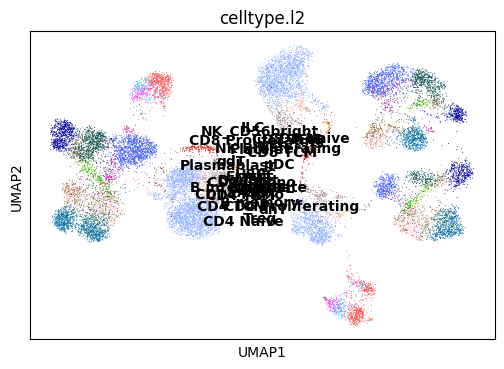

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


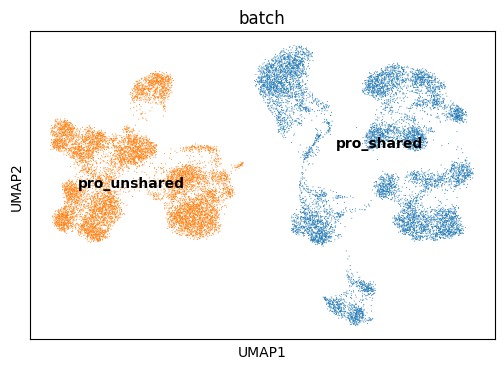

euclidean metric will be used for calculating the distance!
Start the matching process...
Computing the distance matrix...
Getting matchings by Minimum Distance...
Linear assignment completed!
For All matchings: lv1 matching acc: 0.783,
lv2 matching acc: 0.604.
For All matchings: FOSCTTM score: 0.21603136, 
Knn Alignment score: [0.0011 0.0029 0.0044 0.0056 0.0066 0.0079 0.0091 0.0104 0.0117 0.013
 0.0142 0.0149 0.0159 0.0168 0.0181 0.0191 0.0206 0.0215 0.0225 0.0233
 0.0244 0.025  0.0265 0.0273 0.0279]
For All matchings: Silhouette F1 score for lv1: 0.5103804890304214, 
Silhouette F1 score for lv2: 0.4995084721869562



Matches are being filtered...
Matchings before filtering:  10000
Threshold distance for filtering the matchings:  4.640114068984985
Matchings are reduced to 5000 after filtering...
For only filtered matchings: lv1 matching acc: 0.862,
lv2 matching acc: 0.705.



Matches are being propagated....


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scipy\sparse\_index.py:143: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


Done!
For all matchings after propagation: lv1 matching acc: 0.802,
lv2 matching acc: 0.598.


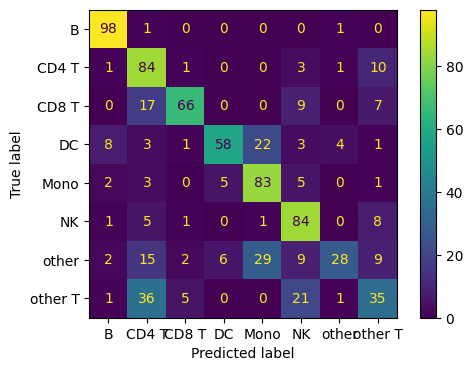

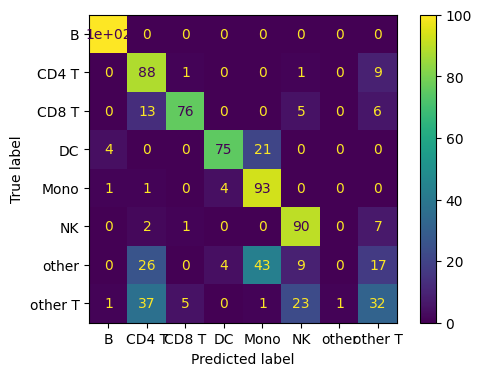

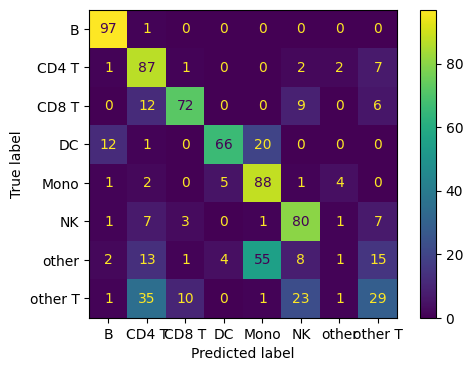

Epoch: 1910
Last discriminator loss 1: 0.5036429256200791
Last discriminator loss 2: 0.6929005518555641
Last RNA reconstruction loss: 63.54348182678223
Last RNA KL divergence L: 28.015370655059815
Last RNA KL divergence Z: 138.80213088989257
Last protein reconstruction loss: 448.0695426940918
Last protein KL divergence back pro: 714.5929779052734
Last protein KL divergence Z: 138.80213088989257
Last total loss: 513.187336730957
Epoch: 1920
Last discriminator loss 1: 0.5036689192056656
Last discriminator loss 2: 0.6928311005234719
Last RNA reconstruction loss: 63.89761915206909
Last RNA KL divergence L: 27.960440921783448
Last RNA KL divergence Z: 138.9497585296631
Last protein reconstruction loss: 447.93495864868163
Last protein KL divergence back pro: 715.1144180297852
Last protein KL divergence Z: 138.9497585296631
Last total loss: 513.4074394226075
Epoch: 1930
Last discriminator loss 1: 0.5036073520779609
Last discriminator loss 2: 0.6928686887025833
Last RNA reconstruction loss: 63

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


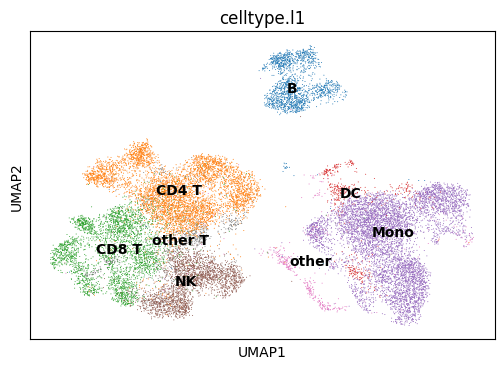

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


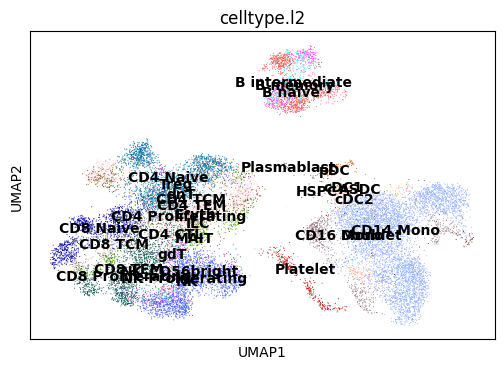

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


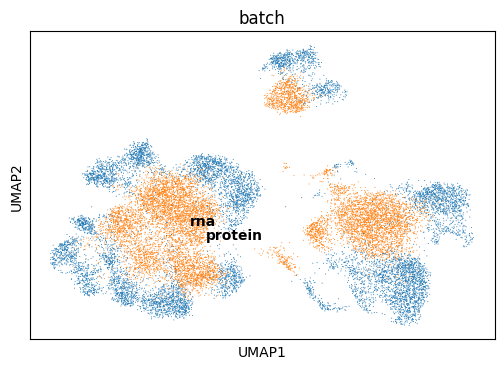

Plots for only rna


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


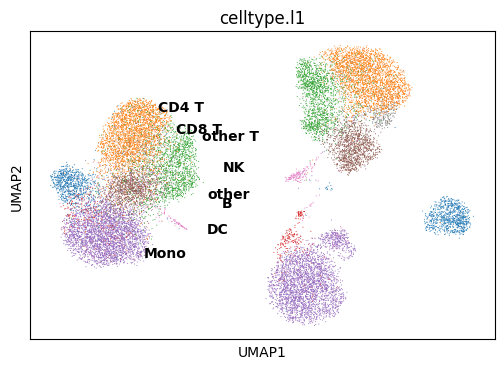

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


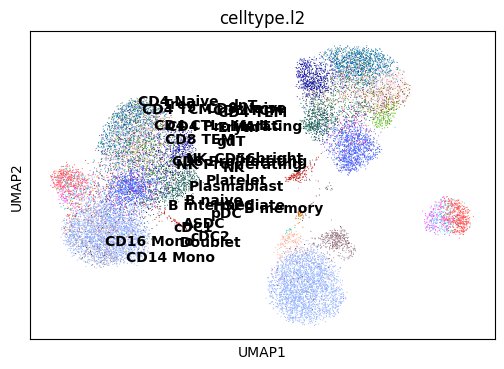

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


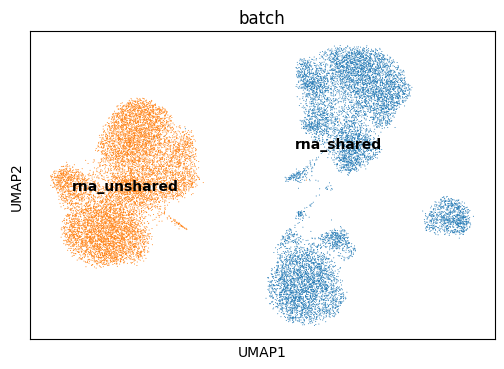

Plots for only proteins


C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


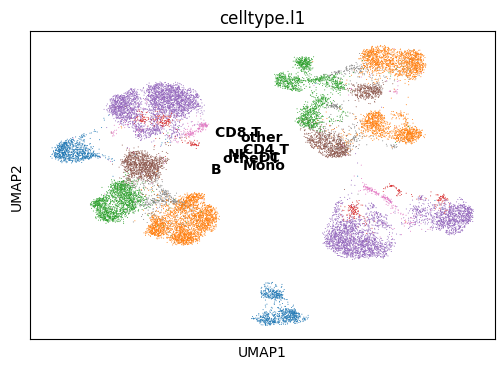

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


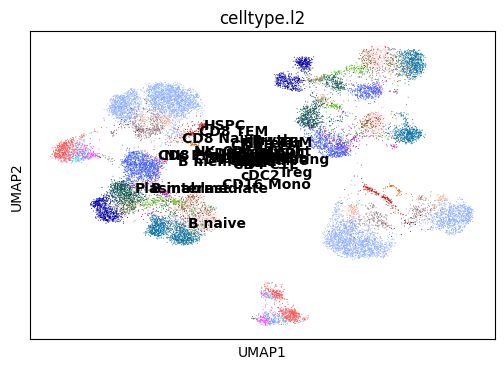

C:\Users\vinee\miniconda3\envs\scvi\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


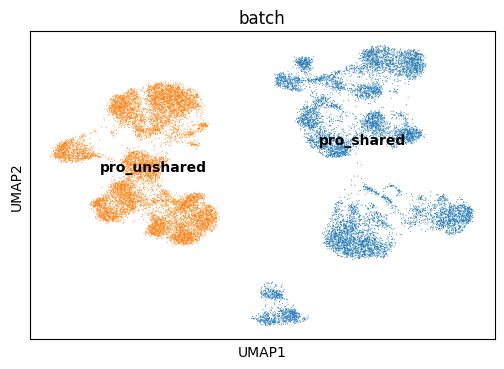

euclidean metric will be used for calculating the distance!
Start the matching process...
Computing the distance matrix...
Getting matchings by Minimum Distance...
Linear assignment completed!
For All matchings: lv1 matching acc: 0.773,
lv2 matching acc: 0.596.
For All matchings: FOSCTTM score: 0.21483410000000003, 
Knn Alignment score: [0.0015 0.0022 0.0034 0.0051 0.0063 0.0076 0.0089 0.0095 0.0105 0.012
 0.013  0.0144 0.0152 0.0161 0.0174 0.0185 0.0197 0.0205 0.0212 0.0221
 0.0233 0.0241 0.0248 0.0255 0.0258]
For All matchings: Silhouette F1 score for lv1: 0.5106088490640487, 
Silhouette F1 score for lv2: 0.49943458232937266



Matches are being filtered...
Matchings before filtering:  10000
Threshold distance for filtering the matchings:  4.633249044418335
Matchings are reduced to 5000 after filtering...
For only filtered matchings: lv1 matching acc: 0.850,
lv2 matching acc: 0.693.



Matches are being propagated....
Done!
For all matchings after propagation: lv1 matching acc: 0.798

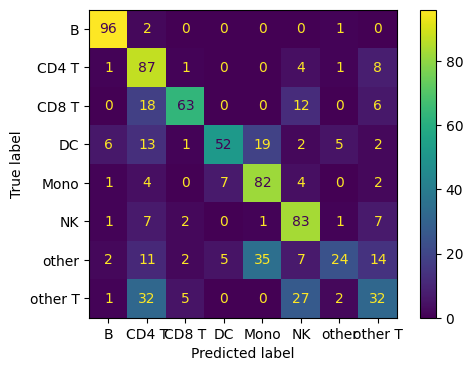

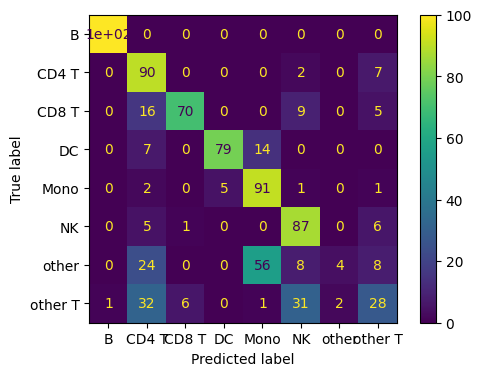

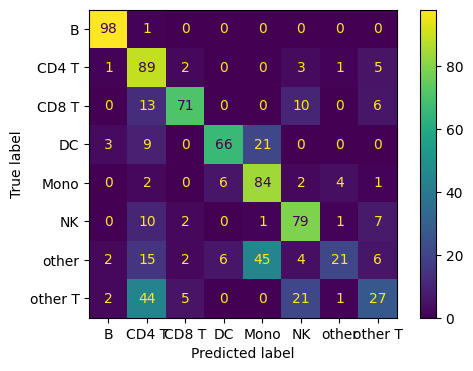

In [20]:
import warnings

# Ignore FutureWarnings
warnings.simplefilter(action='ignore', category=FutureWarning)
kl_weight = 0.0
metrics = {
    'original': {
        'lv1_acc': [],
        'lv2_acc': [],
        'foscttm_score': []
    },
    'filtered':{
        'lv1_acc': [],
        'lv2_acc': [],
        'foscttm_score': []
    },
    'propagated':{
        'lv1_acc': [],
        'lv2_acc': [],
        'foscttm_score': []
    }
}

dloss1 = []
dloss2 = []
rna_recon_loss = []
rna_kl_div_l = []
rna_kl_div_z = []
pro_recon_loss = []
pro_kl_div_back_pro = []
pro_kl_div_z = []
loss_total = []
for epoch in range(2001):
    dloss1_per_iter = []
    dloss2_per_iter = []
    loss_total_piter = []
    rna_recon_loss_piter = []
    rna_kl_div_l_piter = []
    rna_kl_div_z_piter = []
    pro_recon_loss_piter = []
    pro_kl_div_back_pro_piter = []
    pro_kl_div_z_piter = []
    
    for batchr, batchp in zip(rna_dataloader, protein_dataloader):
        optimizer_p.zero_grad()
        optimizer_r.zero_grad()
        optimizer_pr.zero_grad()
        optimizer_d.zero_grad()
        
        y_shared = batchp["y_shared"].to(device)
        x_shared = batchr["x_shared"].to(device)
        # y_unshared = batchp["y_unshared"].to(device)
        # x_unshared = batchr["x_unshared"].to(device)
        y_unshared = torch.cat([batchp["y_unshared"],batchp["y_shared"]], dim=1).to(device)
        x_unshared = torch.cat([batchr["x_unshared"],batchr["x_shared"]], dim=1).to(device)
        x_batch = batchr["batch"].to(device)
        y_batch = batchp["batch"].to(device)
        local_mean = batchr["mean"].to(device)
        local_var = batchr["var"].to(device)
        
        gene_size = x_shared.size(0)
        
        # For some iterations only train the discriminator (~10 epochs)
        with torch.no_grad():
            _, _, _, real_pro_embeddings, _ = podel(y_unshared, cross_inf=False)
            _, _, _, real_rna_embeddings, _ = rodel(x_unshared,local_mean,local_var, cross_inf=False)
            _, _, _, _, _, fake_rna_embeddings, fake_pro_embeddings, _ = prodel(x_shared,y_shared,local_mean,local_var,x_batch,y_batch, cross_inf = False)
        # generate labels
        real_labels = torch.ones(real_pro_embeddings.size(0) + real_rna_embeddings.size(0), 1).to(device)
        fake_labels = torch.zeros(fake_pro_embeddings.size(0) + fake_rna_embeddings.size(0), 1).to(device)

        discriminator_input = torch.cat((real_rna_embeddings, real_pro_embeddings, fake_rna_embeddings, fake_pro_embeddings), dim=0)
        labels = torch.cat((real_labels, fake_labels), dim=0)

        # Forward pass through discriminator
        discriminator_output = discriminator(discriminator_input)
        # Calculate discriminator loss
        d_loss = criterion(discriminator_output, labels)
        # Backward pass and optimize
        d_loss.backward()
        optimizer_d.step()
        
        dloss1_per_iter.append(d_loss.item())
            
        # After that train both the networks in a teacher student fashion
        if epoch > 10:
            # forward pass of shared_network
            reconst_loss_gene, reconst_loss_protein, kl_div_z, kl_div_l_gene, kl_div_back_pro, fake_rna_embeddings, fake_pro_embeddings, _ = prodel(x_shared,y_shared,local_mean,local_var,x_batch,y_batch, cross_inf=False)
            
            # generate labels
            fake_labels = torch.ones(fake_pro_embeddings.size(0) + fake_rna_embeddings.size(0), 1).to(device)
            discriminator_input = torch.cat((fake_rna_embeddings, fake_pro_embeddings), dim=0)
            with torch.no_grad():
                # Forward pass through discriminator
                discriminator_output = discriminator(discriminator_input)
            # Calculate discriminator loss
            d_loss = criterion(discriminator_output, fake_labels)
            # Backward pass and optimize
            shared_loss = torch.mean(reconst_loss_gene) + torch.mean(reconst_loss_protein) + 0.001*torch.mean(kl_div_z) + 0.001*torch.mean(kl_div_l_gene) + 0.001*torch.mean(kl_div_back_pro)
            loss = d_loss + shared_loss
            loss.backward()
            optimizer_pr.step()
            
            rna_recon_loss_piter.append(torch.mean(reconst_loss_gene).item())
            rna_kl_div_l_piter.append(torch.mean(kl_div_l_gene).item())
            rna_kl_div_z_piter.append(torch.mean(kl_div_z).item())
            pro_recon_loss_piter.append(torch.mean(reconst_loss_protein).item())
            pro_kl_div_back_pro_piter.append(torch.mean(kl_div_back_pro).item())
            pro_kl_div_z_piter.append(torch.mean(kl_div_z).item())
            dloss2_per_iter.append(d_loss.item())
            loss_total_piter.append(loss.item())
            
    if epoch > 10:
        dloss1.append(np.mean(dloss1_per_iter))
        dloss2.append(np.mean(dloss2_per_iter))
        rna_recon_loss.append(np.mean(rna_recon_loss_piter))
        rna_kl_div_l.append(np.mean(rna_kl_div_l_piter))
        rna_kl_div_z.append(np.mean(rna_kl_div_z_piter))
        pro_recon_loss.append(np.mean(pro_recon_loss_piter))
        pro_kl_div_back_pro.append(np.mean(pro_kl_div_back_pro_piter))
        pro_kl_div_z.append(np.mean(pro_kl_div_z_piter))
        loss_total.append(np.mean(loss_total_piter))
    scheduler_p.step()
    scheduler_r.step()
    scheduler_pr.step()
    scheduler_d.step()
    
    if (epoch)%10==0:
        # Print the last item of each list
        print(f"Epoch: {epoch}")
        print(f"Last discriminator loss 1: {dloss1[-1] if dloss1 else 'List is empty'}")
        print(f"Last discriminator loss 2: {dloss2[-1] if dloss2 else 'List is empty'}")
        print(f"Last RNA reconstruction loss: {rna_recon_loss[-1] if rna_recon_loss else 'List is empty'}")
        print(f"Last RNA KL divergence L: {rna_kl_div_l[-1] if rna_kl_div_l else 'List is empty'}")
        print(f"Last RNA KL divergence Z: {rna_kl_div_z[-1] if rna_kl_div_z else 'List is empty'}")
        print(f"Last protein reconstruction loss: {pro_recon_loss[-1] if pro_recon_loss else 'List is empty'}")
        print(f"Last protein KL divergence back pro: {pro_kl_div_back_pro[-1] if pro_kl_div_back_pro else 'List is empty'}")
        print(f"Last protein KL divergence Z: {pro_kl_div_z[-1] if pro_kl_div_z else 'List is empty'}")
        print(f"Last total loss: {loss_total[-1] if loss_total else 'List is empty'}")
    
    if (epoch) % 100 == 0:
        """Testing loop and visualisation saving"""
        with torch.no_grad():
            shared_rna_data = torch.Tensor(rna_dataset.shared_data)
            shared_pro_data = torch.Tensor(protein_dataset.shared_data)
            unshared_pro_data = torch.Tensor(protein_dataset.unshared_data)
            unshared_rna_data = torch.Tensor(rna_dataset.unshared_data)
            labelsl1 = rna_dataset.labels_l1
            labelsl2 = rna_dataset.labels_l2
            shared_tensor_mean = torch.Tensor(rna_dataset.local_mean).to(device)
            shared_tensor_var = torch.Tensor(rna_dataset.local_var).to(device)
            x_batch = torch.Tensor(rna_dataset.batch).to(device)
            y_batch = torch.Tensor(protein_dataset.batch).to(device)
            _, _, _, _, _, z_gene, z_pro, _ = prodel(shared_rna_data, shared_pro_data, shared_tensor_mean, shared_tensor_var, x_batch, y_batch, cross_inf=False)
            _, _, _, z_pro_un, _ = podel(torch.cat([unshared_pro_data, shared_pro_data], dim=1), cross_inf=False)
            _, _, _, z_gene_un, _ = rodel(torch.cat([unshared_rna_data, shared_rna_data], dim=1),shared_tensor_mean,shared_tensor_var, cross_inf=False)
            
            print("Plots using shared model")
            adata_plot = ad.AnnData(X= np.concatenate([z_gene.numpy(), z_pro.numpy()], axis=0))
            adata_plot.obs['celltype.l1'] = np.concatenate([labelsl1,labels_l1], axis=0)
            adata_plot.obs['celltype.l2'] = np.concatenate([labelsl2,labels_l2], axis=0)
            adata_plot.obs['batch'] = np.concatenate([["rna"]*z_gene.shape[0], ["protein"]*z_pro.shape[0]], axis=0)
            sc.pp.neighbors(adata_plot)
            sc.tl.umap(adata_plot)
            sc.pl.umap(adata_plot, color='celltype.l1', legend_loc='on data', s=2)            
            sc.pl.umap(adata_plot, color='celltype.l2', legend_loc='on data', s=2)
            sc.pl.umap(adata_plot, color='batch', legend_loc='on data', s=2)            
            
            print("Plots for only rna")
            adata_plot = ad.AnnData(X= np.concatenate([z_gene.numpy(), z_gene_un.numpy()], axis=0))
            adata_plot.obs['celltype.l1'] = np.concatenate([labelsl1,labels_l1], axis=0)
            adata_plot.obs['celltype.l2'] = np.concatenate([labelsl2,labels_l2], axis=0)
            adata_plot.obs['batch'] = np.concatenate([["rna_shared"]*z_gene.shape[0], ["rna_unshared"]*z_gene.shape[0]], axis=0)
            sc.pp.neighbors(adata_plot)
            sc.tl.umap(adata_plot)
            sc.pl.umap(adata_plot, color='celltype.l1', legend_loc='on data', s=2)            
            sc.pl.umap(adata_plot, color='celltype.l2', legend_loc='on data', s=2)
            sc.pl.umap(adata_plot, color='batch', legend_loc='on data', s=2)
            
            print("Plots for only proteins")
            adata_plot = ad.AnnData(X= np.concatenate([z_pro.numpy(), z_pro_un.numpy()], axis=0))
            adata_plot.obs['celltype.l1'] = np.concatenate([labelsl1,labels_l1], axis=0)
            adata_plot.obs['celltype.l2'] = np.concatenate([labelsl2,labels_l2], axis=0)
            adata_plot.obs['batch'] = np.concatenate([["pro_shared"]*z_gene.shape[0], ["pro_unshared"]*z_gene.shape[0]], axis=0)
            sc.pp.neighbors(adata_plot)
            sc.tl.umap(adata_plot)
            sc.pl.umap(adata_plot, color='celltype.l1', legend_loc='on data', s=2)            
            sc.pl.umap(adata_plot, color='celltype.l2', legend_loc='on data', s=2)
            sc.pl.umap(adata_plot, color='batch', legend_loc='on data', s=2)
            
            met = mu.get_all_metrics(z_gene, z_pro, labelsl1, labelsl2, dim_use = 20, k_max=25, metric='euclidean', assignment_type='mindist', filter_prop=0.5, verbose=True)
            metrics['original']['lv1_acc'].append(met['original']['lv1_acc'])
            metrics['original']['lv2_acc'].append(met['original']['lv2_acc'])
            metrics['original']['foscttm_score'].append(met['original']['foscttm_score'])
            metrics['filtered']['lv1_acc'].append(met['filtered']['lv1_acc'])
            metrics['filtered']['lv2_acc'].append(met['filtered']['lv2_acc'])
            metrics['filtered']['foscttm_score'].append(met['filtered']['foscttm_score'])
            metrics['propagated']['lv1_acc'].append(met['propagated']['lv1_acc'])
            metrics['propagated']['lv2_acc'].append(met['propagated']['lv2_acc'])
            metrics['propagated']['foscttm_score'].append(met['propagated']['foscttm_score'])

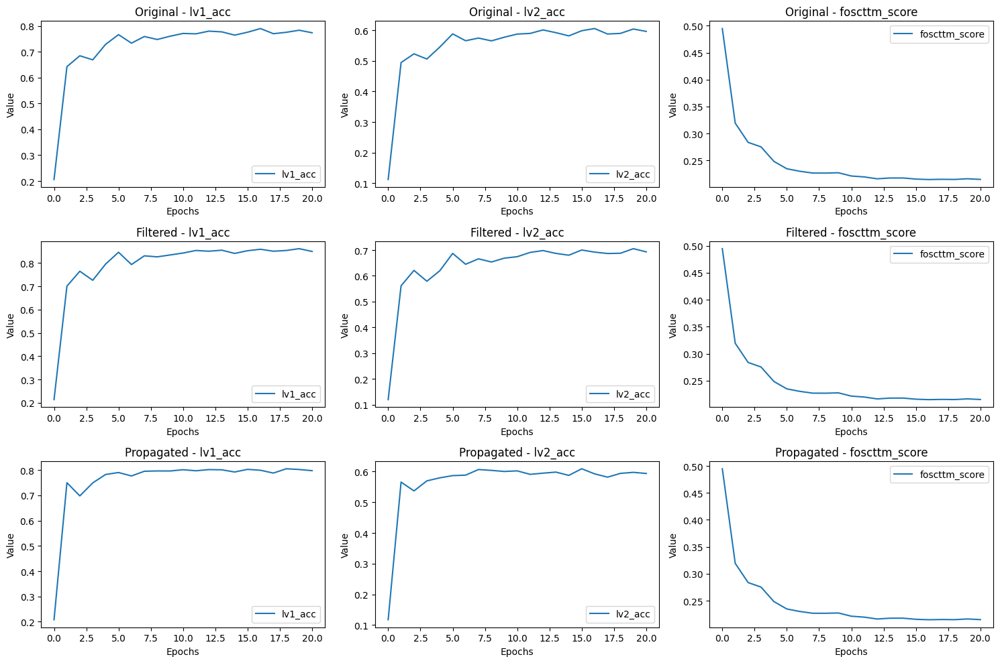

In [21]:
# Create subplots
fig, axs = plt.subplots(3, 3, figsize=(15, 10))

# Plot each metric on a separate subfigure
for i, (category, submetrics) in enumerate(metrics.items()):
    for j, (metric_name, values) in enumerate(submetrics.items()):
        ax = axs[i, j]
        ax.plot(values, label=metric_name)
        ax.set_title(f'{category.capitalize()} - {metric_name}')
        ax.set_xlabel('Epochs')
        ax.set_ylabel('Value')
        ax.legend()

# Adjust layout and show the plot
plt.tight_layout()
plt.show()

In [22]:
# Assuming the metrics dictionary is defined as previously

for key, value in metrics.items():
    max_lv1_acc = max(value['lv1_acc'])
    max_lv2_acc = max(value['lv2_acc'])
    print(f"{key}: Maximum Level 1 Accuracy: {max_lv1_acc}, Maximum Level 2 Accuracy: {max_lv2_acc}")


original: Maximum Level 1 Accuracy: 0.7898, Maximum Level 2 Accuracy: 0.6054
filtered: Maximum Level 1 Accuracy: 0.8618, Maximum Level 2 Accuracy: 0.7054
propagated: Maximum Level 1 Accuracy: 0.8050815885552493, Maximum Level 2 Accuracy: 0.6091662312458013


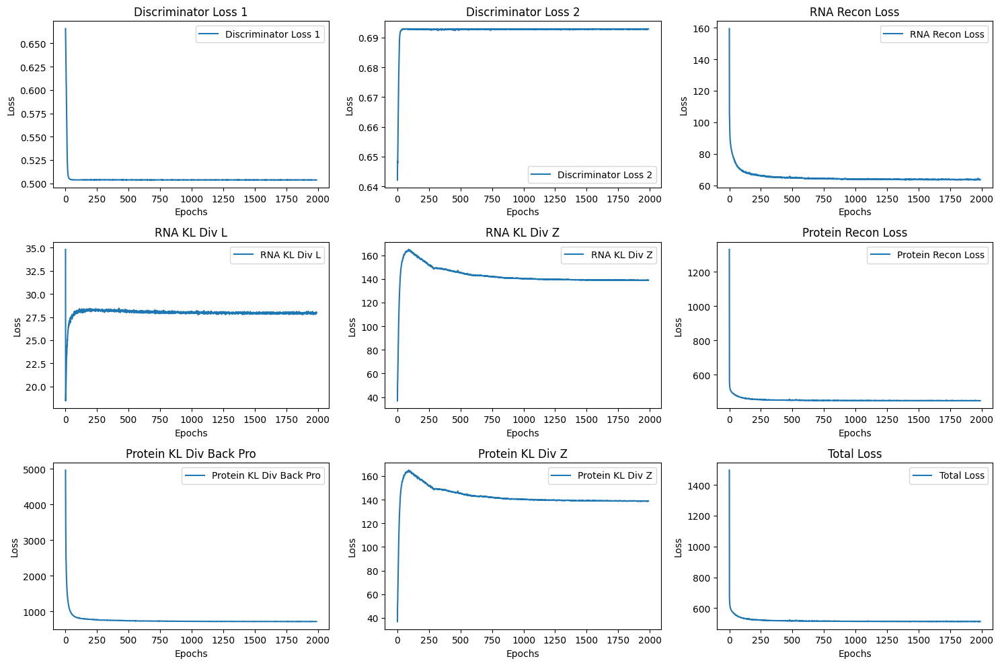

In [23]:
# Plotting all the losses
fig, axs = plt.subplots(3, 3, figsize=(15, 10))  # Adjust the figsize as needed

axs[0, 0].plot(dloss1, label='Discriminator Loss 1')
axs[0, 0].set_title('Discriminator Loss 1')
axs[0, 0].set_xlabel('Epochs')
axs[0, 0].set_ylabel('Loss')
axs[0, 0].legend()

axs[0, 1].plot(dloss2, label='Discriminator Loss 2')
axs[0, 1].set_title('Discriminator Loss 2')
axs[0, 1].set_xlabel('Epochs')
axs[0, 1].set_ylabel('Loss')
axs[0, 1].legend()

axs[0, 2].plot(rna_recon_loss, label='RNA Recon Loss')
axs[0, 2].set_title('RNA Recon Loss')
axs[0, 2].set_xlabel('Epochs')
axs[0, 2].set_ylabel('Loss')
axs[0, 2].legend()

axs[1, 0].plot(rna_kl_div_l, label='RNA KL Div L')
axs[1, 0].set_title('RNA KL Div L')
axs[1, 0].set_xlabel('Epochs')
axs[1, 0].set_ylabel('Loss')
axs[1, 0].legend()

axs[1, 1].plot(rna_kl_div_z, label='RNA KL Div Z')
axs[1, 1].set_title('RNA KL Div Z')
axs[1, 1].set_xlabel('Epochs')
axs[1, 1].set_ylabel('Loss')
axs[1, 1].legend()

axs[1, 2].plot(pro_recon_loss, label='Protein Recon Loss')
axs[1, 2].set_title('Protein Recon Loss')
axs[1, 2].set_xlabel('Epochs')
axs[1, 2].set_ylabel('Loss')
axs[1, 2].legend()

axs[2, 0].plot(pro_kl_div_back_pro, label='Protein KL Div Back Pro')
axs[2, 0].set_title('Protein KL Div Back Pro')
axs[2, 0].set_xlabel('Epochs')
axs[2, 0].set_ylabel('Loss')
axs[2, 0].legend()

axs[2, 1].plot(pro_kl_div_z, label='Protein KL Div Z')
axs[2, 1].set_title('Protein KL Div Z')
axs[2, 1].set_xlabel('Epochs')
axs[2, 1].set_ylabel('Loss')
axs[2, 1].legend()

axs[2, 2].plot(loss_total, label='Total Loss')
axs[2, 2].set_title('Total Loss')
axs[2, 2].set_xlabel('Epochs')
axs[2, 2].set_ylabel('Loss')
axs[2, 2].legend()

plt.tight_layout()
plt.show()